# Aggregate Data from all Scenarios

In [1]:
import sys
import os
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import re
from matplotlib.collections import LineCollection

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


In [2]:
countries = {
    'DE':{
        'bus': 20
    },
    'GB':{
        'bus':14
    },
    'ES':{
        'bus':8
    }}

contingencies = {
    "pv": {
        "reductionto": [0.75, 0.5, 0.25,0],
        "duration": [90, 180, 270]
    },
    "wind": {
        "reductionto": [0.75, 0.5, 0.25,0],
        "duration": [90, 180, 270]
    },
    "noexim": {
        "reductionto": [0.75,0.5, 0.25, 0],
        "duration": [90, 180, 270]
    },
    "drought": {
        "reductionto": [0.75, 0.5, 0.25,0],
        "duration": [90, 180, 270]
    },
    "windpv": {
        "reductionto": [0.75,0.5, 0.25, 0],
        "duration": [7, 14, 21]
    }
}



In [3]:
def sanitize_variable_name(file_name):
    # Replace invalid characters for variable names
    parts = file_name.split('_')
    trans_parts = []

    for part in parts:
        if part == '0.0':
            trans_parts.append('0')
        else:
            san_part = part.replace('.','_')
            trans_parts.append(san_part)

    # Join the transformed parts with underscores
    transformed_filename = '_'.join(trans_parts)
    
    return transformed_filename

mod_names = []
def import_models(directory):
    nc_files = [
        f for f in os.listdir(directory)
        if f.endswith('.csv') 
    ]
    
    for file in nc_files:
        file_path = os.path.join(directory, file)
        base_name = os.path.splitext(file)[0]
        print(base_name)
        sanitized_name = sanitize_variable_name(base_name)
        dataset = pd.read_csv(file_path, index_col=0)
        globals()[sanitized_name] = dataset
        mod_names.append(sanitized_name)
        # Optionally print to verify
        print(f"Loaded {sanitized_name}")

# Set the relative path to the results directory
directory = 'results'  # Folder named 'results' in the current working directory
import_models(directory)



capex_DE_1.0_base_roll_solved
Loaded capex_DE_1_0_base_roll_solved
capex_DE_1.0_base_solved
Loaded capex_DE_1_0_base_solved
capex_DE_1.5_base_roll_solved
Loaded capex_DE_1_5_base_roll_solved
capex_DE_1.5_base_solved
Loaded capex_DE_1_5_base_solved
capex_drought_DE_20_1.0_0.0_180_inv
Loaded capex_drought_DE_20_1_0_0_180_inv
capex_drought_DE_20_1.0_0.0_180_invroll
Loaded capex_drought_DE_20_1_0_0_180_invroll
capex_drought_DE_20_1.0_0.0_180_noinv
Loaded capex_drought_DE_20_1_0_0_180_noinv
capex_drought_DE_20_1.0_0.0_180_noinvroll
Loaded capex_drought_DE_20_1_0_0_180_noinvroll
capex_drought_DE_20_1.0_0.0_270_inv
Loaded capex_drought_DE_20_1_0_0_270_inv
capex_drought_DE_20_1.0_0.0_270_invroll
Loaded capex_drought_DE_20_1_0_0_270_invroll
capex_drought_DE_20_1.0_0.0_270_noinv
Loaded capex_drought_DE_20_1_0_0_270_noinv
capex_drought_DE_20_1.0_0.0_270_noinvroll
Loaded capex_drought_DE_20_1_0_0_270_noinvroll
capex_drought_DE_20_1.0_0.0_90_inv
Loaded capex_drought_DE_20_1_0_0_90_inv
capex_drought

In [4]:
#color setting
color_map = {'AC': '#70af1d',
 'DC': '#8a1caf',
 'oil': '#c9c9c9',
 'CCGT': '#a85522',
 'solar': '#f9d002',
 'geothermal': '#ba91b1',
 'coal': '#545454',
 'offwind-ac': '#6895dd',
 'onwind': '#235ebc',
 'OCGT': '#e0986c',
 'nuclear': '#ff8c00',
 'lignite': '#826837',
 'offwind-dc': '#74c6f2',
 'biomass': '#baa741',
 'hydro': '#298c81',
 'PHS': '#51dbcc',
 'ror': '#3dbfb0',
 '': '',
 'battery': '#ace37f',
 'H2': '#bf13a0',
 'load': '#dd2e23',
 'Import/Export': '#133337'}

# Insalled Capacities

## Installed base capacities all countries

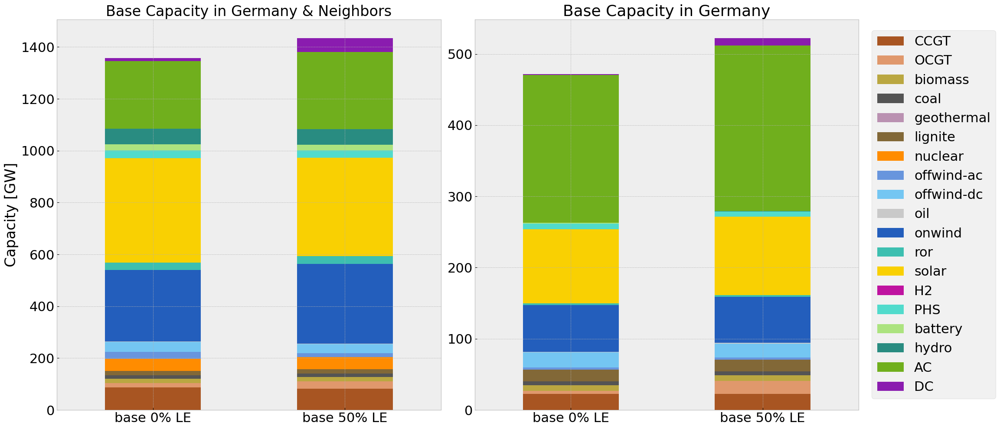

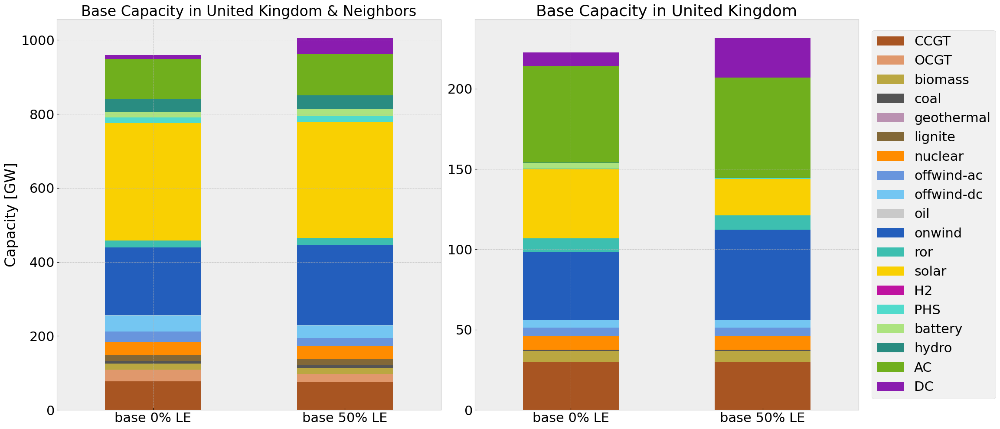

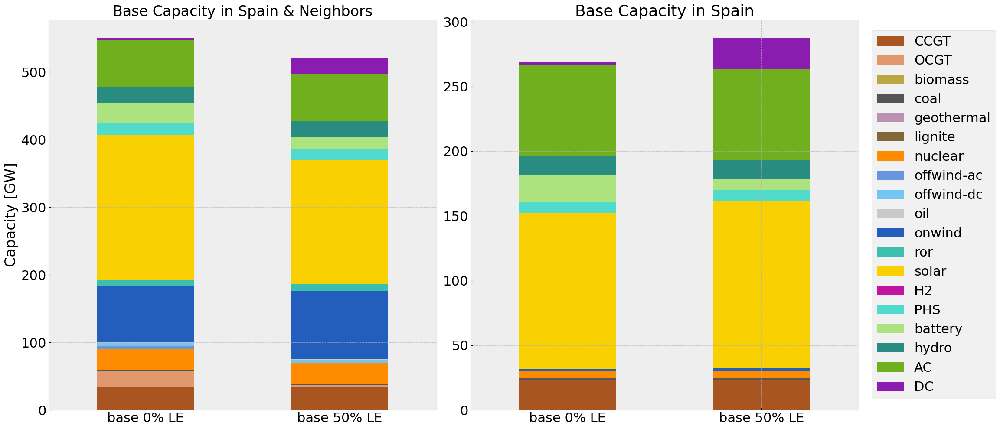

In [5]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
index = 0
for country in countries.keys():
    element_to_ax[country] = index
    index += 1
element_to_ax



maxy = 0

for country,ax in element_to_ax.items():
    
    fig, axes = plt.subplots(nrows = 1, ncols=2, figsize=(20, 10))#,
    ax_count = 0
    ax = axes[0]
    if ax_count == 0:
        ax.set_ylabel('Capacity [GW]', size= 24)

    #create df and insert column base
    cap_1_0 = globals()[f'cap_{country}_1_0_base_roll_solved'].sum(axis =1).rename('base 0% LE')
    cap_1_5 = globals()[f'cap_{country}_1_5_base_roll_solved'].sum(axis =1).rename('base 50% LE')

    if country == 'DE':
        cap_1_0_ctr = globals()[f'cap_{country}_1_0_base_roll_solved'][f'{country}'].rename('base 0% LE')
        cap_1_5_ctr = globals()[f'cap_{country}_1_5_base_roll_solved'][f'{country}'].rename('base 50% LE')
    if country == 'GB':
        cap_1_0_ctr = globals()[f'cap_{country}_1_0_base_roll_solved'][f'{country}'].rename('base 0% LE')
        cap_1_5_ctr = globals()[f'cap_{country}_1_5_base_roll_solved'][f'{country}'].rename('base 50% LE')
    if country == 'ES':
        cap_1_0_ctr = globals()[f'cap_{country}_1_0_base_roll_solved'][f'{country}'].rename('base 0% LE')
        cap_1_5_ctr = globals()[f'cap_{country}_1_5_base_roll_solved'][f'{country}'].rename('base 50% LE')

    globals()[f'cap_base_{country}'] = pd.concat([cap_1_0,cap_1_5], axis = 1).transpose().drop(columns=['load']) #,cap_1_0_ctr,,cap_1_5_ctr

    globals()[f'cap_base_{country}_ctr'] = pd.concat([cap_1_0_ctr,cap_1_5_ctr], axis = 1).transpose().drop(columns=['load']) #,cap_1_0_ctr,,cap_1_5_ctr

    #sum = globals()[f'cap_base_{country}'].sum(axis =1)

    #if sum.max() > maxy:
    #    maxy = sum.max()

    #print(maxy)



    #ax_count = ax
    
    axes = axes.flatten()


    all_handles = []
    all_labels = []
    globals()[f'cap_base_{country}'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
    if country == 'DE':
        ax.set_title('Base Capacity in Germany & Neighbors', fontsize=24)
    if country == 'GB':
        ax.set_title('Base Capacity in United Kingdom & Neighbors', fontsize=24)
    if country == 'ES':
        ax.set_title('Base Capacity in Spain & Neighbors', fontsize=24)

    ax.tick_params(axis='x', rotation=0, labelsize = 22)
    ax.tick_params(axis='y', rotation=0, labelsize = 22)
    
    ax = axes[1]
    globals()[f'cap_base_{country}_ctr'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
    ax.tick_params(axis='x', rotation=0, labelsize = 22)
    ax.tick_params(axis='y', rotation=0, labelsize = 22)
    #ax.set_ylim([0,maxy*1.1])

    handles, labels = ax.get_legend_handles_labels()
    all_handles.extend(handles)
    all_labels.extend(labels)

    if country == 'DE':
        ax.set_title('Base Capacity in Germany', fontsize=26)
    if country == 'GB':
        ax.set_title('Base Capacity in United Kingdom', fontsize=26)
    if country == 'ES':
        ax.set_title('Base Capacity in Spain', fontsize=26)

    

   

    # Create a single legend for the whole figure
    by_label = dict(zip(all_labels, all_handles))
    fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 22})

    #plt.suptitle(f'Installed Capacity of the Base Scenarios', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 1])  # Leave space for the suptitle        


## Share of base capacities in selected countries

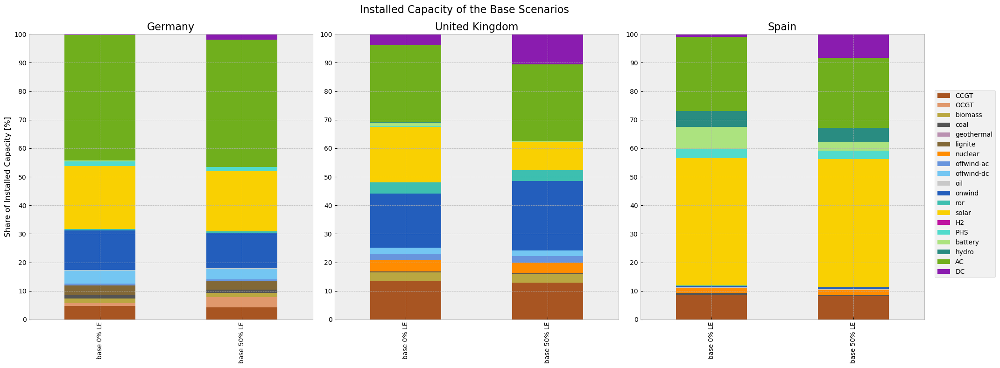

In [6]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
index = 0
for country in countries.keys():
    element_to_ax[country] = index
    index += 1
element_to_ax

fig, axes = plt.subplots(nrows = 1, ncols=len(countries.keys()), figsize=(20, 8))#,

maxy = 0

for country,ax in element_to_ax.items():

    #create df and insert column base
    cap_1_0 = globals()[f'cap_{country}_1_0_base_roll_solved'].drop(index =['load'])[f'{country}'].rename('base 0% LE')
    cap_1_0 = cap_1_0/ cap_1_0.sum()*100
    cap_1_5 = globals()[f'cap_{country}_1_5_base_roll_solved'].drop(index =['load'])[f'{country}'].rename('base 50% LE')
    cap_1_5 = cap_1_5/ cap_1_5.sum()*100

    globals()[f'cap_base_{country}'] = pd.concat([cap_1_0,cap_1_5], axis = 1).transpose()
    globals()[f'cap_base_{country}'] = globals()[f'cap_base_{country}']

    sum = globals()[f'cap_base_{country}'].sum(axis =1)

    if sum.max() > maxy:
        maxy = sum.max()

    #print(maxy)

for country,ax in element_to_ax.items():

    ax_count = ax
    ax = axes[ax]
    
    axes = axes.flatten()

    if ax_count == 0:
        ax.set_ylabel('Share of Installed Capacity [%]')

    all_handles = []
    all_labels = []
    globals()[f'cap_base_{country}'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)

    ax.set_ylim([0,maxy])
    ax.set_yticks([0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100])# 50, 75, 100])

    handles, labels = ax.get_legend_handles_labels()
    all_handles.extend(handles)
    all_labels.extend(labels)

    if country == 'DE':
        ax.set_title('Germany', fontsize=16)
    if country == 'GB':
        ax.set_title('United Kingdom', fontsize=16)
    if country == 'ES':
        ax.set_title('Spain', fontsize=16)

   

# Create a single legend for the whole figure
by_label = dict(zip(all_labels, all_handles))
fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

plt.suptitle(f'Installed Capacity of the Base Scenarios', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])  # Leave space for the suptitle   

## Installed Capacities in all Countries

in this section the installed capacities of generators, storage units, lines and links of the selected countries in the base model and in the inv model of different contingency scenarios are presented.

In [7]:
#sens_reductionto = [round(red_int + red_dev,2) ,red_int, (0 if red_int-red_dev== 0.0 else round(red_int-red_dev,2))]
#sens_duration    = [int(duration-dur_dev ), duration, int(duration + dur_dev)]
lines            = [1.0, 1.5]
models           = ['inv', 'noinv', 'noinvroll', 'invroll']

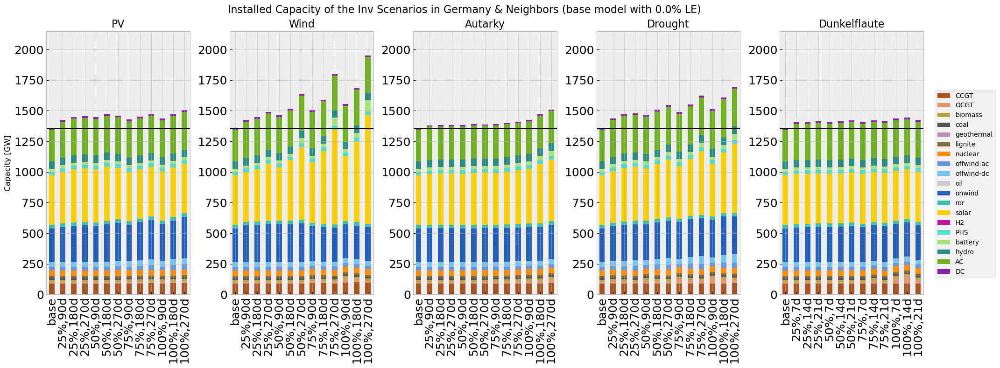

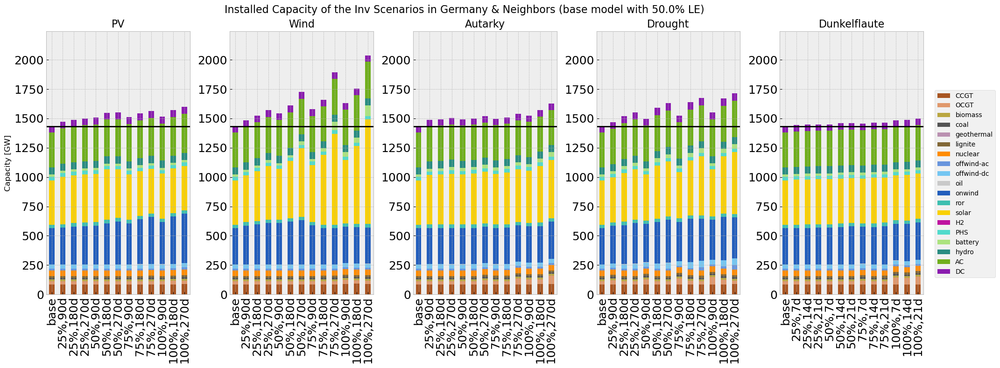

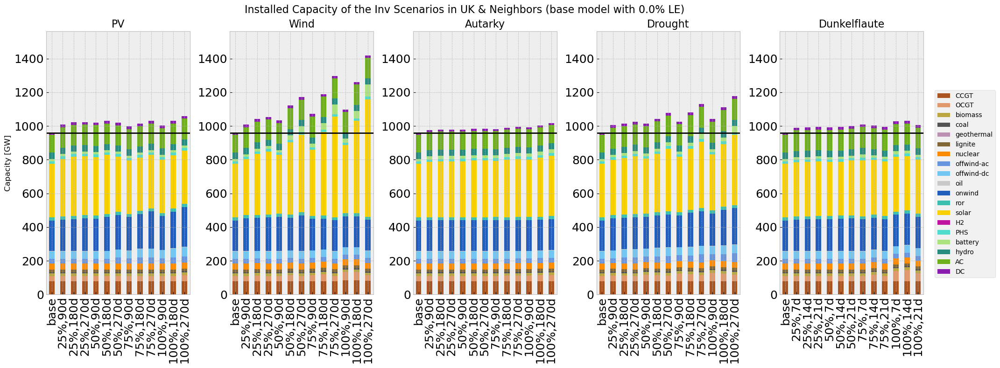

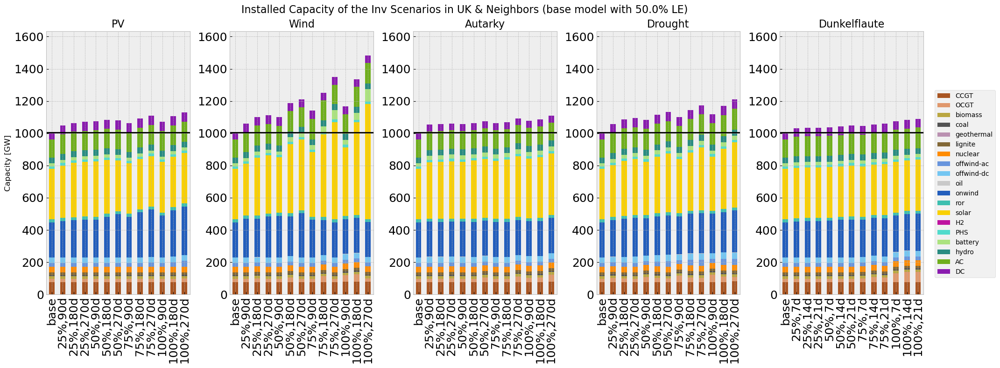

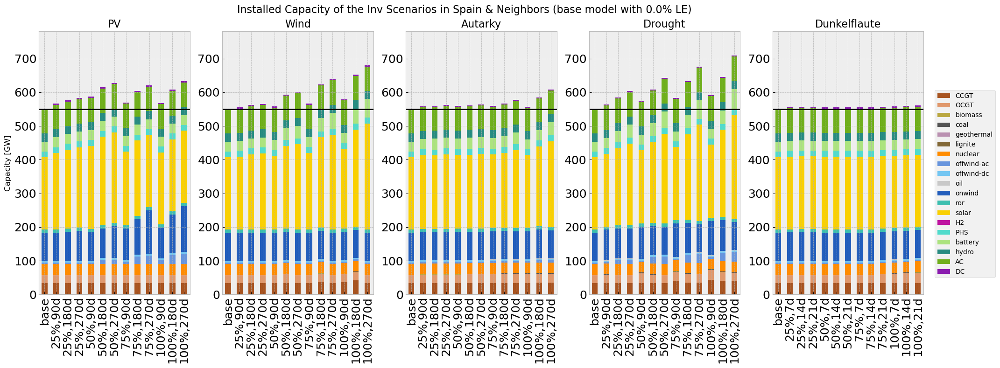

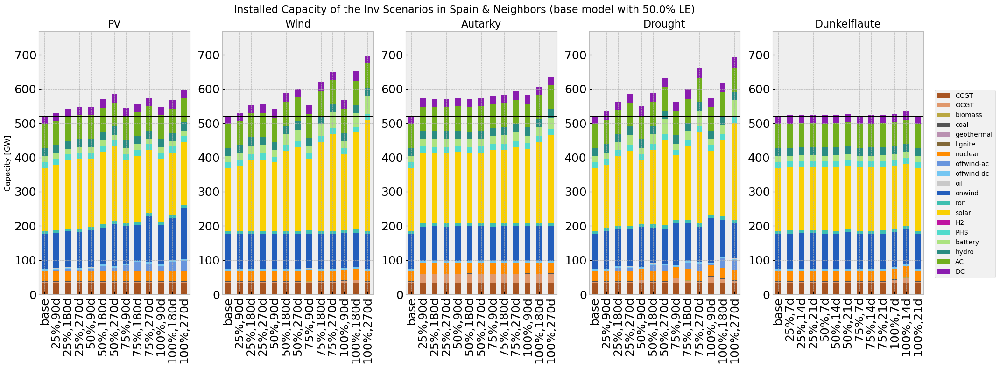

In [8]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy = 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []
        #create df and insert column base
        base_cap = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_base_roll_solved'].sum(axis =1).rename('base')
        #print(base_cap)
        #base_line = base_cap.sum()#.iloc[0]
        #print(base_line)
        #globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_base'] = 
        
        # Add main title for the entire figure
        #fig.suptitle(f'Installed Capacity in {country} (Base Model with {str((line-1)*100)}% LE)', fontsize=16)
        

        for contingency_el,ax in contingencies_el.items():
            

            globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(base_cap)
            #print(globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'])

            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:
                    bus = countries[country]['bus']
                    mod_name = f'cap_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_invroll'
                    mod_cap = globals()[mod_name].sum(axis =1).rename(f'{int(-(reductionto-1)*100)}%,{duration}d')
                    #print(mod_name)
                    mod_df = pd.DataFrame(mod_cap)
                    #print(mod_df)
                    globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.concat([globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'], mod_df], axis =1)

            globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] =globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].transpose().drop(columns=['load'])

            sum = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis = 1)

            if sum.max() > maxy:
                maxy = sum.max()


        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('Capacity [GW]',)
            
            ax.tick_params(axis='x', labelsize=12)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=16)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=16)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=16)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=16)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=16) 

            ax.set_ylim([0,maxy*1.1])

            #plotting
            base_line = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].iloc[0,:].sum()
            #print(globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'])
            globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)

            ax.tick_params(axis='x', rotation=90, labelsize = 18)
            ax.tick_params(axis='y', rotation=0, labelsize = 18)
        
            ax.axhline(y=base_line, color='black', linestyle='-')
            
        # Collect handles and labels
        
            handles, labels = ax.get_legend_handles_labels()
            all_handles.extend(handles)
            all_labels.extend(labels)

   

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
        
        if country == 'DE':
            plt.suptitle(f'Installed Capacity of the Inv Scenarios in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize=16)
        elif country == 'GB':
            plt.suptitle(f'Installed Capacity of the Inv Scenarios in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize=16)
        elif country == 'ES':
            plt.suptitle(f'Installed Capacity of the Inv Scenarios in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize=16)


        # Save plot to the current working directory
        #filename = f"sens_saved_cost_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

## Installed Capacities in Selected Countries

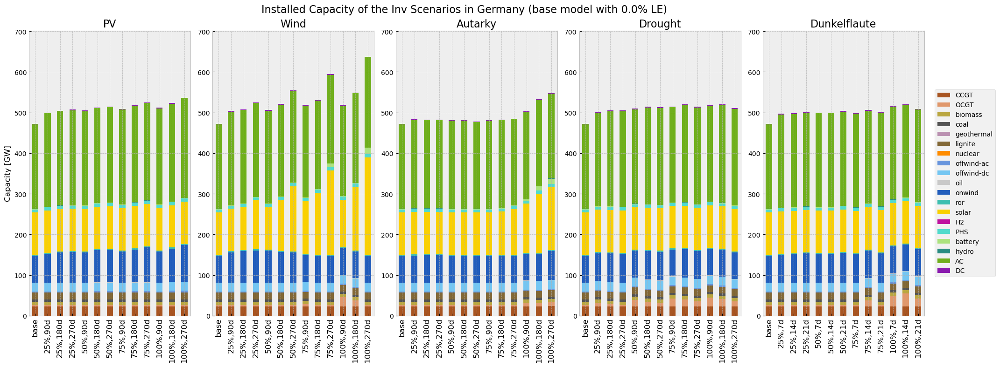

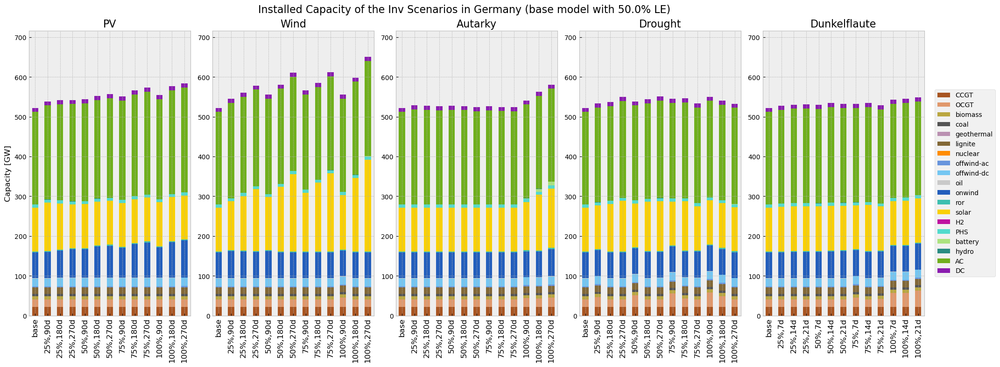

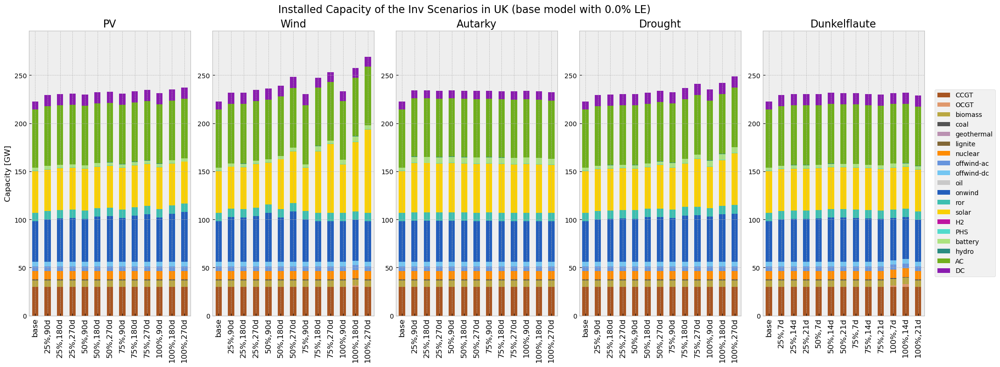

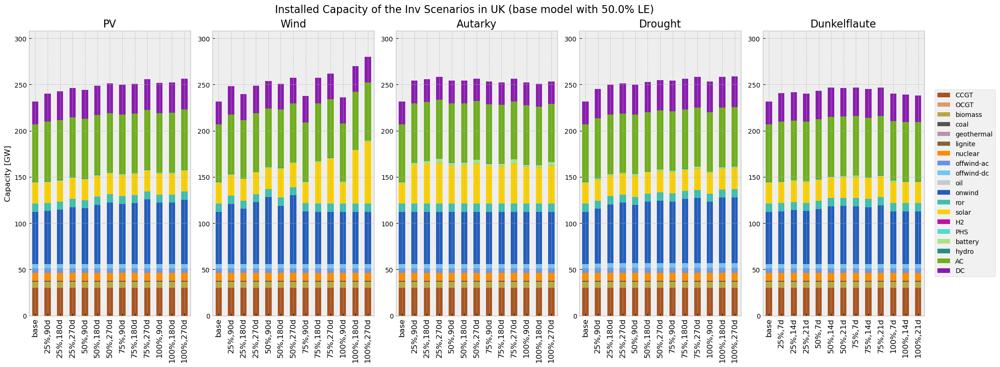

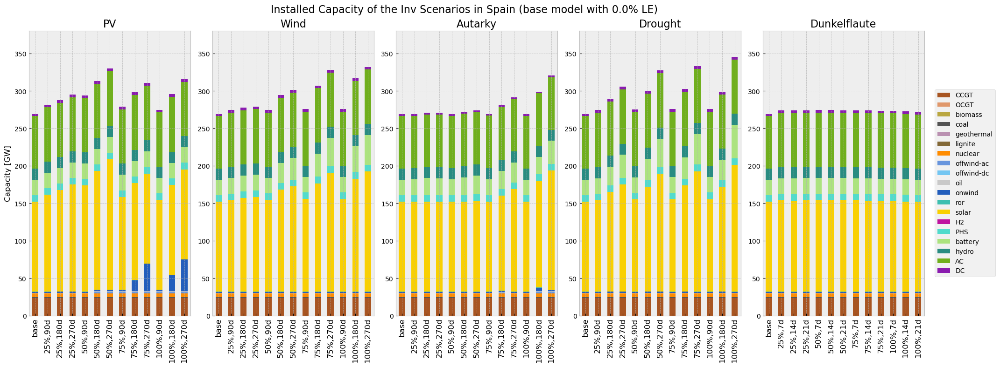

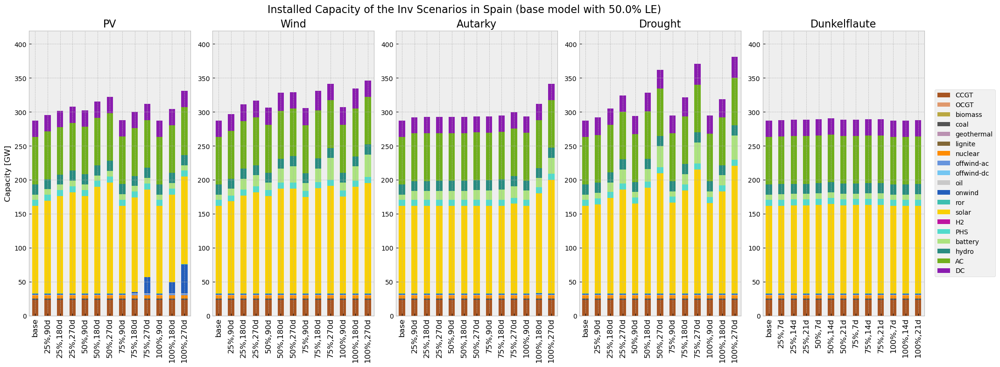

In [9]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy = 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []
        #create df and insert column base
        base_cap = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_base_roll_solved'][f'{country}'].rename('base')
        #print(base_cap)
        #base_line = base_cap.sum()#.iloc[0]
        #print(base_line)
        #globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_base'] = 
        
        # Add main title for the entire figure
        #fig.suptitle(f'Installed Capacity in {country} (Base Model with {str((line-1)*100)}% LE)', fontsize=16)
        

        for contingency_el,ax in contingencies_el.items():
            

            globals()[f'cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(base_cap)
            #print(globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'])

            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:
                    bus = countries[country]['bus']
                    mod_name = f'cap_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_invroll'
                    mod_cap = globals()[mod_name][f'{country}'].rename(f'{int(-(reductionto-1)*100)}%,{duration}d')
                    #print(mod_name)
                    mod_df = pd.DataFrame(mod_cap)
                    #print(mod_df)
                    globals()[f'cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.concat([globals()[f'cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'], mod_df], axis =1)

            globals()[f'cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] =globals()[f'cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].transpose().drop(columns=['load'])

            sum = globals()[f'cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis = 1)

            if sum.max() > maxy:
                maxy = sum.max()


        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('Capacity [GW]')
            
            ax.tick_params(axis='x', labelsize=12)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=16)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=16)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=16)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=16)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=16) 

            ax.set_ylim([0,maxy*1.1])

            #plotting
            base_line = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].iloc[0,:].sum()
            #print(globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'])
            globals()[f'cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
        
            ax.axhline(y=base_line, color='black', linestyle='-')
            
        # Collect handles and labels
        
            handles, labels = ax.get_legend_handles_labels()
            all_handles.extend(handles)
            all_labels.extend(labels)

   

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
        
        if country == 'DE':
            plt.suptitle(f'Installed Capacity of the Inv Scenarios in Germany (base model with {str((line-1)*100)}% LE)', fontsize=16)
        elif country == 'GB':
            plt.suptitle(f'Installed Capacity of the Inv Scenarios in UK (base model with {str((line-1)*100)}% LE)', fontsize=16)
        elif country == 'ES':
            plt.suptitle(f'Installed Capacity of the Inv Scenarios in Spain (base model with {str((line-1)*100)}% LE)', fontsize=16)


        # Save plot to the current working directory
        #filename = f"sens_saved_cost_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

## Additional Investment Bar Chart (all countries)

In the following Bar chart, the additional installed capacities in all countries during the different contingency scenarios are presented.

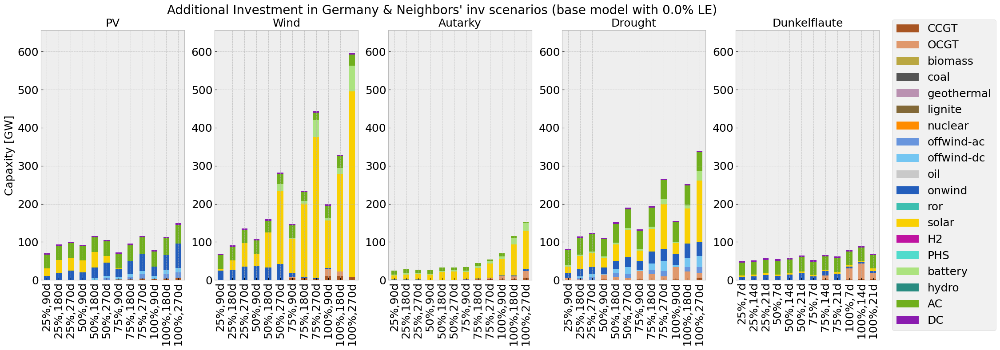

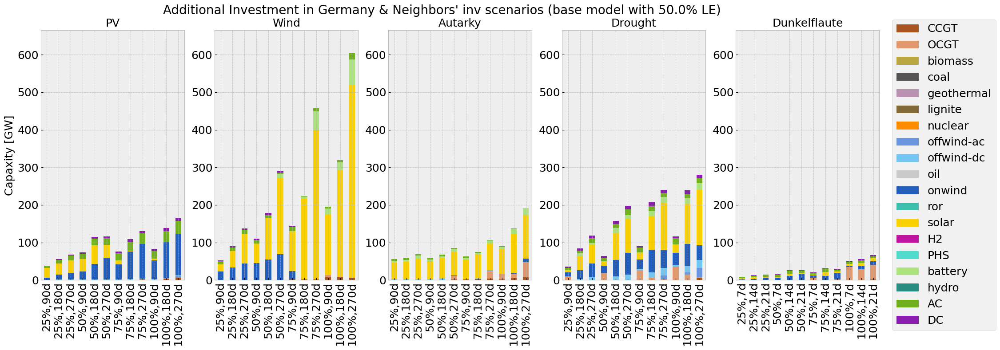

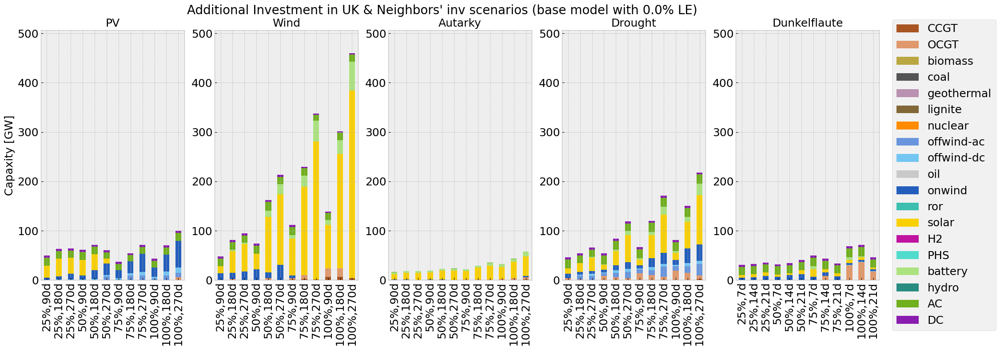

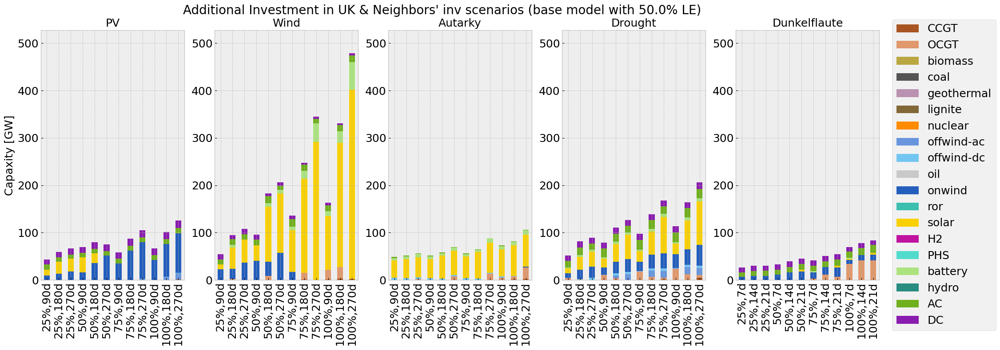

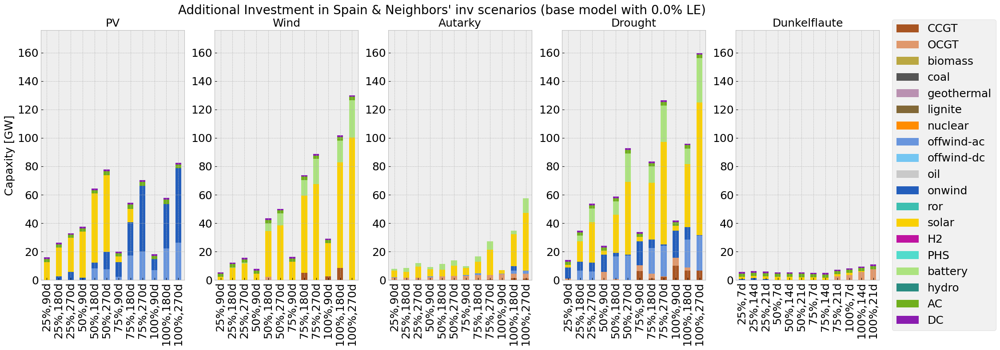

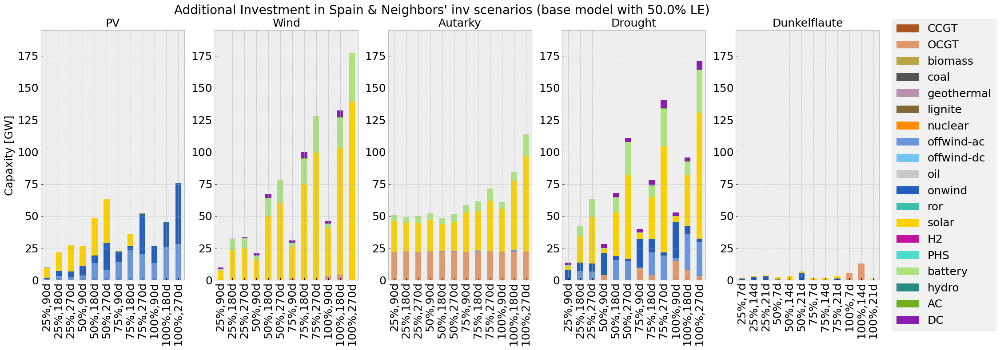

In [10]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy = 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))
        #print(country)

        all_handles = []
        all_labels = []
        
        #create df and insert column base
        #base_capex = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_base_solved']
        
        #globals()[f'add_cap_{country}_{sanitize_variable_name(str(line))}'] = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].sum(axis=1)

        for contingency_el,ax in contingencies_el.items():

            globals()[f'add_cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns, 
                                                                                                                  index = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].index)
            

            for reductionto in contingencies[contingency_el]['reductionto']:

                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    index = f'{int(-(reductionto-1)*100)}%,{duration}d'
                    #index_inv = f'inv {int(-(reductionto-1)*100)}%,{duration}d'
                    #index_noinv = f'noinv {int(-(reductionto-1)*100)}%,{duration}d'

                    globals()[f'add_cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[index] = (globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[index]-globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base'])

            globals()[f'add_cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add cap'] = globals()[f'add_cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].sum(axis = 1)

            if globals()[f'add_cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add cap'].max() > maxy:
                maxy = globals()[f'add_cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add cap'].max()

        for contingency_el,ax in contingencies_el.items():
            #add ylabel
            ax_count = ax
            ax = axes[ax]
            if ax_count == 0:
                ax.set_ylabel('Capaxity [GW]',size = 18)
            
            ax.set_title(f'{contingency_el}', fontsize = 20)
            
            globals()[f'add_cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].iloc[1:,:-1].plot(kind='bar', stacked=True, ax =ax, legend =False, color = color_map)
            #net_saved_cost = globals()[f'net_saved_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].iloc[1:,-1].plot(kind='line', ax =ax,color = 'k', marker = 'o')

            # Rotate xticks for better readability
            #ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha='right')
            
            ax.set_ylim([0,maxy*1.1])

            #set font size
            ax.tick_params(axis='x', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=18)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=18)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=18)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=18)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=18)

            ax.tick_params(axis='x', rotation=90, labelsize = 18)
            ax.tick_params(axis='y', rotation=0, labelsize = 18)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 18})

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        if country == 'DE':
            plt.suptitle(f'Additional Investment in Germany & Neighbors\' inv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Additional Investment in UK & Neighbors\' inv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Additional Investment in Spain & Neighbors\' inv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"add_cap_{}_{country}_all.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

In [11]:
#extendables = ['AC','solar','DC','OCGT','onwind','offwind-dc','offwind-ac','H2','battery']

#for country in countries.keys():

    #for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        #fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 6))
        #print(country)
        #all_handles = []
        #all_labels = []
        #maxy = 0

        #for contingency_el,ax in contingencies_el.items():

            #extendables_adj = []

            #for i in extendables:
                #if i in globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:
                    #extendables_adj.append(i)

            #globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_inv_df'] = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'][extendables_adj].copy()

            #for index, row in globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_inv_df'].iterrows():
                #print(index)
                #globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_inv_df'].loc[index, extendables_adj] = (globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_inv_df'].#loc[index, extendables_adj] - globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', extendables_adj])
        
            #sum = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_inv_df'].sum(axis = 1)

            #if sum.max() > maxy:
                #maxy = sum.max()

        #for contingency_el,ax in contingencies_el.items():

            #ax_count = ax
            #ax = axes[ax]

            #if contingency_el == 'pv':
                #ax.set_title('PV', fontsize=16)
            #elif contingency_el == 'wind':
                #ax.set_title('Wind', fontsize=16)
            #elif contingency_el == 'drought':
                #ax.set_title('Drought', fontsize=16)
            #elif contingency_el == 'noexim':
                #ax.set_title('Autarky', fontsize=16)
            #elif contingency_el == 'windpv':
                #ax.set_title('Dunkelflaute', fontsize=16)

            #if ax_count == 0:
                #ax.set_ylabel('Capacity [GW]')  

            #plotting
            #globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_inv_df'] = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_inv_df'].drop('base')
            #globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_inv_df'].plot(kind='bar', stacked=True, ax =ax, color=color_map, legend = False)
            #ax.tick_params(axis='x', labelsize=12)
            
            #ax.set_ylim([0,maxy*1.1])#round(globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_inv_df'].sum(axis = 1).max()*1.1,1)
            

        # Collect handles and labels
        #handles, labels = ax.get_legend_handles_labels()
        #all_handles.extend(handles)
        #all_labels.extend(labels)
        

        #plt.subplots_adjust(top=0.9)  # Adjust to make room for the title

        #if country == 'DE':
            #plt.suptitle(f'Additional Investment in Germany (base model with {str((line-1)*100)}% LE)', fontsize = 16)
        #elif country == 'GB':
            #plt.suptitle(f'Additional Investment in UK (base model with {str((line-1)*100)}% LE)', fontsize = 16)
        #elif country == 'ES':
            #plt.suptitle(f'Additional Investment in Spain (base model with {str((line-1)*100)}% LE)', fontsize = 16)
            
    
        # Create a single legend for the whole figure
        #by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1.0, 0.5))

        #plt.tight_layout()  # Adjust layout to make room for labels
      

        #plt.show()

## Additional Capacities in selected countries

In the following Bar chart, the additional installed capacities in the selected countries during the different contingency scenarios are presented.

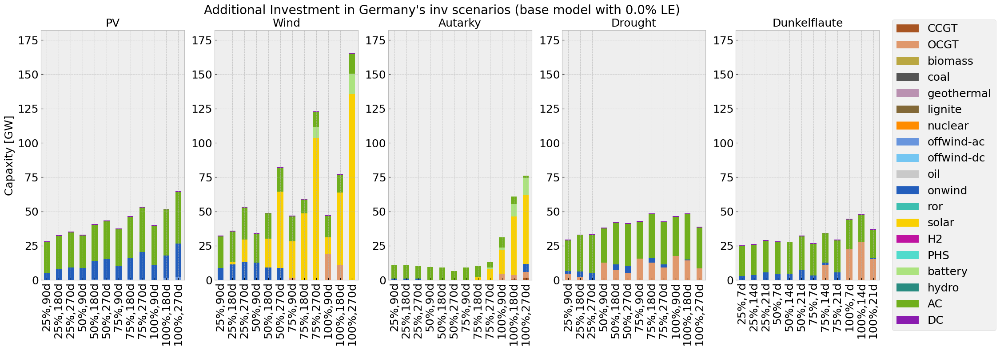

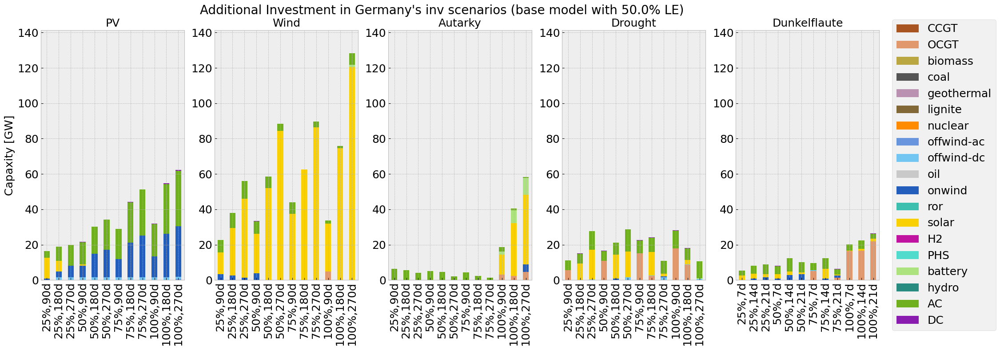

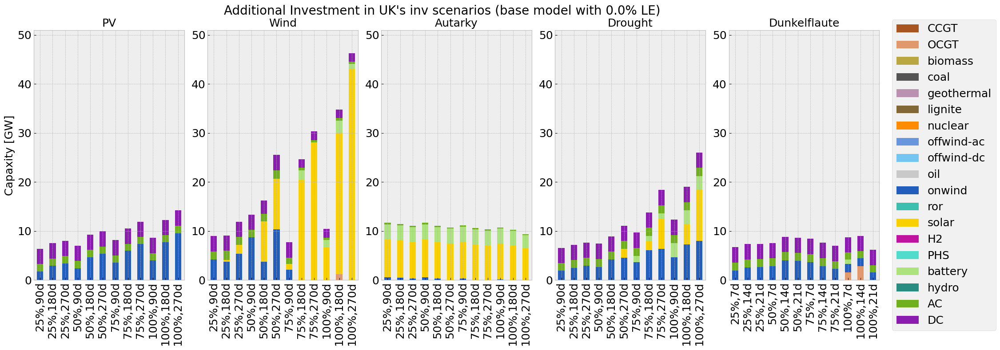

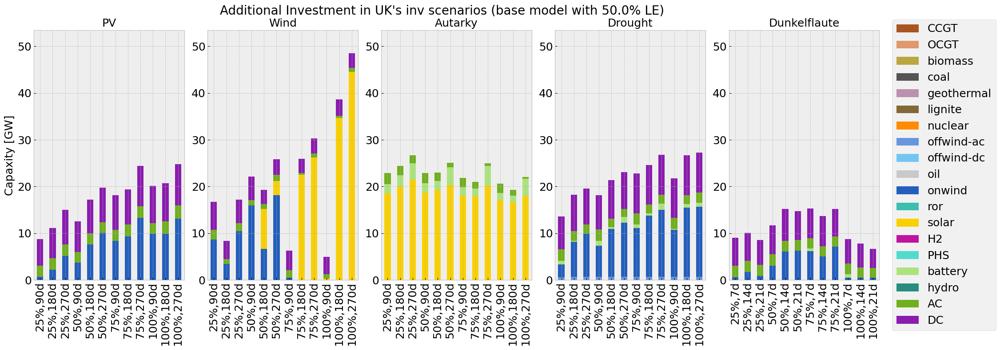

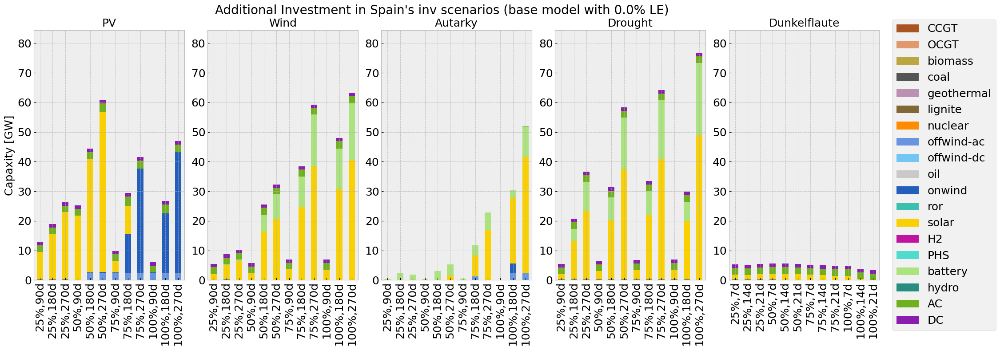

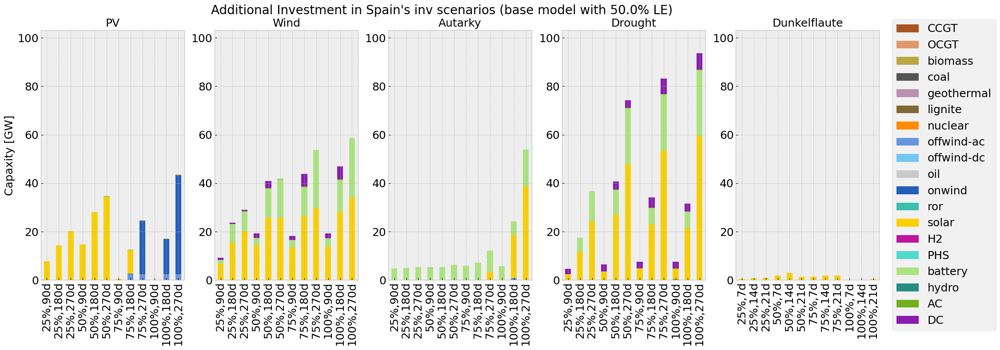

In [12]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy = 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))
        #print(country)

        all_handles = []
        all_labels = []
        
        #create df and insert column base
        #base_capex = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_base_solved']
        
        #globals()[f'add_cap_{country}_{sanitize_variable_name(str(line))}'] = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].sum(axis=1)

        for contingency_el,ax in contingencies_el.items():

            globals()[f'add_cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = globals()[f'cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns, 
                                                                                                                  index = globals()[f'cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].index)
            

            for reductionto in contingencies[contingency_el]['reductionto']:

                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    index = f'{int(-(reductionto-1)*100)}%,{duration}d'
                    #index_inv = f'inv {int(-(reductionto-1)*100)}%,{duration}d'
                    #index_noinv = f'noinv {int(-(reductionto-1)*100)}%,{duration}d'

                    globals()[f'add_cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[index] = (globals()[f'cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[index]-globals()[f'cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base'])

            globals()[f'add_cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add cap'] = globals()[f'add_cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].sum(axis = 1)

            if globals()[f'add_cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add cap'].max() > maxy:
                maxy = globals()[f'add_cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add cap'].max()

        for contingency_el,ax in contingencies_el.items():
            #add ylabel
            ax_count = ax
            ax = axes[ax]
            if ax_count == 0:
                ax.set_ylabel('Capaxity [GW]',size =18)
            
            ax.set_title(f'{contingency_el}', fontsize = 20)
            
            globals()[f'add_cap_ctr_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].iloc[1:,:-1].plot(kind='bar', stacked=True, ax =ax, legend =False, color = color_map)
            #net_saved_cost = globals()[f'net_saved_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].iloc[1:,-1].plot(kind='line', ax =ax,color = 'k', marker = 'o')

            # Rotate xticks for better readability
            #ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha='right')

            
            ax.set_ylim([0,maxy*1.1])

            #set font size
            #ax.tick_params(axis='x', rotation = 90, labelsize=12)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=18)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=18)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=18)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=18)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=18)

            ax.tick_params(axis='x', rotation=90, labelsize = 18)
            ax.tick_params(axis='y', rotation=0, labelsize = 18)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 18})

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        if country == 'DE':
            plt.suptitle(f'Additional Investment in Germany\'s inv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Additional Investment in UK\'s inv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Additional Investment in Spain\'s inv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)

        #plt.set_title('')
         #Save plot to the current working directory
        filename = f"add_cap_{sanitize_variable_name(str(line))}_{country}.png"
        output_path = os.path.join(os.getcwd(), filename)
        plt.savefig(output_path)

        plt.show()

In [13]:
def create_radar_chart(ax, df, title):
    categories = list(df.columns)
    num_vars = len(categories)

    # Compute angle of each axis
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    angles += angles[:1]  # complete the loop

    # Iterate over each row in the DataFrame
    for row_name in df.index:
        values = df.loc[row_name].values.flatten().tolist()
        values += values[:1]  # complete the loop
        
        if 'pv' in row_name and not 'windpv' in row_name:
            # Plot each row on the radar chart
            ax.plot(angles, values, linewidth=0.5, linestyle='solid', label=row_name, color = 'y')
        elif 'wind' in row_name and not 'windpv' in row_name:
            ax.plot(angles, values, linewidth=0.5, linestyle='solid', label=row_name, color = 'b')
        elif 'windpv' in row_name:
            ax.plot(angles, values, linewidth=0.5, linestyle='solid', label=row_name, color = 'r')
        elif 'noexim' in row_name:
            ax.plot(angles, values, linewidth=0.5, linestyle='solid', label=row_name, color = 'g')
        elif 'dispatchcut' in row_name:
            ax.plot(angles, values, linewidth=0.5, linestyle='solid', label=row_name, color = 'm')
        elif 'base' in row_name:
            ax.plot(angles, values, linewidth=1.5, linestyle='-', label=row_name, color = 'k')
        elif 'drought' in row_name:
            ax.plot(angles, values, linewidth=0.5, linestyle='solid', label=row_name, color = 'c')

        #ax.fill(angles, values, alpha=0.1)

    #values = [0.5,0.5,0.5,0.5,0.5, 0.5,0.5,0.5,0.5,0.5]
    #ax.plot(angles, values, linewidth=1.5, linestyle='solid', label=row_name)
    # Add labels and title
    ax.set_yticks(np.linspace(0, df.max().max(), num=5))
    ax.set_yticklabels([f"{float(x)}" for x in np.linspace(0, df.max().max(), num=5)])
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(categories, fontsize=12)


    # Set the title of the subplot
    ax.set_title(title)

In [14]:
#gen_DE_1_0_base_roll_solved.drop(columns=['country']).columns[1]-gen_DE_1_0_base_roll_solved.drop(columns=['country']).columns[0]

# Generation

In this section the composition and the amount of the energy generation for each of the selected country are presented.

In [15]:
# calculate timestep of df
date0 = pd.to_datetime(gen_DE_1_0_base_roll_solved.drop(columns=['country']).columns[0])
date1 = pd.to_datetime(gen_DE_1_0_base_roll_solved.drop(columns=['country']).columns[1])

timestep = (date1-date0).total_seconds()/3600

#base in TWh
gen = (gen_DE_1_0_base_roll_solved[gen_DE_1_0_base_roll_solved['country'] == 'DE'].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3
gen.rename(index={0: 'DE'}, inplace=True)

## Generation of the noinv scenarios of the main countries (perfect foresight)

In [16]:
file_path = os.path.join('resources', 'DE_20_1.5_base.nc')
n_DE = pypsa.Network(file_path)
file_path = os.path.join('resources', 'GB_14_1.5_base.nc')
n_GB = pypsa.Network(file_path)
file_path = os.path.join('resources', 'ES_8_1.5_base.nc')
n_ES = pypsa.Network(file_path)


#loads
de_loads = n_DE.loads_t.p.filter(like ='DE',axis =1).sum().sum()*timestep/1e6 #TWh
de_loads_all = n_DE.loads_t.p.sum().sum()*timestep/1e6 #TWh
gb_loads = n_GB.loads_t.p.filter(like ='GB',axis =1).sum().sum()*timestep/1e6 #TWh
gb_loads_all = n_GB.loads_t.p.sum().sum()*timestep/1e6 #TWh
es_loads = n_ES.loads_t.p.filter(like ='ES',axis =1).sum().sum()*timestep/1e6 #TWh
es_loads_all = n_ES.loads_t.p.sum().sum()*timestep/1e6 #TWh

INFO:pypsa.io:Imported network DE_20_1.5_base.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network GB_14_1.5_base.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network ES_8_1.5_base.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


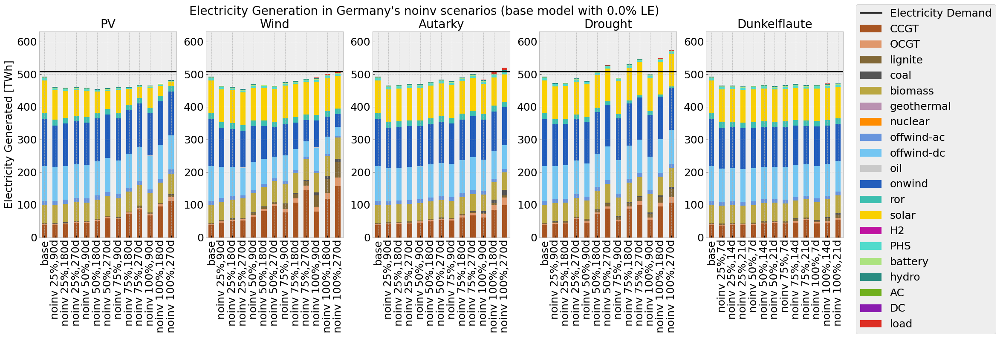

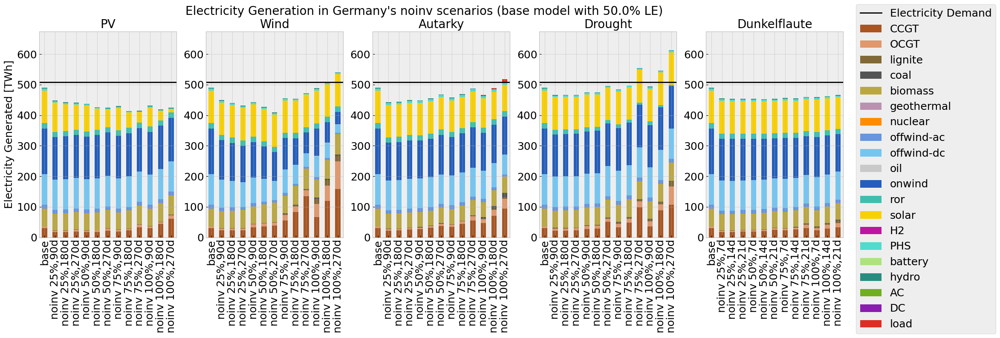

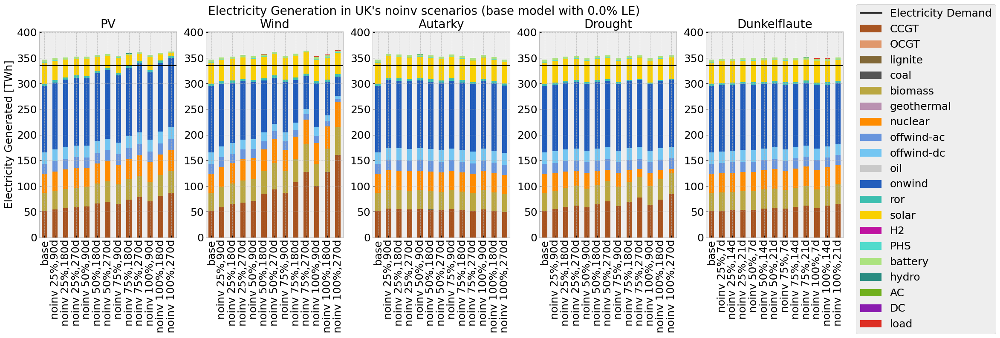

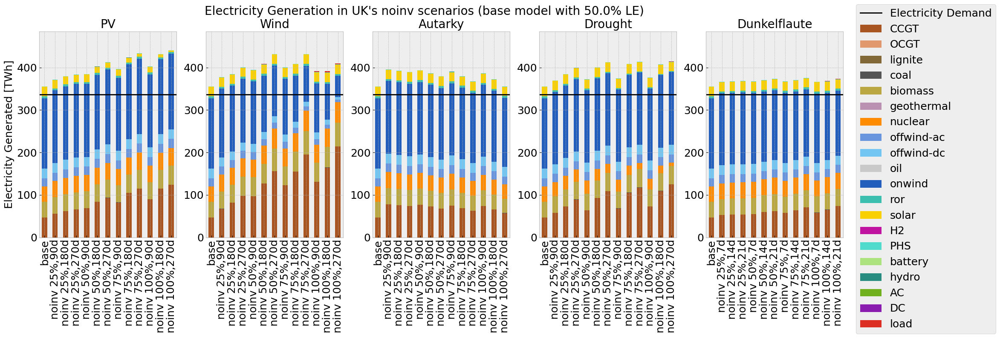

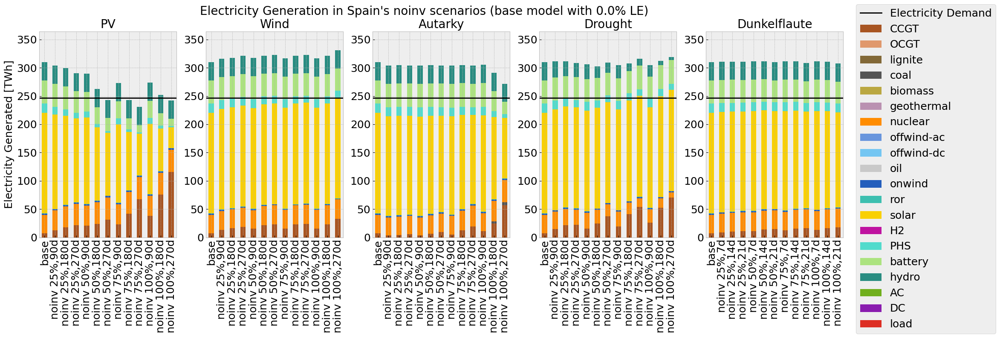

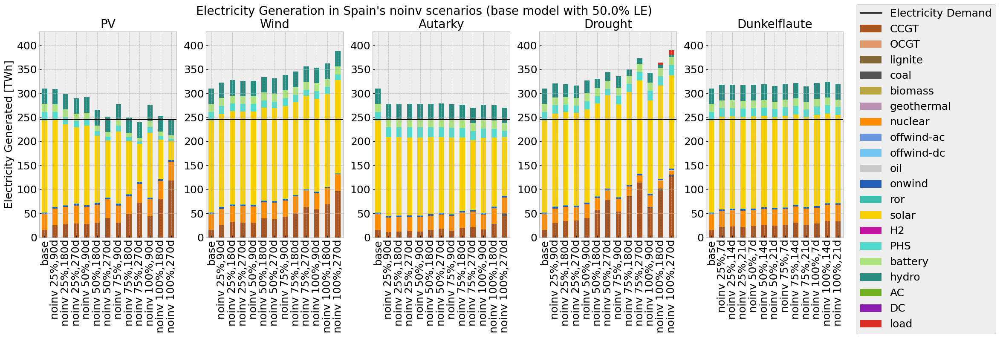

In [17]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        
        new_order = ['CCGT', 'OCGT', 'lignite','coal', 'biomass','geothermal', 'nuclear', 'offwind-ac', 'offwind-dc', 'oil', 'onwind', 'ror', 'solar', 'H2', 'PHS', 'battery', 'hydro', 'AC', 'DC', 'load']

        #gen base in TWh
        gen = (globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'][globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved']['country'] == country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= new_order)
            for col in globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['noinv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'
                        mod_gen = (globals()[mod_name][globals()[mod_name]['country']==country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3 #TWh
                        mod_gen.rename(index = {0: f'{mod} {int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #find the max y 
            sum =globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis =1) 

            if sum.max()> maxy:
                maxy=sum.max()
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('Electricity Generated [TWh]', size = 18)

            
            globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            #ax.tick_params(axis='x', labelsize=12)

            ax.tick_params(axis='x', labelsize=18)
            ax.tick_params(axis='y', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            if country == 'DE':
                ax.axhline(y=de_loads, color='black', linestyle='-', label='Electricity Demand')
            if country == 'GB':
                ax.axhline(y=gb_loads, color='black', linestyle='-', label='Electricity Demand')
            if country == 'ES':
                ax.axhline(y=es_loads, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 18})

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'Electricity Generation in Germany\'s noinv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Electricity Generation in UK\'s noinv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Electricity Generation in Spain\'s noinv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 18})

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"gen_base_{line}_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()
    

## Generation of the noinv scenarios of the main countries (rolling horizon foresight)

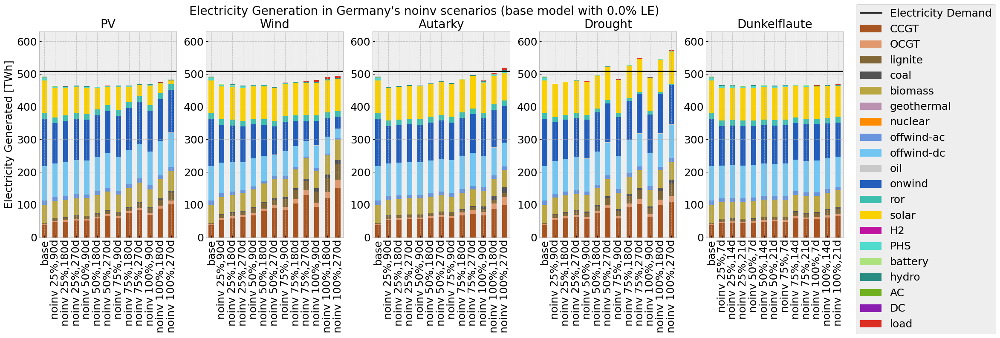

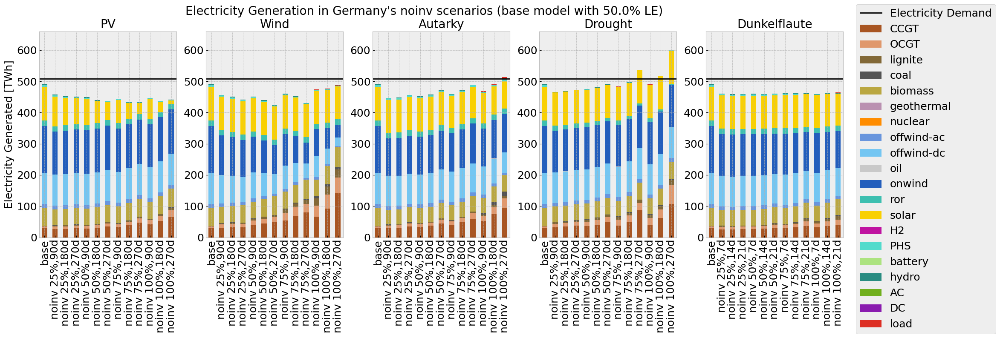

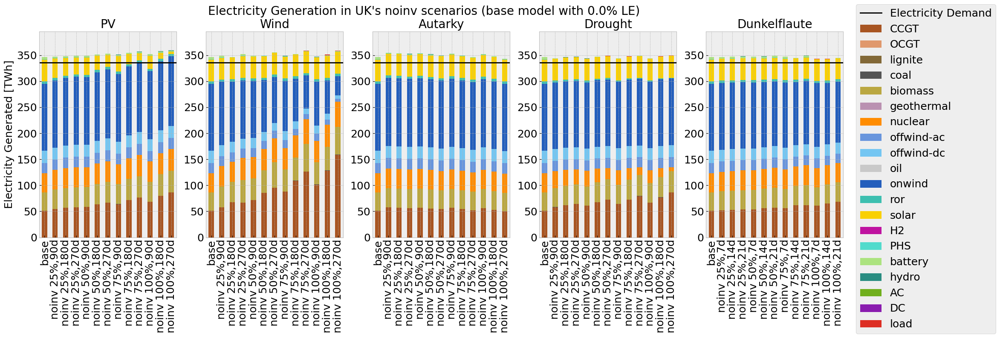

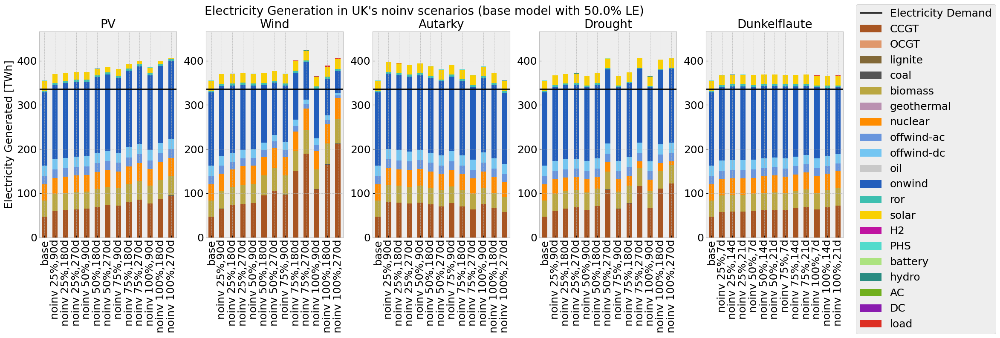

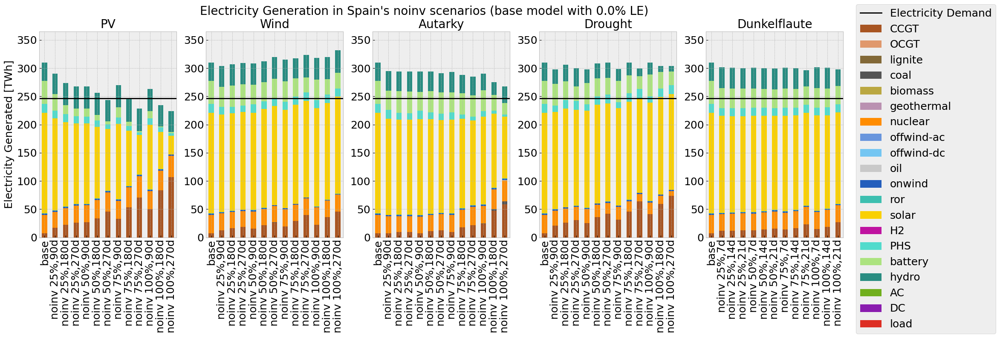

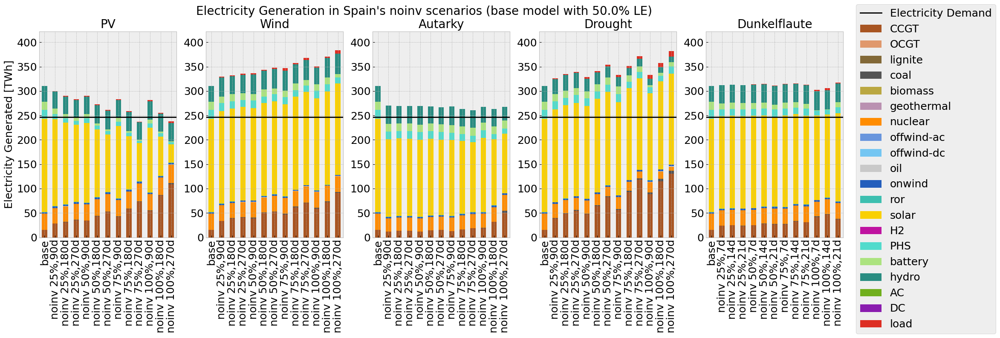

In [18]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        
        new_order = ['CCGT', 'OCGT', 'lignite','coal', 'biomass','geothermal', 'nuclear', 'offwind-ac', 'offwind-dc', 'oil', 'onwind', 'ror', 'solar', 'H2', 'PHS', 'battery', 'hydro', 'AC', 'DC', 'load']

        #gen base in TWh
        gen = (globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'][globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved']['country'] == country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= new_order)
            for col in globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['noinv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}roll'
                        mod_gen = (globals()[mod_name][globals()[mod_name]['country']==country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3 #TWh
                        mod_gen.rename(index = {0: f'{mod} {int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #find the max y 
            sum =globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis =1) 

            if sum.max()> maxy:
                maxy=sum.max()
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('Electricity Generated [TWh]', size = 18)

            
            globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            #ax.tick_params(axis='x', labelsize=12)

            ax.tick_params(axis='x', labelsize=18)
            ax.tick_params(axis='y', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            if country == 'DE':
                ax.axhline(y=de_loads, color='black', linestyle='-', label='Electricity Demand')
            if country == 'GB':
                ax.axhline(y=gb_loads, color='black', linestyle='-', label='Electricity Demand')
            if country == 'ES':
                ax.axhline(y=es_loads, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 18})

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'Electricity Generation in Germany\'s noinv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Electricity Generation in UK\'s noinv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Electricity Generation in Spain\'s noinv scenarios (base model with {str((line-1)*100)}% LE)', fontsize = 20)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 18})

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"gen_base_{line}_{country}_roll.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

## Generation of the inv scenarios of the main countries (perfect foresight)

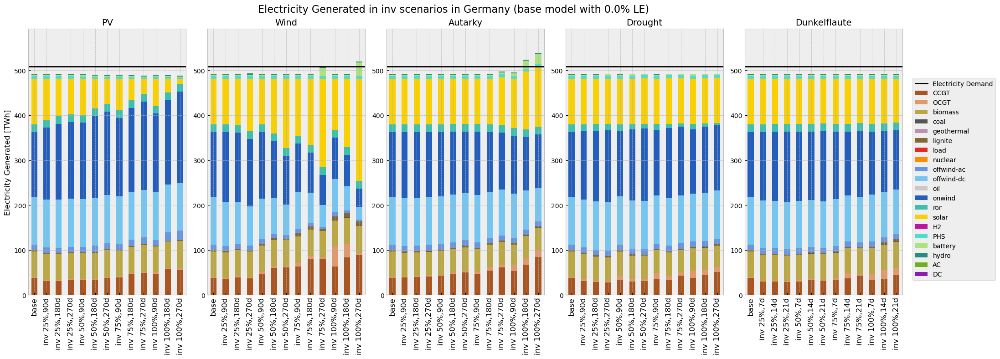

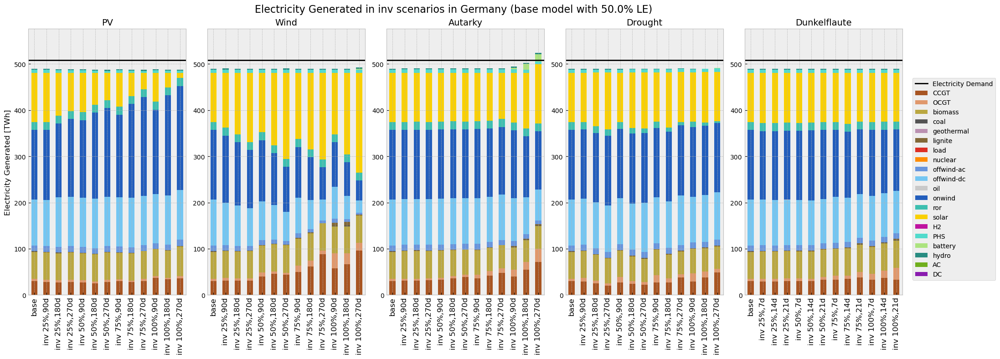

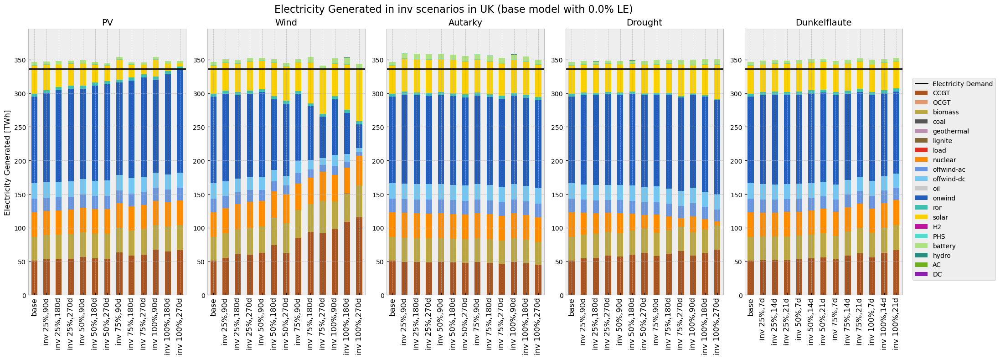

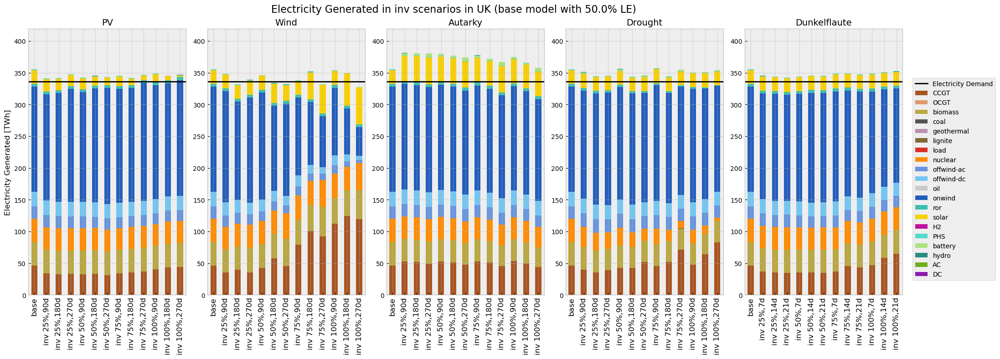

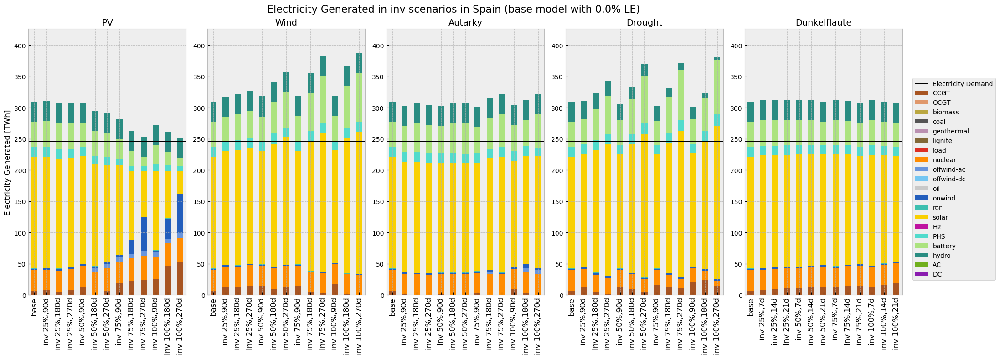

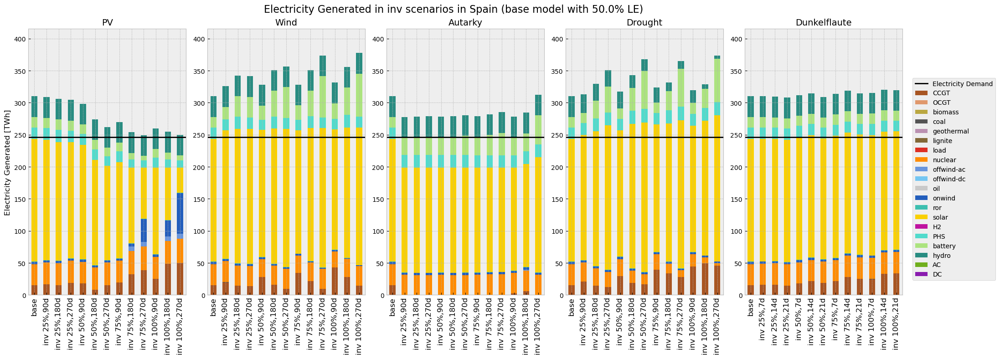

In [19]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        

        #gen base in TWh
        gen = (globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'][globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved']['country'] == country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= base_cap.index)
            for col in globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['inv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'
                        mod_gen = (globals()[mod_name][globals()[mod_name]['country']==country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3 #TWh

                        #if country == 'DE':
                        #    mod_gen = (globals()[mod_name][globals()[mod_name]['country']=='NL'].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3 #TWh

                        mod_gen.rename(index = {0: f'{mod} {int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #find the max y 
            sum =globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis =1) 

            if sum.max()> maxy:
                maxy=sum.max()
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('Electricity Generated [TWh]')

            
            globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            ax.tick_params(axis='x', labelsize=12)

            ax.tick_params(axis='x', labelsize=12)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=14)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=14)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=14)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=14)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=14)
            
            if country == 'DE':
                ax.axhline(y=de_loads, color='black', linestyle='-', label='Electricity Demand')
            if country == 'GB':
                ax.axhline(y=gb_loads, color='black', linestyle='-', label='Electricity Demand')
            if country == 'ES':
                ax.axhline(y=es_loads, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'Electricity Generated in inv scenarios in Germany (base model with {str((line-1)*100)}% LE)', fontsize = 16)
        elif country == 'GB':
            plt.suptitle(f'Electricity Generated in inv scenarios in UK (base model with {str((line-1)*100)}% LE)', fontsize = 16)
        elif country == 'ES':
            plt.suptitle(f'Electricity Generated in inv scenarios in Spain (base model with {str((line-1)*100)}% LE)', fontsize = 16)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"sens_saved_cost_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()
    

## Generation all countries inv (perfect foresight)

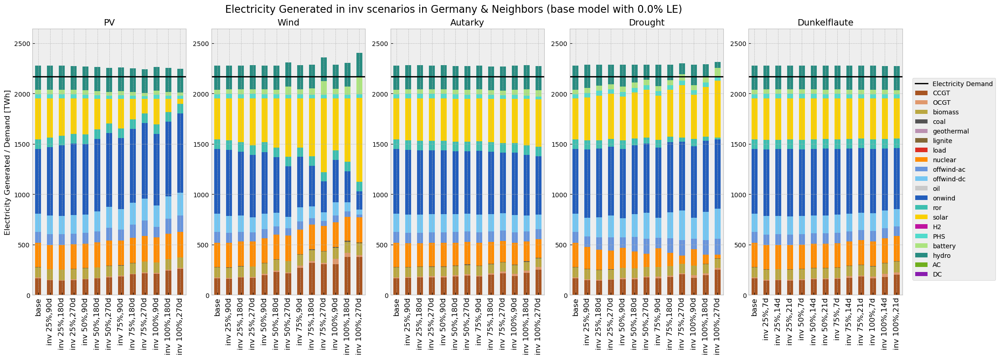

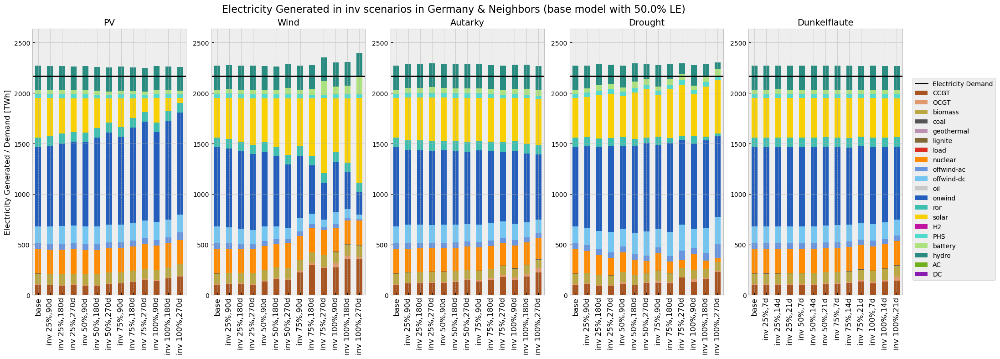

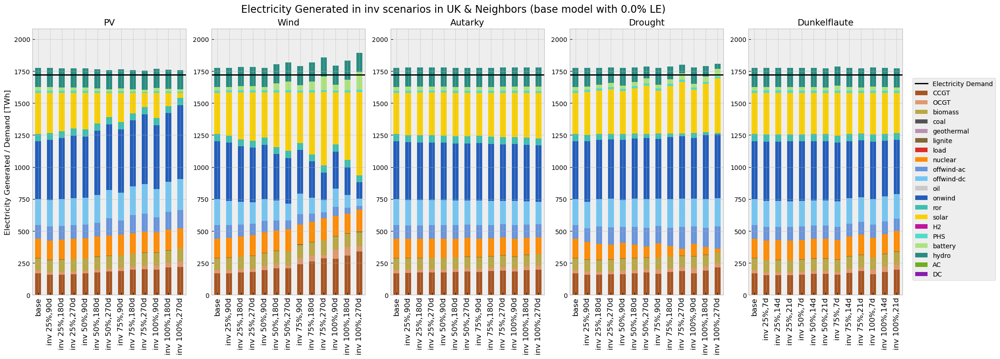

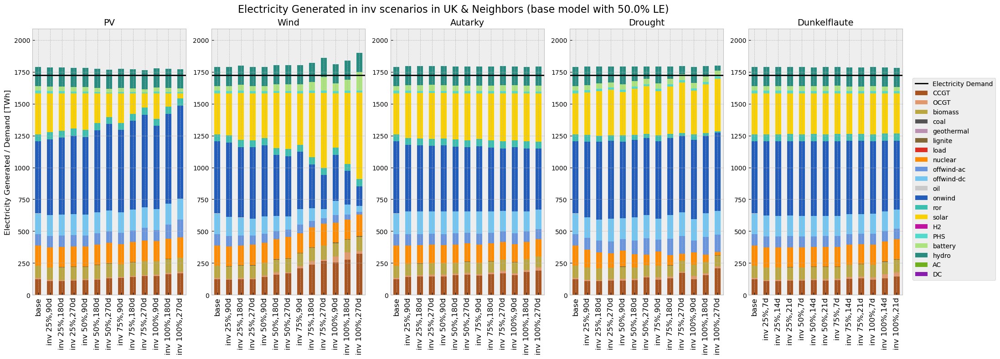

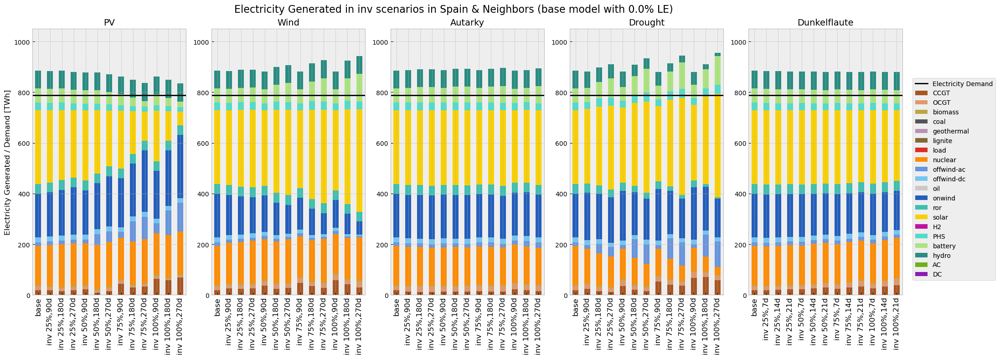

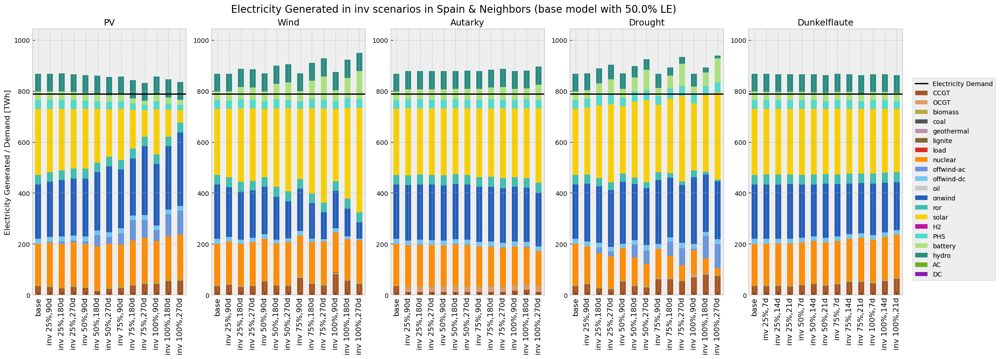

In [20]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        

        #gen base in TWh
        gen = ((globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= base_cap.index)
            for col in globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['inv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'
                        mod_gen = ((globals()[mod_name].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T #TWh
                        mod_gen.rename(index = {0: f'{mod} {int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #find the max y 
            sum =globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis =1) 

            if sum.max()> maxy:
                maxy=sum.max()
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('Electricity Generated / Demand [TWh]')

            
            globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            ax.tick_params(axis='x', labelsize=12)

            ax.tick_params(axis='x', labelsize=12)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=14)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=14)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=14)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=14)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=14)
            
            if country == 'DE':
                ax.axhline(y=de_loads_all, color='black', linestyle='-', label='Electricity Demand')
            if country == 'GB':
                ax.axhline(y=gb_loads_all, color='black', linestyle='-', label='Electricity Demand')
            if country == 'ES':
                ax.axhline(y=es_loads_all, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'Electricity Generated in inv scenarios in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 16)
        elif country == 'GB':
            plt.suptitle(f'Electricity Generated in inv scenarios in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 16)
        elif country == 'ES':
            plt.suptitle(f'Electricity Generated in inv scenarios in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 16)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"sens_saved_cost_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

## Generation all countries noinv (perfect foresight)

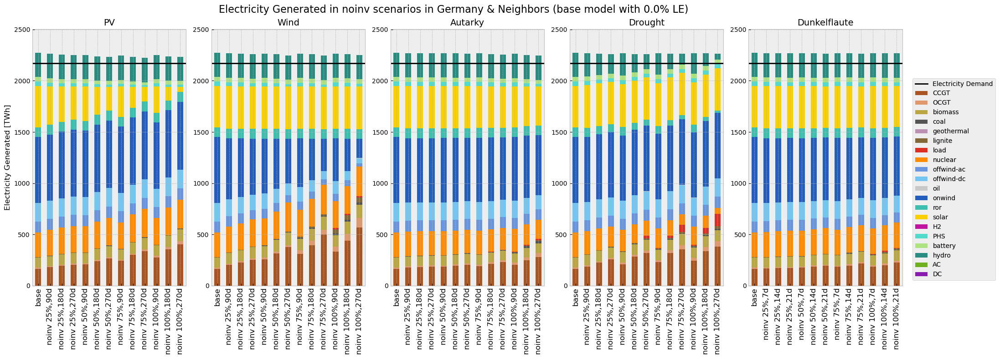

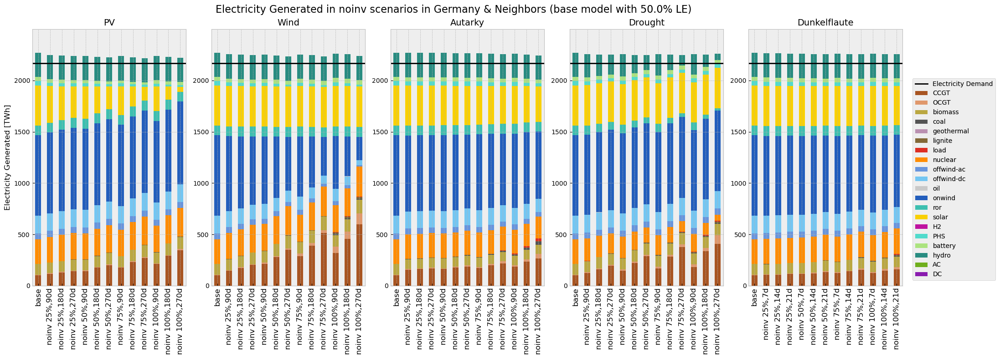

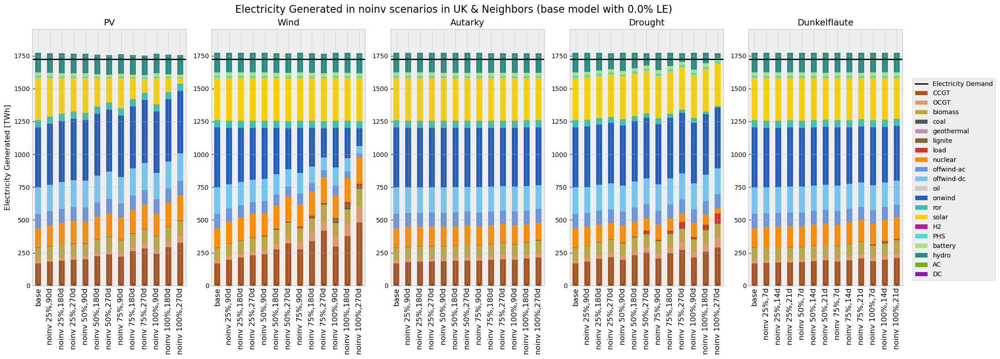

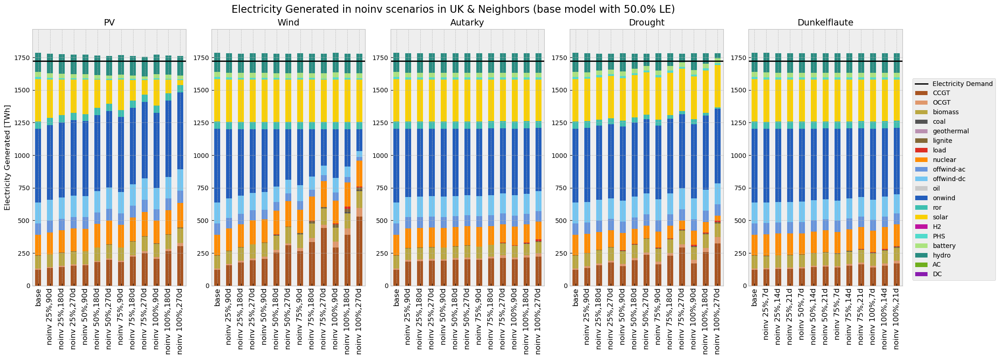

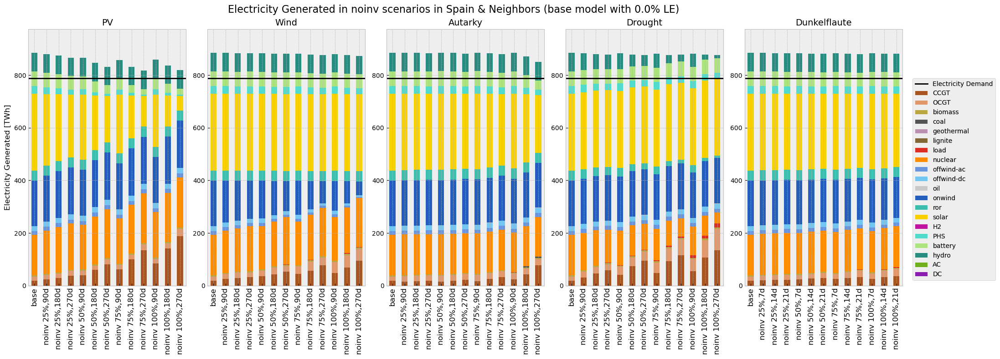

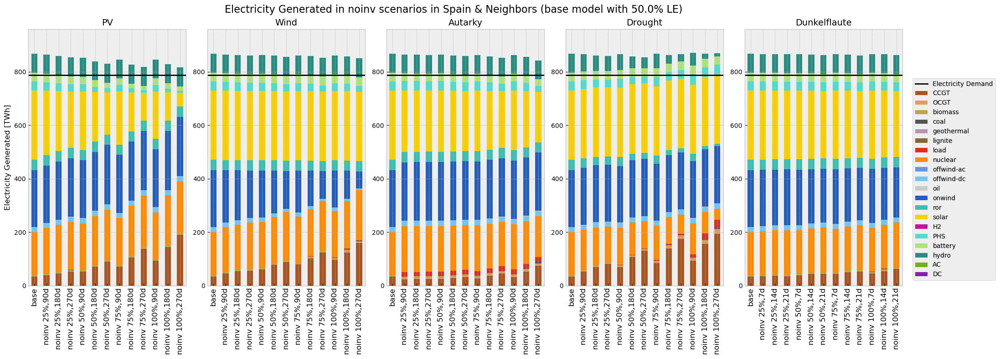

In [21]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        

        #gen base in TWh
        gen = ((globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= base_cap.index)
            for col in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['noinv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'
                        mod_gen = ((globals()[mod_name].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T #TWh
                        mod_gen.rename(index = {0: f'{mod} {int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #find the max y 
            sum =globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis =1) 

            if sum.max()> maxy:
                maxy=sum.max()
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('Electricity Generated [TWh]')

            
            globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            ax.tick_params(axis='x', labelsize=12)

            ax.tick_params(axis='x', labelsize=12)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=14)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=14)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=14)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=14)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=14)
            
            if country == 'DE':
                ax.axhline(y=de_loads_all, color='black', linestyle='-', label='Electricity Demand')
            if country == 'GB':
                ax.axhline(y=gb_loads_all, color='black', linestyle='-', label='Electricity Demand')
            if country == 'ES':
                ax.axhline(y=es_loads_all, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'Electricity Generated in noinv scenarios in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 16)
        elif country == 'GB':
            plt.suptitle(f'Electricity Generated in noinv scenarios in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 16)
        elif country == 'ES':
            plt.suptitle(f'Electricity Generated in noinv scenarios in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 16)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"sens_saved_cost_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

## Load Sheddding bar plot noinv

### perfect foresight

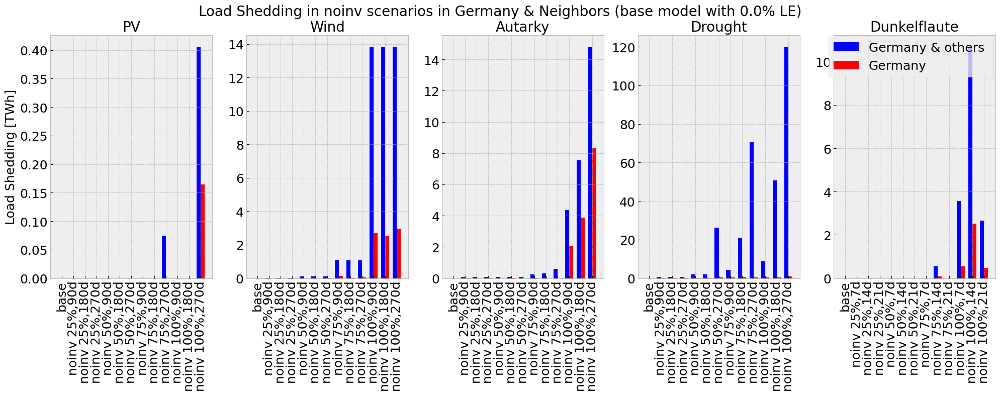

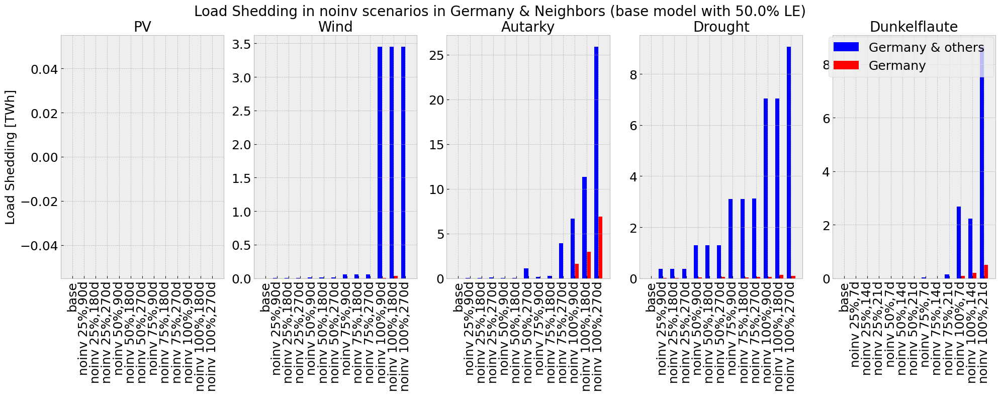

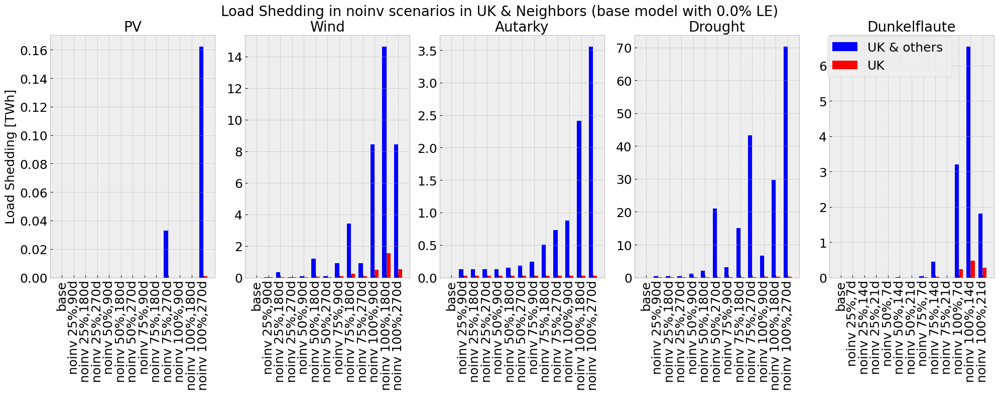

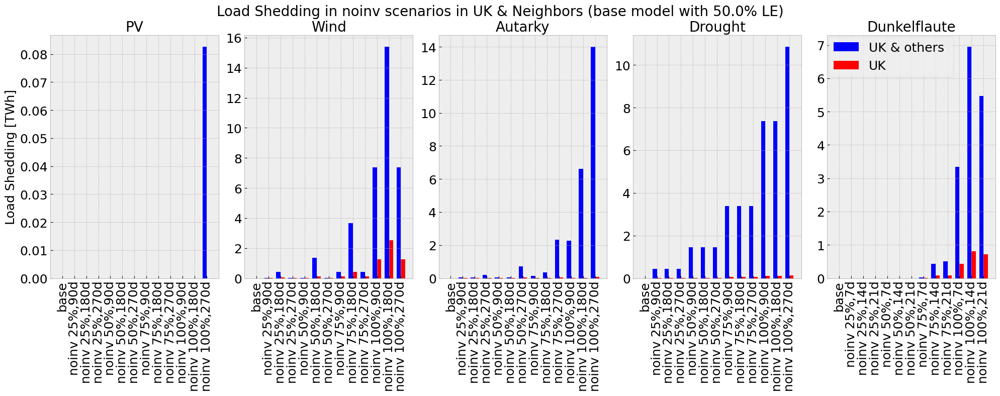

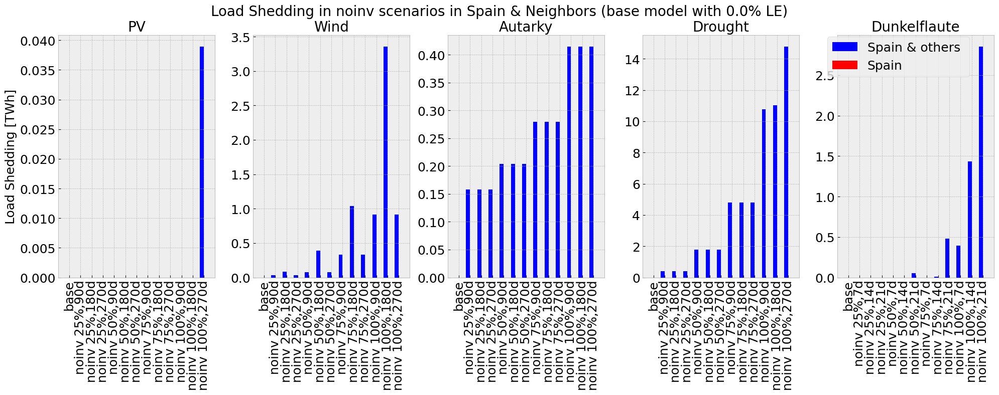

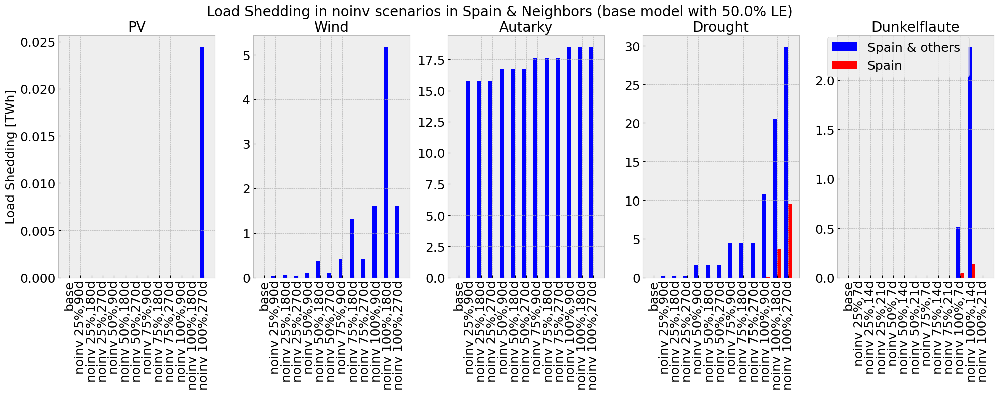

In [22]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        

        #gen base in TWh
        gen = ((globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= base_cap.index)
            for col in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['noinv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'
                        mod_gen = ((globals()[mod_name].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T #TWh
                        mod_gen.rename(index = {0: f'{mod} {int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #find the max y 
            if 'load' in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:
                sum =globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']['load'].max()

            if sum> maxy:
                maxy=sum
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('Load Shedding [TWh]',size = 18)

            # Define the width of the bars
            bar_width = 0.35
            
            df1 = globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']['load']
            df2 = globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']['load']

            r1 = np.arange(len(df1))
            r2 = [x + bar_width for x in r1]

            # Plot bars for the first DataFrame beside each other
            if country == 'GB':
                ax.bar(r1, df1, color='blue', width=bar_width, label=f'UK & others ')
                ax.bar(r2, df2, color='red', width=bar_width, label=f'UK')
            elif country == 'DE':
                ax.bar(r1, df1, color='blue', width=bar_width, label=f'Germany & others ')
                ax.bar(r2, df2, color='red', width=bar_width, label=f'Germany')
            elif country == 'ES':
                ax.bar(r1, df1, color='blue', width=bar_width, label=f'Spain & others ')
                ax.bar(r2, df2, color='red', width=bar_width, label=f'Spain')

            # Customize the x-ticks and labels
            ax.set_xticks([r + bar_width/2 for r in range(len(df1))])
            ax.set_xticklabels(df1.index)
 
            #ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            #ax.tick_params(axis='x', labelsize=12)

            ax.tick_params(axis='x', rotation=90, labelsize=18)
            ax.tick_params(axis='y', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            #if country == 'DE':
                #ax.axhline(y=de_loads_all, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'GB':
                #ax.axhline(y=gb_loads_all, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'ES':
                #ax.axhline(y=es_loads_all, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5),prop={'size': 18})

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'Load Shedding in noinv scenarios in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Load Shedding in noinv scenarios in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Load Shedding in noinv scenarios in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(0.82, 0.85),prop={'size': 18})

        #plt.set_title('')
        # Save plot to the current working directory
        filename = f"load_shedding_{line}_{country}_noinv.png"
        output_path = os.path.join(os.getcwd(), filename)
        plt.savefig(output_path)

        plt.show()

### rolling horizon foresight

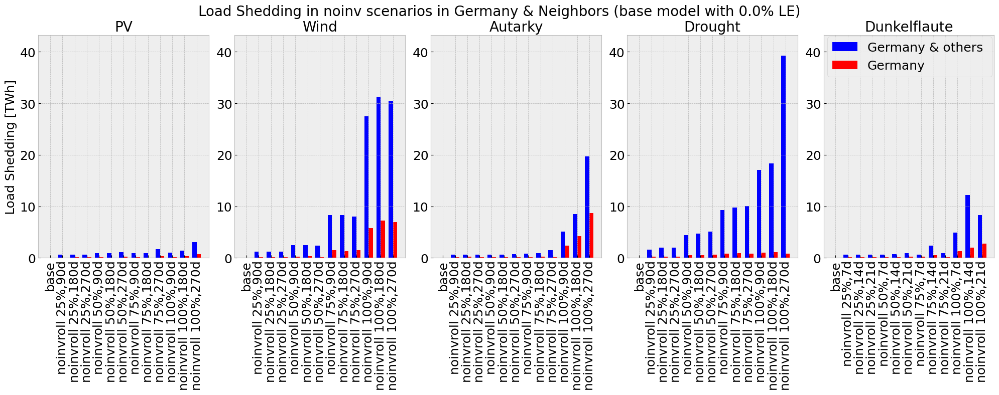

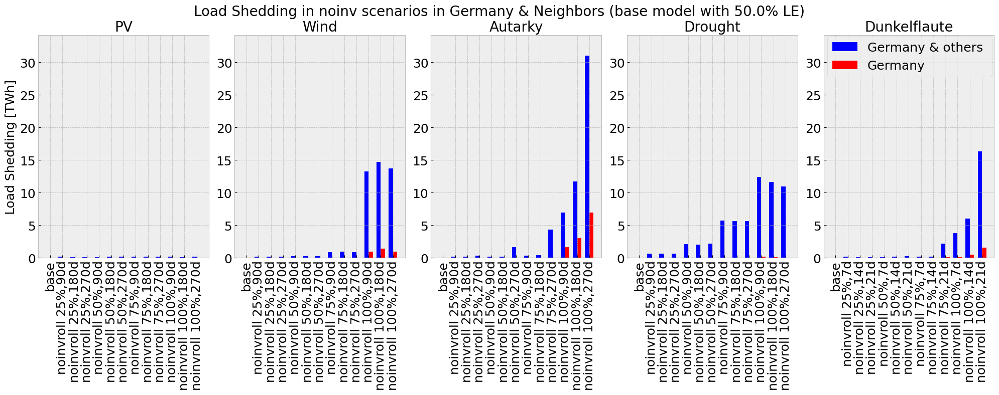

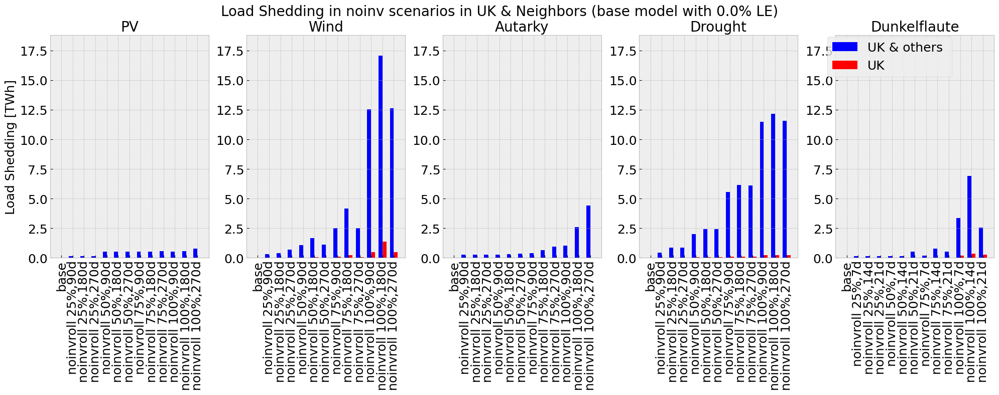

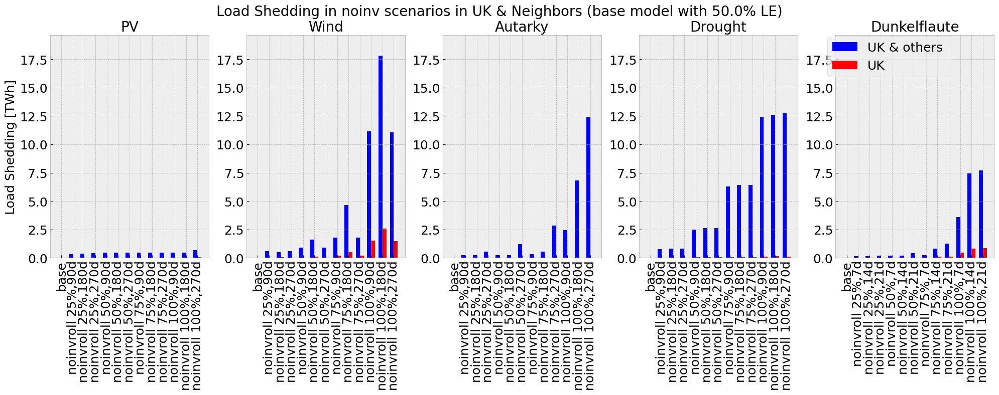

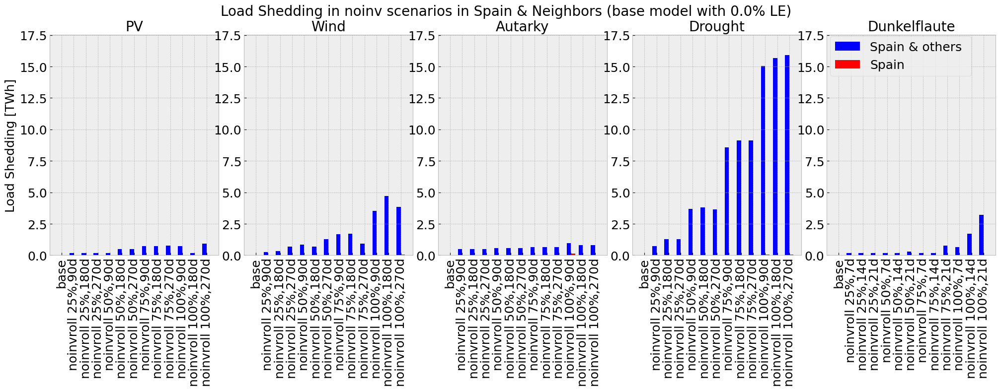

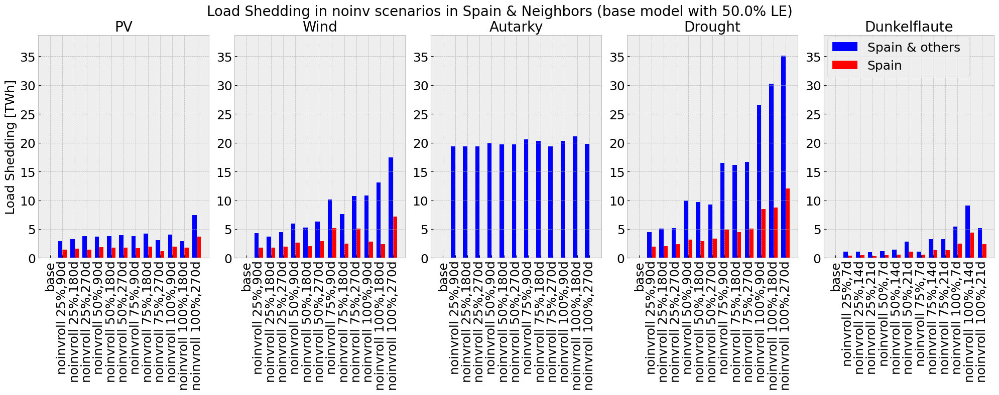

In [23]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        

        #gen base in TWh
        gen = ((globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= base_cap.index)
            for col in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['noinvroll']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'
                        mod_gen = ((globals()[mod_name].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T #TWh
                        mod_gen.rename(index = {0: f'{mod} {int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #find the max y 
            if 'load' in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:
                sum =globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']['load'].max()

            if sum> maxy:
                maxy=sum
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('Load Shedding [TWh]',size = 18)

            # Define the width of the bars
            bar_width = 0.35
            
            df1 = globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']['load']
            df2 = globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']['load']

            r1 = np.arange(len(df1))
            r2 = [x + bar_width for x in r1]

            # Plot bars for the first DataFrame beside each other
            if country == 'GB':
                ax.bar(r1, df1, color='blue', width=bar_width, label=f'UK & others ')
                ax.bar(r2, df2, color='red', width=bar_width, label=f'UK')
            elif country == 'DE':
                ax.bar(r1, df1, color='blue', width=bar_width, label=f'Germany & others ')
                ax.bar(r2, df2, color='red', width=bar_width, label=f'Germany')
            elif country == 'ES':
                ax.bar(r1, df1, color='blue', width=bar_width, label=f'Spain & others ')
                ax.bar(r2, df2, color='red', width=bar_width, label=f'Spain')

            # Customize the x-ticks and labels
            ax.set_xticks([r + bar_width/2 for r in range(len(df1))])
            ax.set_xticklabels(df1.index)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            #ax.tick_params(axis='x', labelsize=12)

            ax.tick_params(axis='x', rotation=90, labelsize=18)
            ax.tick_params(axis='y', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            #if country == 'DE':
                #ax.axhline(y=de_loads_all, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'GB':
                #ax.axhline(y=gb_loads_all, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'ES':
                #ax.axhline(y=es_loads_all, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5),prop={'size': 18})

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'Load Shedding in noinv scenarios in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Load Shedding in noinv scenarios in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Load Shedding in noinv scenarios in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(0.82, 0.85),prop={'size': 18})

        #plt.set_title('')
        # Save plot to the current working directory
        filename = f"load_shedding_{line}_{country}_noinvroll.png"
        output_path = os.path.join(os.getcwd(), filename)
        plt.savefig(output_path)

        plt.show()

## Load shedding bar plot inv (perfect foresight)

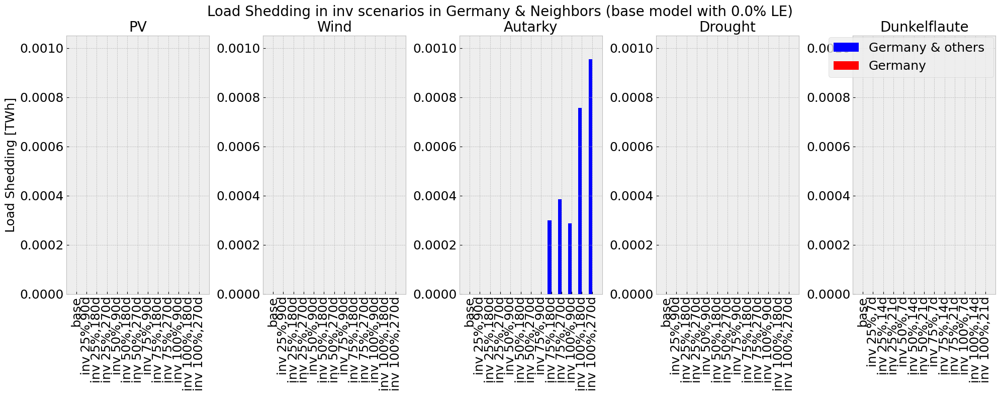

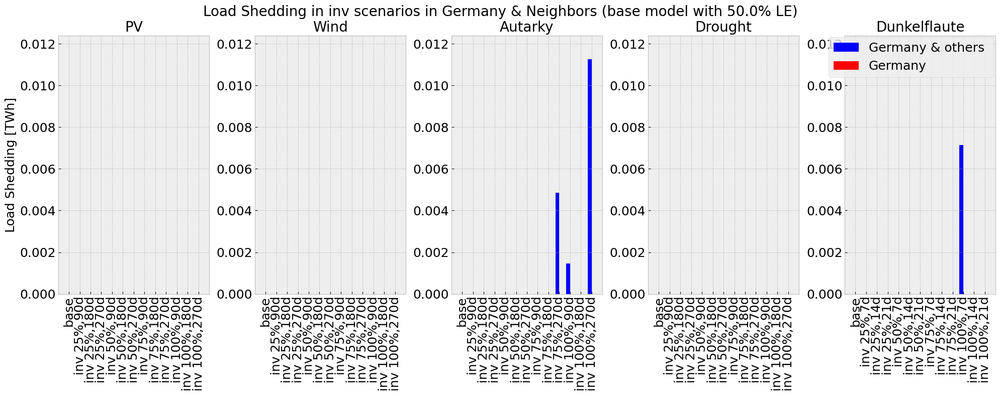

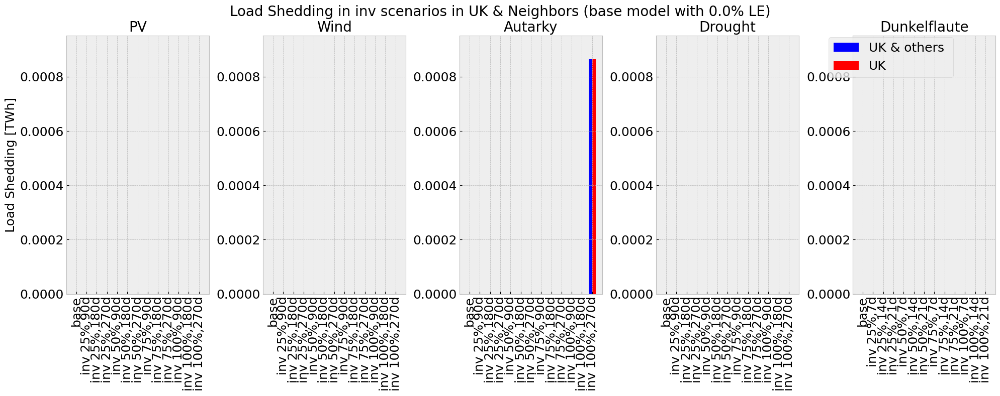

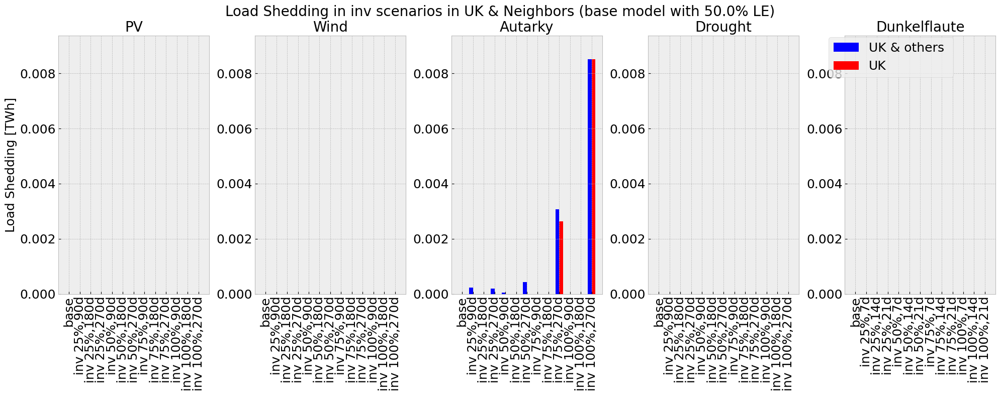

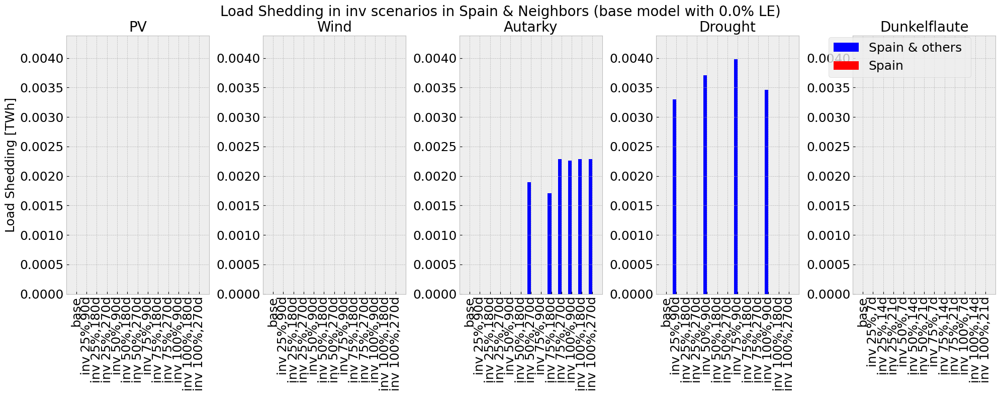

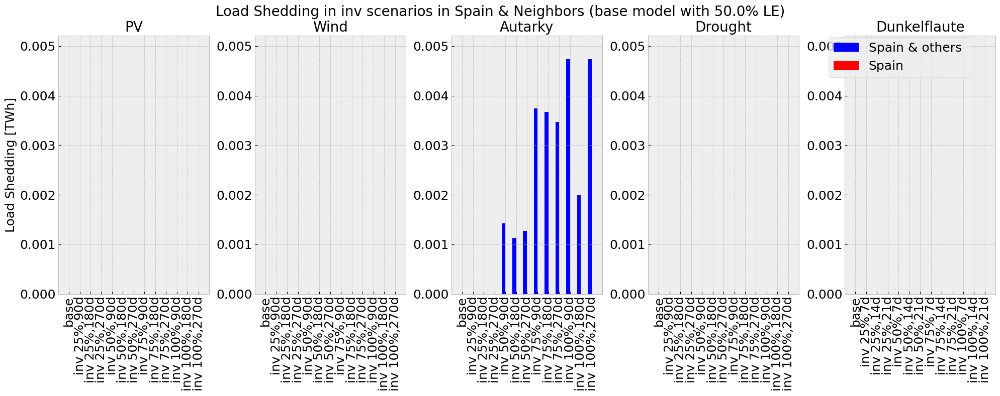

In [24]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        

        #gen base in TWh
        gen = ((globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= base_cap.index)
            for col in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['inv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'
                        mod_gen = ((globals()[mod_name].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T #TWh
                        mod_gen.rename(index = {0: f'{mod} {int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #find the max y 
            if 'load' in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:
                sum =globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']['load'].max()

            if sum> maxy:
                maxy=sum
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('Load Shedding [TWh]',size = 18)

            # Define the width of the bars
            bar_width = 0.35
            
            df1 = globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']['load']
            df2 = globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']['load']

            r1 = np.arange(len(df1))
            r2 = [x + bar_width for x in r1]

            # Plot bars for the first DataFrame beside each other
            if country == 'GB':
                ax.bar(r1, df1, color='blue', width=bar_width, label=f'UK & others ')
                ax.bar(r2, df2, color='red', width=bar_width, label=f'UK')
            elif country == 'DE':
                ax.bar(r1, df1, color='blue', width=bar_width, label=f'Germany & others ')
                ax.bar(r2, df2, color='red', width=bar_width, label=f'Germany')
            elif country == 'ES':
                ax.bar(r1, df1, color='blue', width=bar_width, label=f'Spain & others ')
                ax.bar(r2, df2, color='red', width=bar_width, label=f'Spain')

            # Customize the x-ticks and labels
            ax.set_xticks([r + bar_width/2 for r in range(len(df1))])
            ax.set_xticklabels(df1.index)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            #ax.tick_params(axis='x', labelsize=12)

            ax.tick_params(axis='x', rotation=90, labelsize=18)
            ax.tick_params(axis='y', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            #if country == 'DE':
                #ax.axhline(y=de_loads_all, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'GB':
                #ax.axhline(y=gb_loads_all, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'ES':
                #ax.axhline(y=es_loads_all, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5),prop={'size': 18})

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'Load Shedding in inv scenarios in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Load Shedding in inv scenarios in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Load Shedding in inv scenarios in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(0.82, 0.85),prop={'size': 18})

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"load_shedding_{line}_{country}_noinv.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

## Emission of the selected countries during the noinv scenarios (perfect foresight)

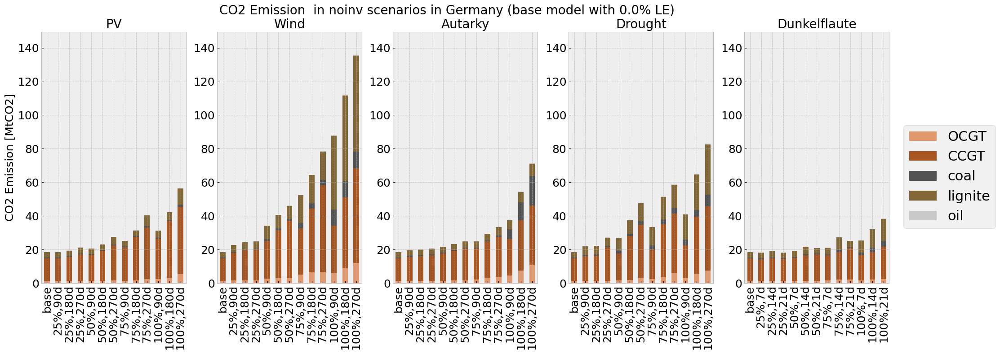

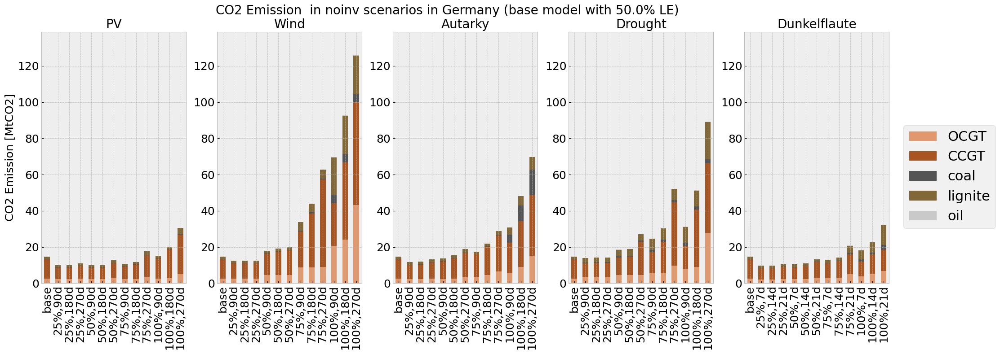

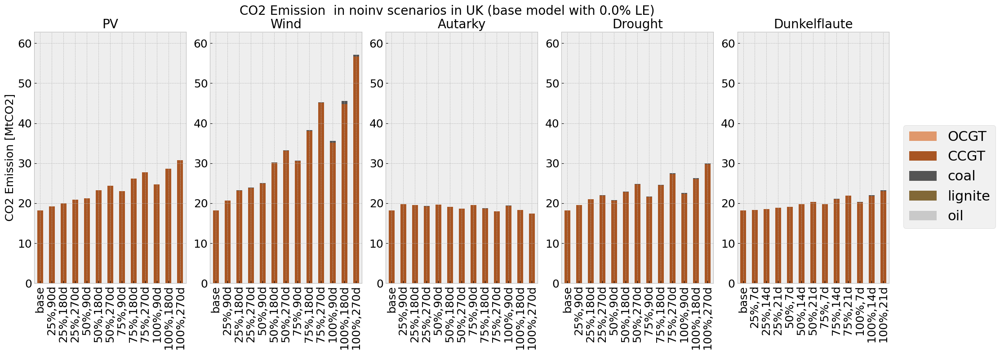

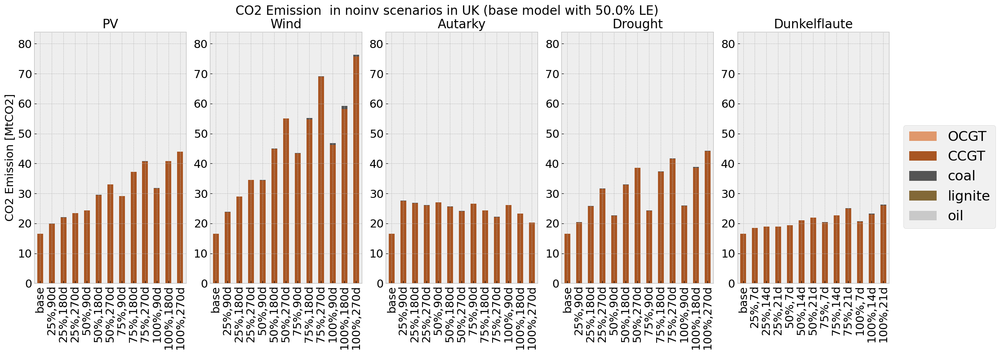

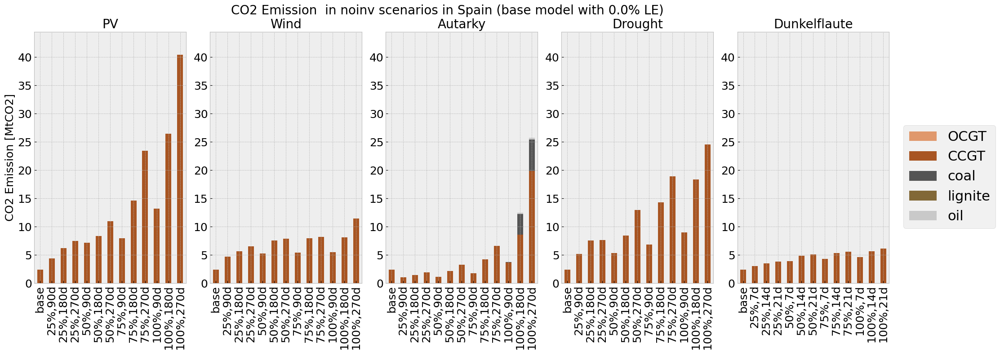

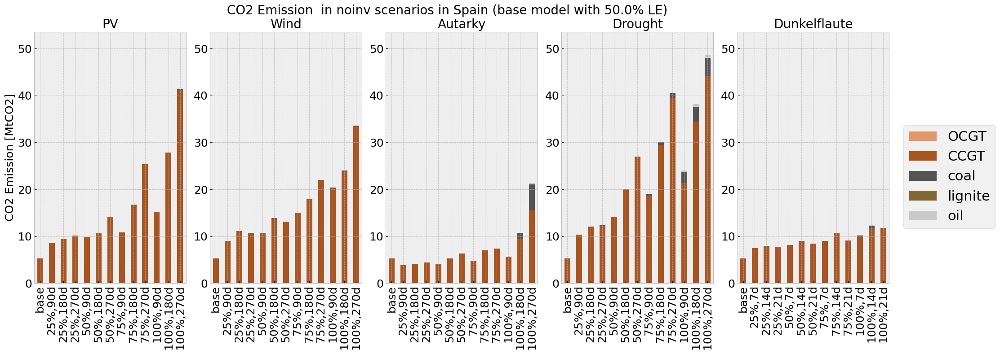

In [25]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        

        #gen base in TWh
        gen = (globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'][globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved']['country'] == country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= base_cap.index)
            for col in globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['noinv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'
                        mod_gen = (globals()[mod_name][globals()[mod_name]['country']==country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3 #TWh

                        #if mod_name == 'gen_wind_DE_20_1_5_0_25_90_noinv':
                            #print(mod_gen)
                        mod_gen.rename(index = {0: f'{int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)
                        
                        
                        globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:
                                
                                globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                                
                                #if mod_name == 'gen_wind_DE_20_1_5_0_25_90_noinv':
                                    #print(col, mod_gen.index[0], mod_gen.loc[mod_gen.index[0],col])
                            
                            else:
                                globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #if contingency_el == 'wind' and line == 1.5:
                #print(globals()[f'gen_noinv_mainDE_1_5_wind_df'][['CCGT','OCGT']])

            #calculate emission
            eff = globals()[f'n_{country}'].generators.groupby('carrier').efficiency.mean()

            co2_per_TWh = globals()[f'n_{country}'].carriers.co2_emissions #MtCO2/TWh_th

            globals()[f'em_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = globals()[f'gen_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[:,['OCGT','CCGT','coal','lignite','oil']]#, axis =1)
            #drop(columns=['AC','DC','battery','H2','hydro','PHS'])

            for col in globals()[f'em_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:
                
                globals()[f'em_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'][col] = globals()[f'em_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'][col]/eff[col]*co2_per_TWh[col] #TWh_th*tCO2/Twh_th = tCO2  


            #find the max y 
            sum =globals()[f'em_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis =1) 

            if sum.max()> maxy:
                maxy=sum.max()
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('CO2 Emission [MtCO2]', size = 18)

            
            globals()[f'em_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            ax.tick_params(axis='x', labelsize=18)

            ax.tick_params(axis='x', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            ax.tick_params(axis='x', rotation=90, labelsize = 18)
            ax.tick_params(axis='y', rotation=0, labelsize = 18)
            #if country == 'DE':
                #ax.axhline(y=de_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'GB':
                #ax.axhline(y=gb_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'ES':
                #ax.axhline(y=es_loads, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        #by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in Germany (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in UK (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in Spain (base model with {str((line-1)*100)}% LE)', fontsize = 20)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 22})

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"sens_saved_cost_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

## Emission of the selected countries during the noinv scenarios (rolling horizon foresight)

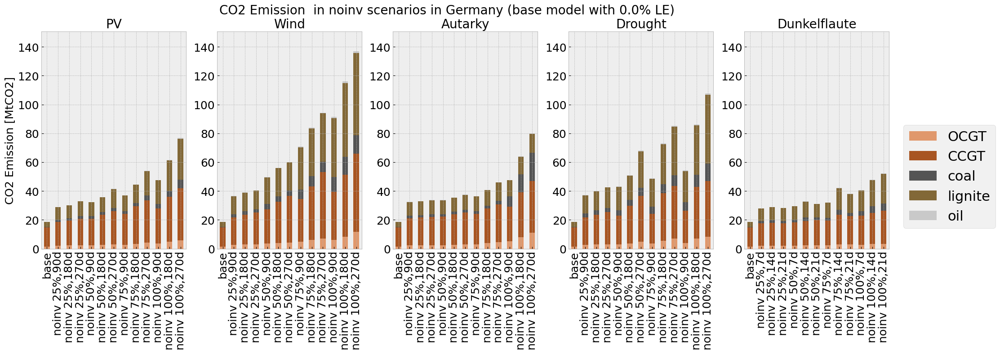

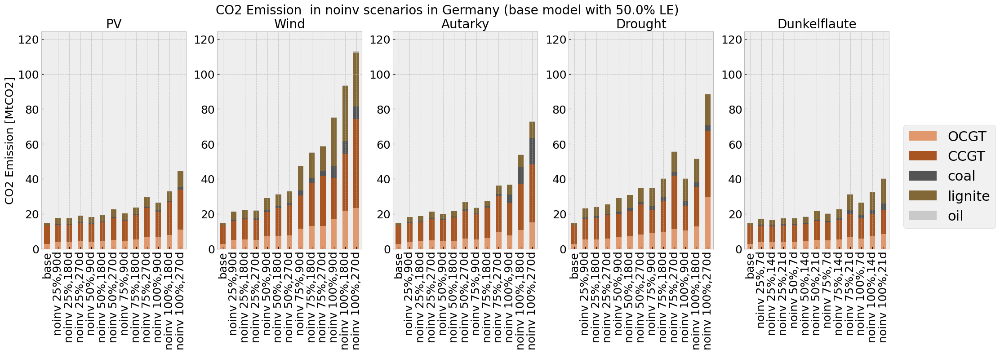

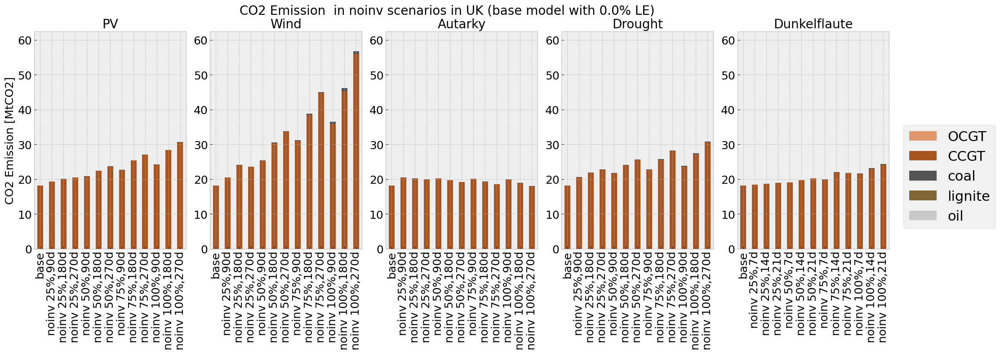

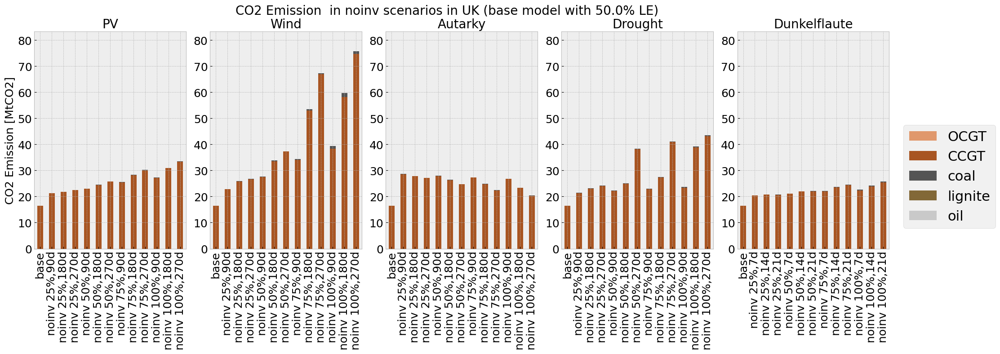

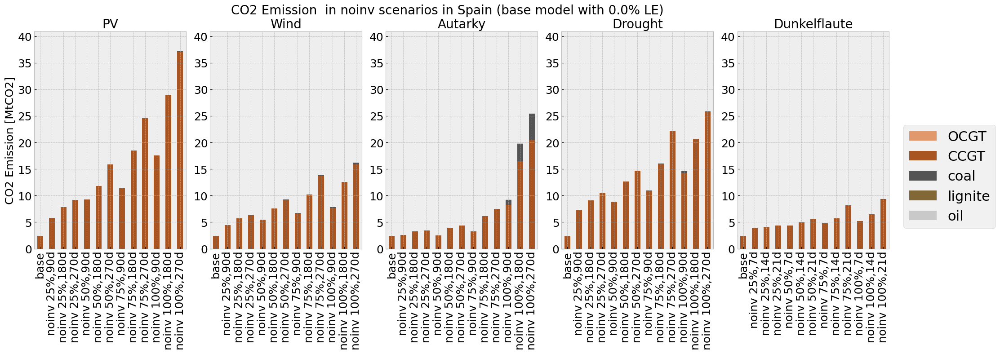

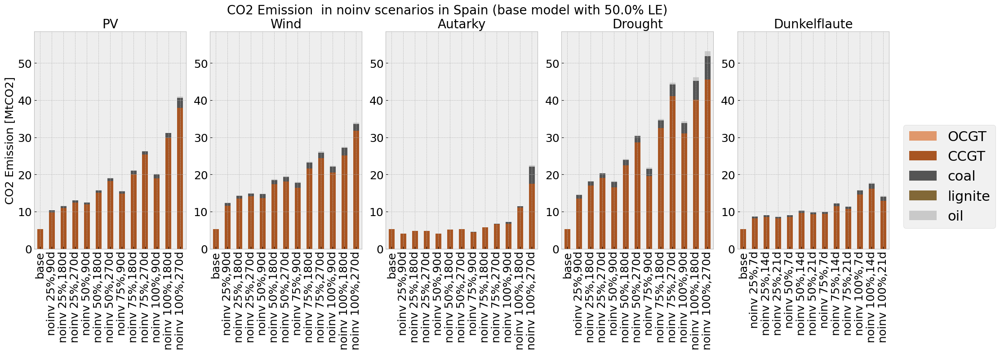

In [26]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        

        #gen base in TWh
        gen = (globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'][globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved']['country'] == country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= base_cap.index)
            for col in globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['noinv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}roll'
                        mod_gen = (globals()[mod_name][globals()[mod_name]['country']==country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3 #TWh
                        mod_gen.rename(index = {0: f'{mod} {int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #calculate emission
            eff = globals()[f'n_{country}'].generators.groupby('carrier').efficiency.mean()

            co2_per_TWh = globals()[f'n_{country}'].carriers.co2_emissions #MtCO2/TWh_th

            globals()[f'em_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = globals()[f'gen_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[:,['OCGT','CCGT','coal','lignite','oil']]#, axis =1)
            #drop(columns=['AC','DC','battery','H2','hydro','PHS'])

            for col in globals()[f'em_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:
                
                globals()[f'em_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'][col] = globals()[f'em_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'][col]/eff[col]*co2_per_TWh[col] #TWh_th*tCO2/Twh_th = tCO2  


            #find the max y 
            sum =globals()[f'em_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis =1) 

            if sum.max()> maxy:
                maxy=sum.max()
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('CO2 Emission [MtCO2]', size = 18)

            
            globals()[f'em_noinvroll_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            ax.tick_params(axis='x', labelsize=18)

            ax.tick_params(axis='x', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            ax.tick_params(axis='x', rotation=90, labelsize = 18)
            ax.tick_params(axis='y', rotation=0, labelsize = 18)
            #if country == 'DE':
                #ax.axhline(y=de_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'GB':
                #ax.axhline(y=gb_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'ES':
                #ax.axhline(y=es_loads, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        #by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in Germany (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in UK (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in Spain (base model with {str((line-1)*100)}% LE)', fontsize = 20)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 22})

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"sens_saved_cost_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

## Emission of the inv scenarios solved with perfect foresight

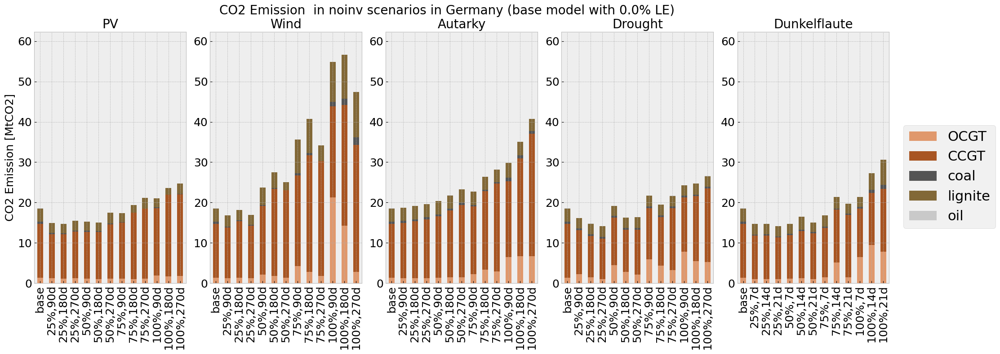

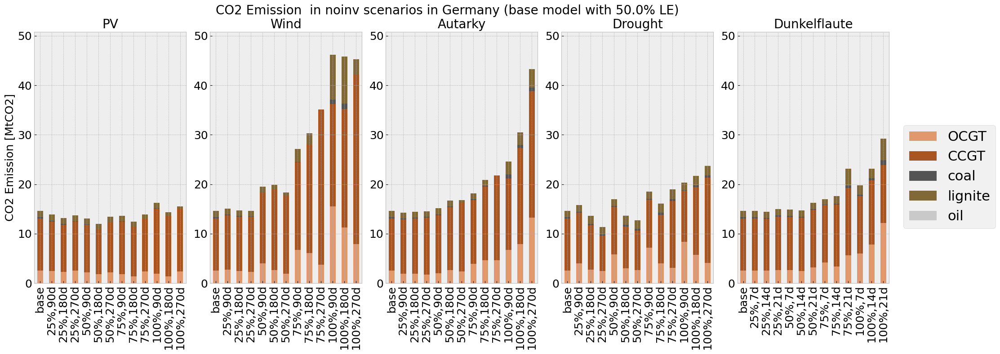

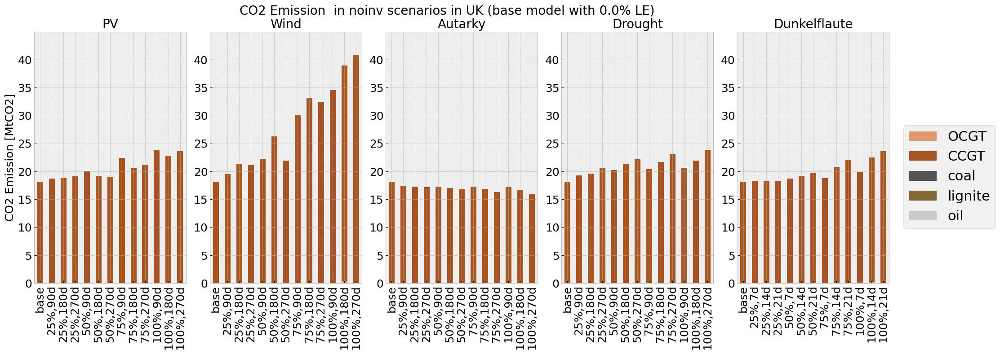

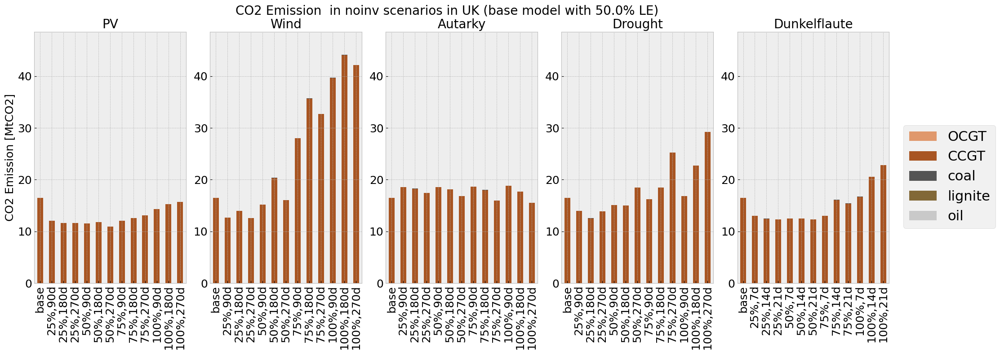

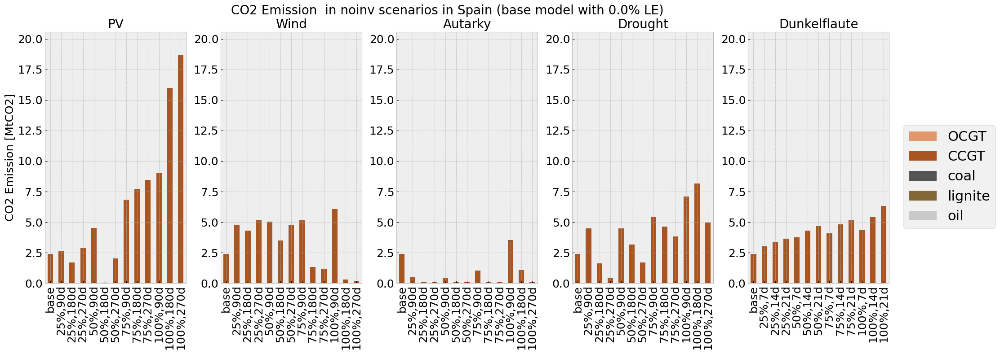

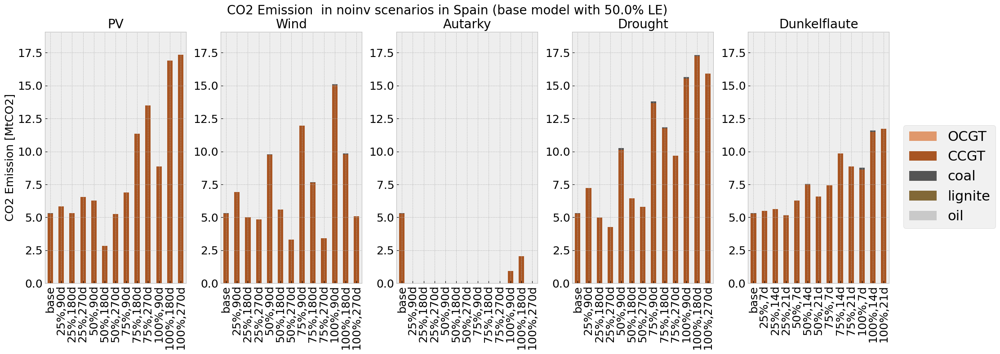

In [27]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        

        #gen base in TWh
        gen = (globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'][globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved']['country'] == country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= base_cap.index)
            for col in globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['inv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'
                        mod_gen = (globals()[mod_name][globals()[mod_name]['country']==country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3 #TWh
                        mod_gen.rename(index = {0: f'{int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #calculate emission
            eff = globals()[f'n_{country}'].generators.groupby('carrier').efficiency.mean()

            co2_per_TWh = globals()[f'n_{country}'].carriers.co2_emissions #MtCO2/TWh_th

            globals()[f'em_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = globals()[f'gen_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[:,['OCGT','CCGT','coal','lignite','oil']]#, axis =1)
            #drop(columns=['AC','DC','battery','H2','hydro','PHS'])

            for col in globals()[f'em_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:
                
                globals()[f'em_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'][col] = globals()[f'em_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'][col]/eff[col]*co2_per_TWh[col] #TWh_th*tCO2/Twh_th = tCO2  


            #find the max y 
            sum =globals()[f'em_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis =1) 

            if sum.max()> maxy:
                maxy=sum.max()
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('CO2 Emission [MtCO2]', size = 18)

            
            globals()[f'em_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            ax.tick_params(axis='x', labelsize=18)

            ax.tick_params(axis='x', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            ax.tick_params(axis='x', rotation=90, labelsize = 18)
            ax.tick_params(axis='y', rotation=0, labelsize = 18)
            #if country == 'DE':
                #ax.axhline(y=de_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'GB':
                #ax.axhline(y=gb_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'ES':
                #ax.axhline(y=es_loads, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        #by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in Germany (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in UK (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in Spain (base model with {str((line-1)*100)}% LE)', fontsize = 20)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 22})

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"sens_saved_cost_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

## Emission all countries inv

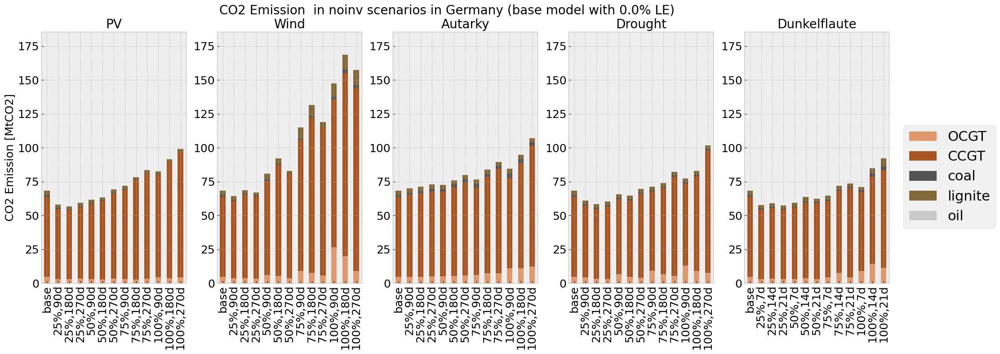

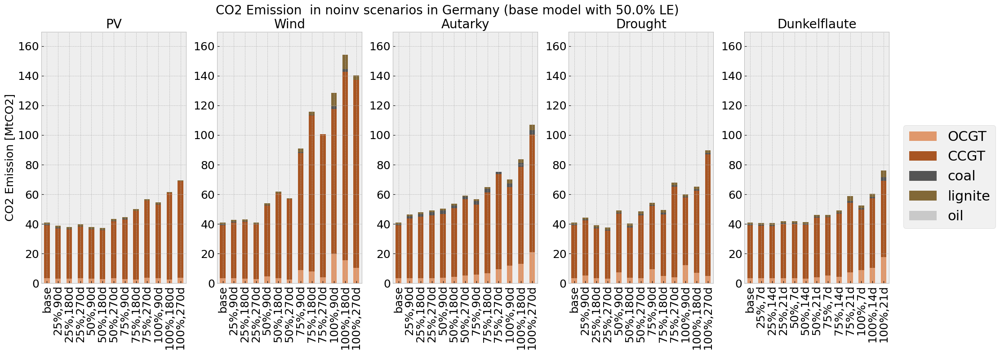

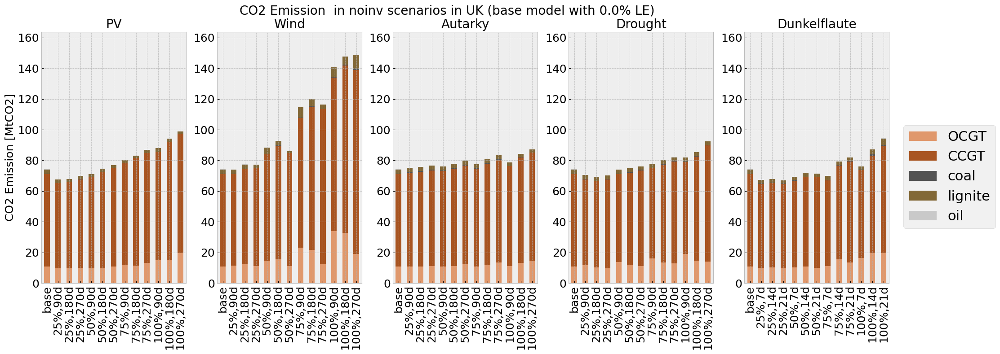

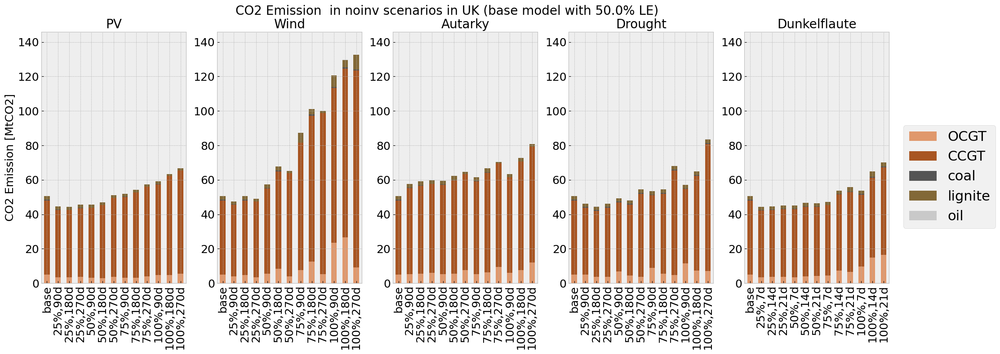

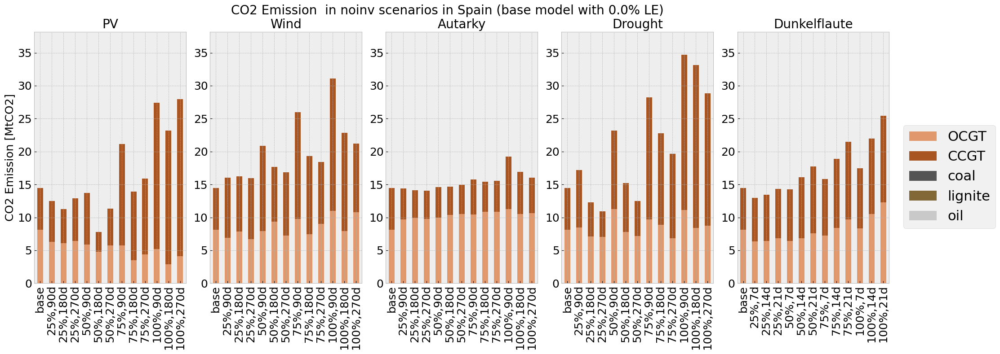

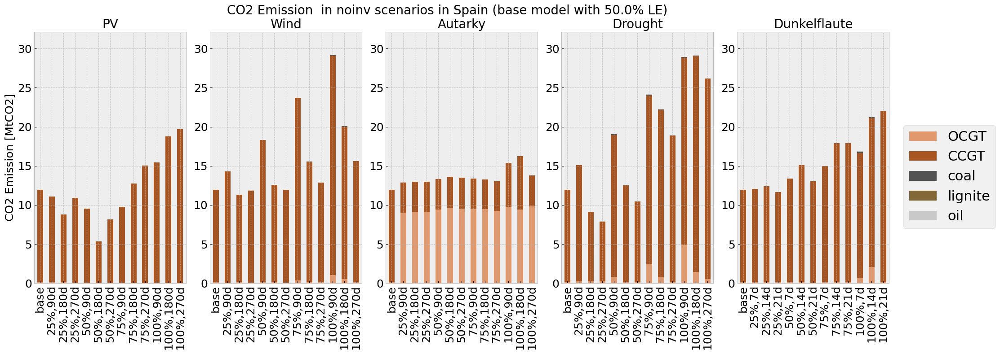

In [28]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        

        #gen base in TWh
        gen = ((globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= base_cap.index)
            for col in globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['inv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'
                        mod_gen = ((globals()[mod_name].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T #TWh
                        mod_gen.rename(index = {0: f'{int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #calculate emission
            eff = globals()[f'n_{country}'].generators.groupby('carrier').efficiency.mean()

            co2_per_TWh = globals()[f'n_{country}'].carriers.co2_emissions #MtCO2/TWh_th

            globals()[f'em_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = globals()[f'gen_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[:,['OCGT','CCGT','coal','lignite','oil']]#, axis =1)
            #drop(columns=['AC','DC','battery','H2','hydro','PHS'])

            for col in globals()[f'em_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:
                
                globals()[f'em_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'][col] = globals()[f'em_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'][col]/eff[col]*co2_per_TWh[col] #TWh_th*tCO2/Twh_th = tCO2  


            #find the max y 
            sum =globals()[f'em_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis =1) 

            if sum.max()> maxy:
                maxy=sum.max()
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('CO2 Emission [MtCO2]', size = 18)

            
            globals()[f'em_inv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            ax.tick_params(axis='x', labelsize=18)

            ax.tick_params(axis='x', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            ax.tick_params(axis='x', rotation=90, labelsize = 18)
            ax.tick_params(axis='y', rotation=0, labelsize = 18)
            #if country == 'DE':
                #ax.axhline(y=de_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'GB':
                #ax.axhline(y=gb_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'ES':
                #ax.axhline(y=es_loads, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        #by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in Germany (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in UK (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in Spain (base model with {str((line-1)*100)}% LE)', fontsize = 20)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 22})

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"sens_saved_cost_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

## Emission all countries noinv

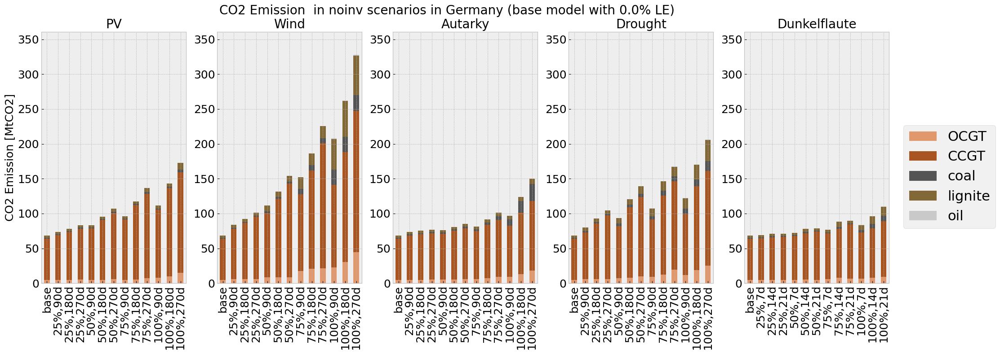

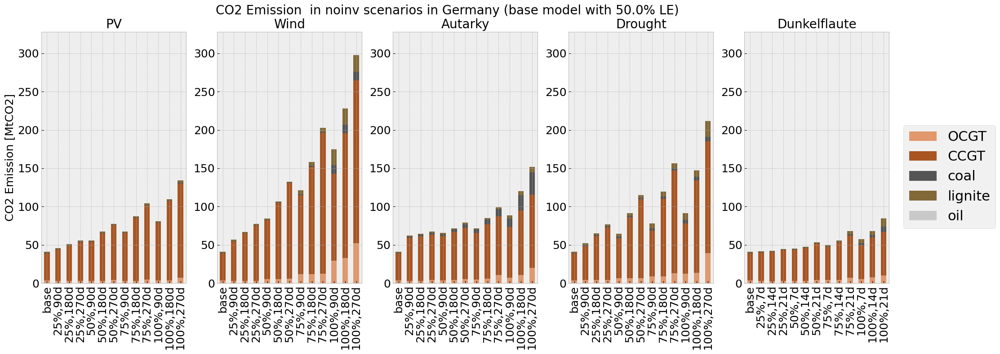

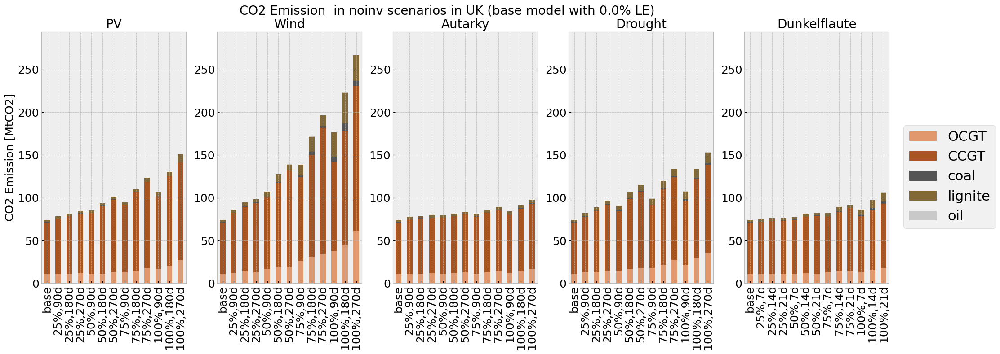

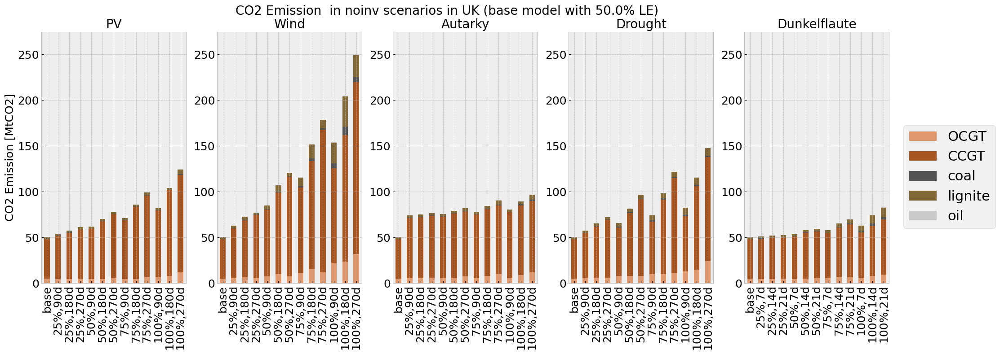

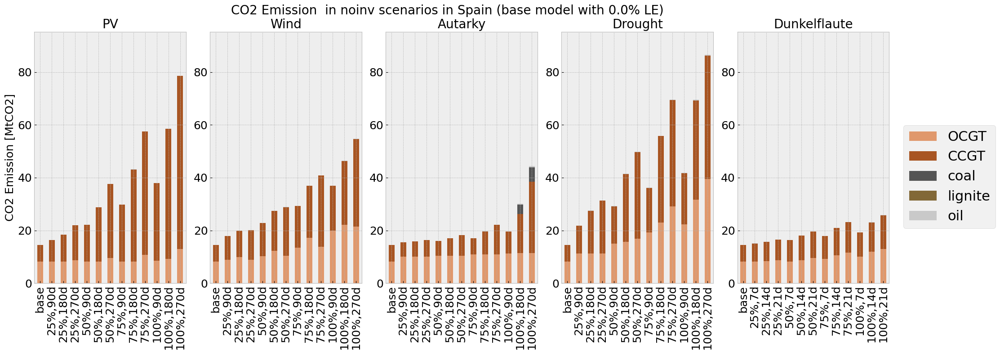

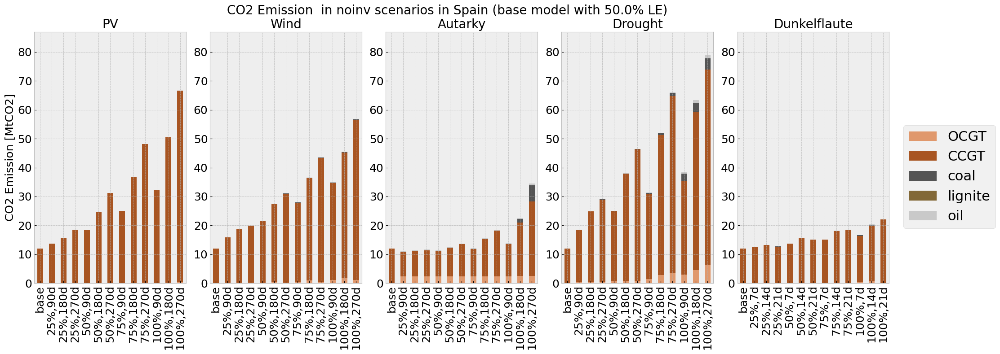

In [29]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        

        #gen base in TWh
        gen = ((globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T
        gen.rename(index={0: 'base'}, inplace=True)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax
            

            #create df
            globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = pd.DataFrame(columns= base_cap.index)
            for col in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                if col in gen.columns:

                    globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = gen.loc['base',col]

                else:

                    globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc['base', col] = 0
            
            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['noinv']:#'inv', 

                        bus = countries[country]['bus']
                        mod_name = f'gen_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'
                        mod_gen = ((globals()[mod_name].drop(columns=['country']).sum(axis=1).to_frame())*timestep/1e3).groupby('carrier').sum().T #TWh
                        mod_gen.rename(index = {0: f'{int(-(reductionto-1)*100)}%,{duration}d'}, inplace = True)

                        
                        globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0],:] = 0
                        for col in globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:

                            if col in mod_gen.columns:

                                globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = mod_gen.loc[mod_gen.index[0],col]
                            
                            else:
                                globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[mod_gen.index[0], col] = 0

            globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].fillna(0, inplace = True)

            #calculate emission
            eff = globals()[f'n_{country}'].generators.groupby('carrier').efficiency.mean()

            co2_per_TWh = globals()[f'n_{country}'].carriers.co2_emissions #MtCO2/TWh_th

            globals()[f'em_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = globals()[f'gen_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].loc[:,['OCGT','CCGT','coal','lignite','oil']]#, axis =1)
            #drop(columns=['AC','DC','battery','H2','hydro','PHS'])

            for col in globals()[f'em_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns:
                
                globals()[f'em_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'][col] = globals()[f'em_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'][col]/eff[col]*co2_per_TWh[col] #TWh_th*tCO2/Twh_th = tCO2  


            #find the max y 
            sum =globals()[f'em_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis =1) 

            if sum.max()> maxy:
                maxy=sum.max()
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('CO2 Emission [MtCO2]', size = 18)

            
            globals()[f'em_noinv_all{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
 
            ax.set_ylim([0,maxy*1.1])

            # Set the x-ticks and x-tick labels
            ax.tick_params(axis='x', labelsize=18)

            ax.tick_params(axis='x', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            ax.tick_params(axis='x', rotation=90, labelsize = 18)
            ax.tick_params(axis='y', rotation=0, labelsize = 18)
            #if country == 'DE':
                #ax.axhline(y=de_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'GB':
                #ax.axhline(y=gb_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'ES':
                #ax.axhline(y=es_loads, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        #by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in Germany (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in UK (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'CO2 Emission  in noinv scenarios in Spain (base model with {str((line-1)*100)}% LE)', fontsize = 20)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 22})

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"sens_saved_cost_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

## Difference in Emission Inv and Noinv

mean:15.0 MtCO2, max: 88.0, min: 1.0


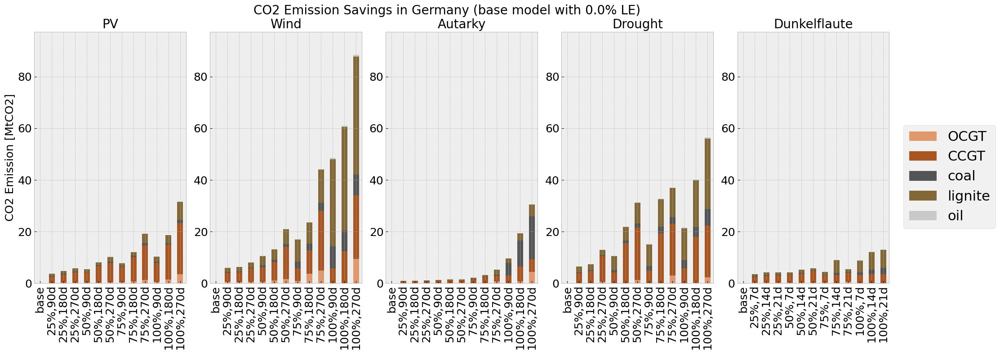

mean:7.0 MtCO2, max: 81.0, min: -5.0


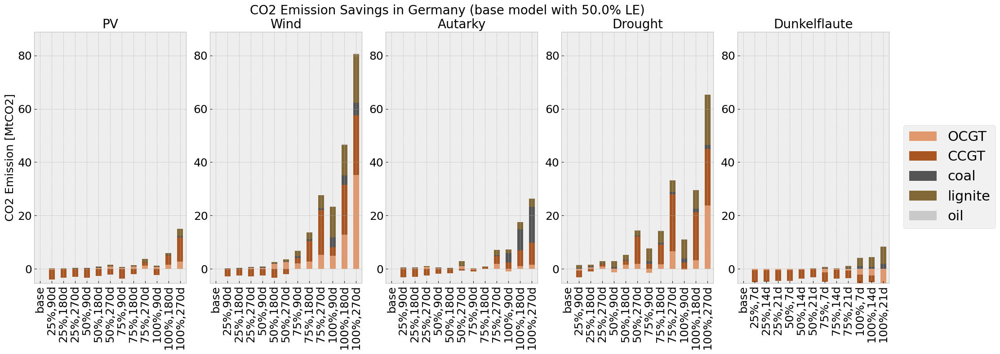

mean:3.0 MtCO2, max: 16.0, min: -1.0


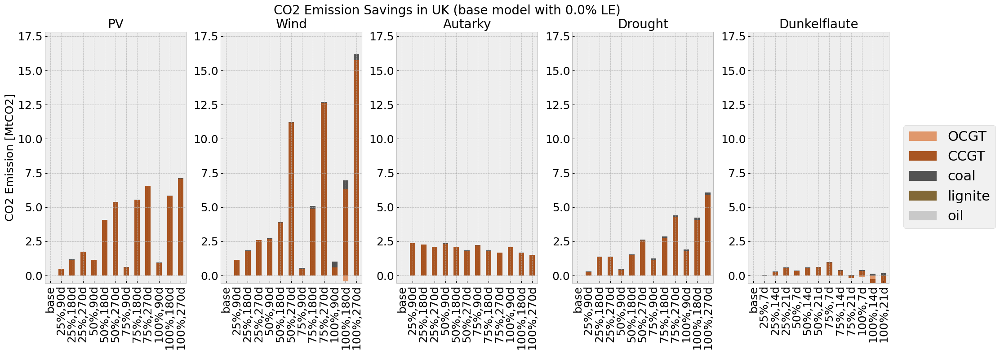

mean:14.0 MtCO2, max: 39.0, min: 3.0


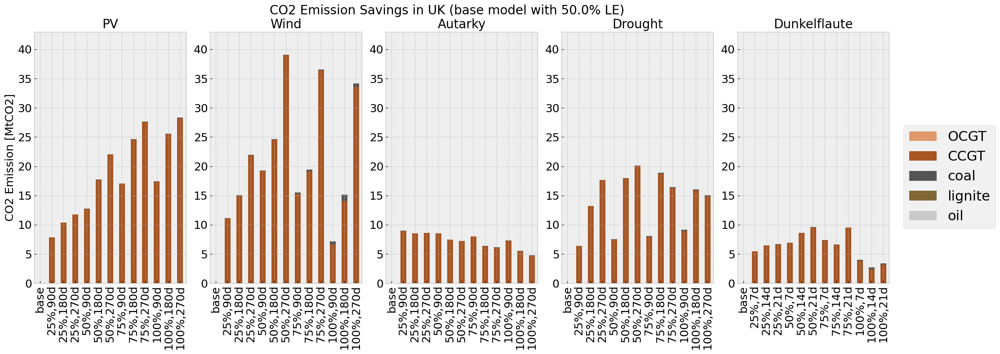

mean:5.0 MtCO2, max: 26.0, min: -1.0


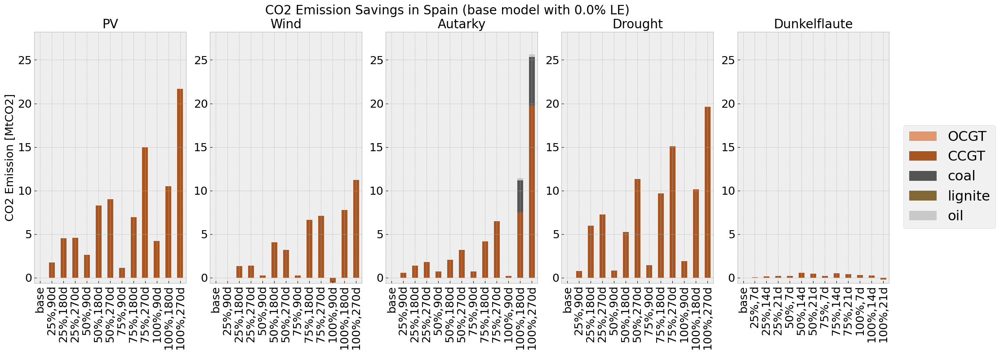

mean:8.0 MtCO2, max: 33.0, min: 0.0


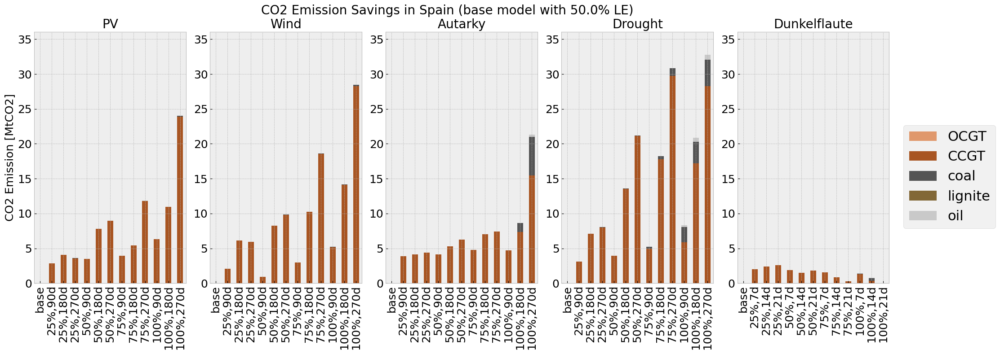

In [43]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():

    

    for line, contingencies_el in element_to_ax.items():

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))#,
                            #gridspec_kw={'hspace': 1}, constrained_layout=True)
        axes = axes.flatten()

        all_handles = []
        all_labels = []

        # calculate timestep of df
        date0 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[0])
        date1 = pd.to_datetime(globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'].drop(columns=['country']).columns[1])

        timestep = (date1-date0).total_seconds()/3600

        #max y
        maxy=0
        miny= 0
        

        #gen base in TWh
        gen = (globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved'][globals()[f'gen_{country}_{sanitize_variable_name(str(line))}_base_solved']['country'] == country].drop(columns=['country']).sum(axis=1).to_frame().T)*timestep/1e3
        gen.rename(index={0: 'base'}, inplace=True)

        globals()[f'em_diff_main{country}_{sanitize_variable_name(str(line))}_tot_df'] = pd.DataFrame(columns= globals()[f'em_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].columns)

        for contingency_el,ax in contingencies_el.items():

            ax_count = ax

            

            globals()[f'em_diff_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'] = globals()[f'em_noinv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']-globals()[f'em_inv_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']

            globals()[f'em_diff_main{country}_{sanitize_variable_name(str(line))}_tot_df'] = pd.concat([globals()[f'em_diff_main{country}_{sanitize_variable_name(str(line))}_tot_df'],globals()[f'em_diff_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df']])


            #find the max y 
            sum =globals()[f'em_diff_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].sum(axis =1) 

            if sum.max()> maxy:
                maxy=sum.max()

            if sum.min() <miny:
                miny =sum.min()
        
        sum_carrier = globals()[f'em_diff_main{country}_{sanitize_variable_name(str(line))}_tot_df'].sum(axis =1 ).drop('base')

        print(f'mean:{round(sum_carrier.mean(),0)} MtCO2, max: {round(sum_carrier.max(),0)}, min: {round(sum_carrier.min(),0)}')
            
        for contingency_el,ax in contingencies_el.items():
            ax_count= ax
            ax = axes[ax]

            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('CO2 Emission [MtCO2]', size = 18)

            
            globals()[f'em_diff_main{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
 
            ax.set_ylim([miny*1.1,maxy*1.1])

            # Set the x-ticks and x-tick labels
            ax.tick_params(axis='x', labelsize=18)

            ax.tick_params(axis='x', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            ax.tick_params(axis='x', rotation=90, labelsize = 18)
            ax.tick_params(axis='y', rotation=0, labelsize = 18)
            #if country == 'DE':
                #ax.axhline(y=de_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'GB':
                #ax.axhline(y=gb_loads, color='black', linestyle='-', label='Electricity Demand')
            #if country == 'ES':
                #ax.axhline(y=es_loads, color='black', linestyle='-', label='Electricity Demand')
            

            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        #by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        

        if country == 'DE':
            plt.suptitle(f'CO2 Emission Savings in Germany (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'CO2 Emission Savings in UK (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'CO2 Emission Savings in Spain (base model with {str((line-1)*100)}% LE)', fontsize = 20)



        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size': 22})

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"sens_saved_cost_{country}.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()
    

# Cost


## perfect foresight

### System cost all countries 

In this section the system cost of the neighboring countries are also included in the plots

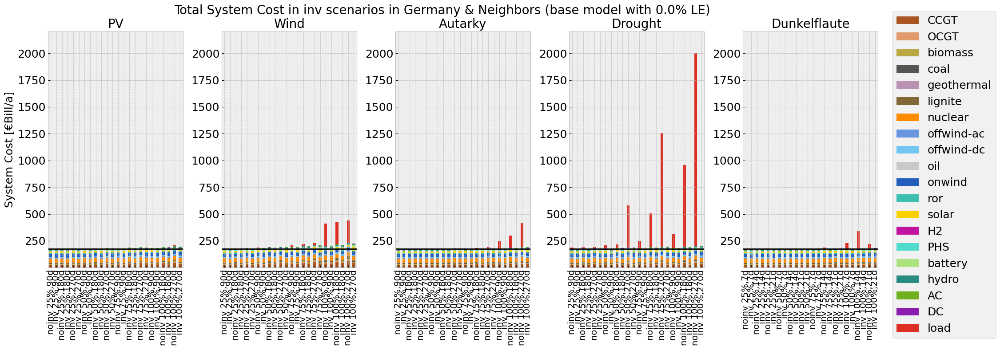

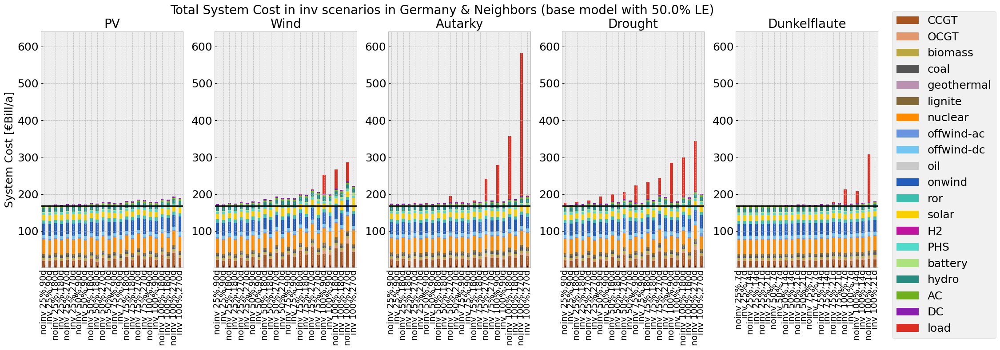

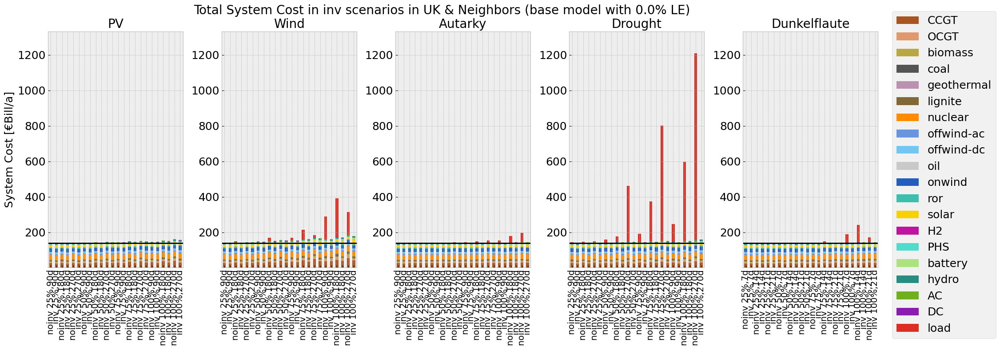

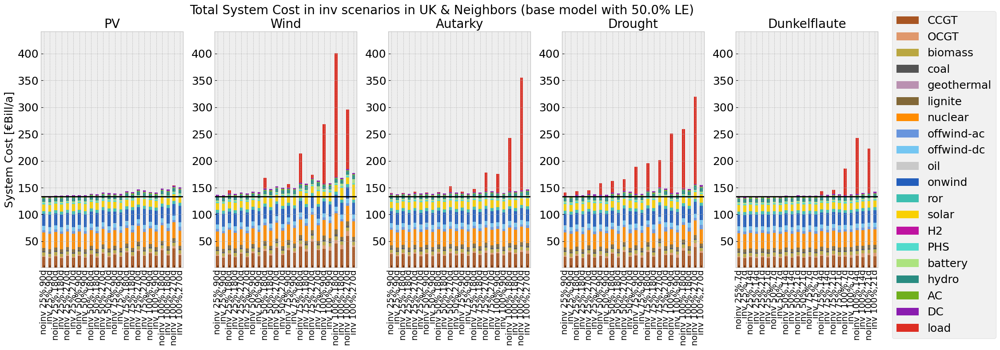

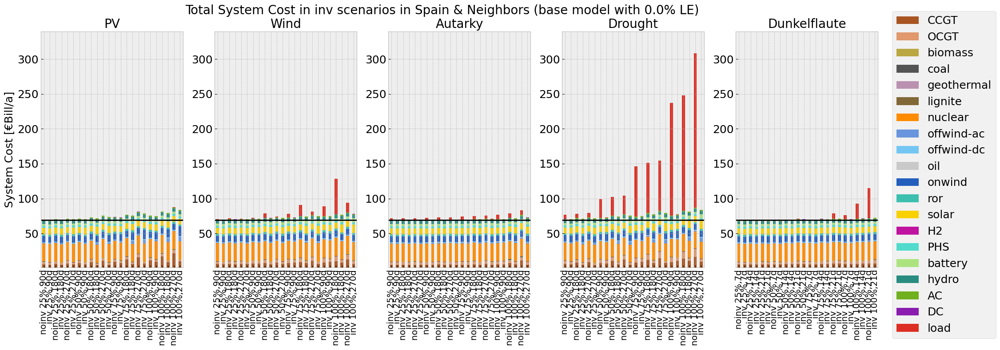

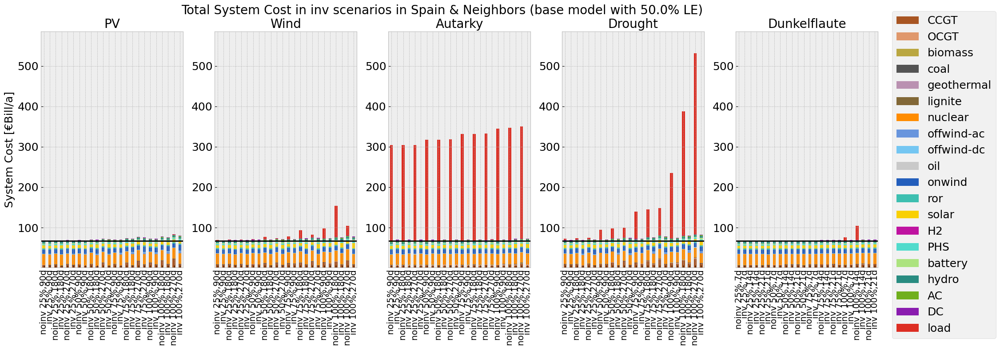

In [31]:
 # Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1


for country in countries.keys():

    for line, contingencies_el in element_to_ax.items():

        maxy=0
        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))
        #print(country)

        all_handles = []
        all_labels = []
        
        #create df and insert column base
        base_cap = globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_base_solved'].sum(axis = 1).rename('base')#_roll
        new_order = ['CCGT', 'OCGT', 'biomass', 'coal', 'geothermal', 'lignite', 'nuclear', 
             'offwind-ac', 'offwind-dc', 'oil', 'onwind', 'ror', 'solar', 'H2', 
             'PHS', 'battery', 'hydro', 'AC', 'DC', 'load']
        base_cap = base_cap.reindex(new_order)
        base_cost = base_cap.sum()

        base_capex = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_base_solved'].sum(axis = 1).rename('base')
        
        base_capex_sum = base_capex.sum()
        

        for contingency_el,ax in contingencies_el.items():

            globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = pd.DataFrame(base_cap)

            globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = pd.DataFrame(base_capex)
            
            #add load shedding if not available
            globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].loc['load','base'] = 0

            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['noinv','inv']:#'inv',

                        bus = countries[country]['bus']
                        mod_name = f'syscost_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'#roll
                        mod_name_capex = f'capex_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}'#roll
                        mod_cap = globals()[mod_name].sum(axis =1).rename(f'{mod} {int(-(reductionto-1)*100)}%,{duration}d').reindex(new_order)
                        mod_capex = globals()[mod_name_capex].sum(axis =1).rename(f'{mod} {int(-(reductionto-1)*100)}%,{duration}d')
                        #print(mod_name)
                        mod_df = pd.DataFrame(mod_cap)
                        mod_capex_df = pd.DataFrame(mod_capex)

                        globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = pd.concat([globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'], mod_df], axis = 1)

                        globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = pd.concat([globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'], mod_capex_df], axis = 1)

            
            globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].transpose()

            globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].transpose()

            sum = globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].sum(axis =1)

            if sum.max() > maxy:
                maxy=sum.max()
                   
        
        for contingency_el,ax in contingencies_el.items():
            ax_count = ax
            ax = axes[ax]

            ax.set_title(f'{contingency_el}', fontsize = 16)
            #ax.set_yscale('log')
            
            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('System Cost [€Bill/a]',size = 18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
        
            #plot
            globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'][1:].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
            ax.axhline(y=base_cost, color='black', linestyle='-')

            # Set the x-ticks and x-tick labels
            ax.tick_params(axis='x', rotation=90, labelsize = 14)
            ax.tick_params(axis='y', rotation=0, labelsize = 18)
            ax.set_ylim([1,maxy*1.1])
            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)
        
        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Add labels 
        #ax.set_ylabel('System Cost [€Bill/a]')

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        if country == 'DE':
            plt.suptitle(f'Total System Cost in inv scenarios in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Total System Cost in inv scenarios in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Total System Cost in inv scenarios in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5),prop={'size': 18})

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"tsc_{country}_{line}_noinvroll.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()
    

### Net saved cost for all countries 

In this subsection, for every scenario and country the net saved cost is calculated and will be presented in a scatter plot

In [32]:
#globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[reductionto, duration] = ((float(sumcost.loc[index_noinv])-float(sumcost.loc[index_inv])))/float(sumcost.loc['base'])*100

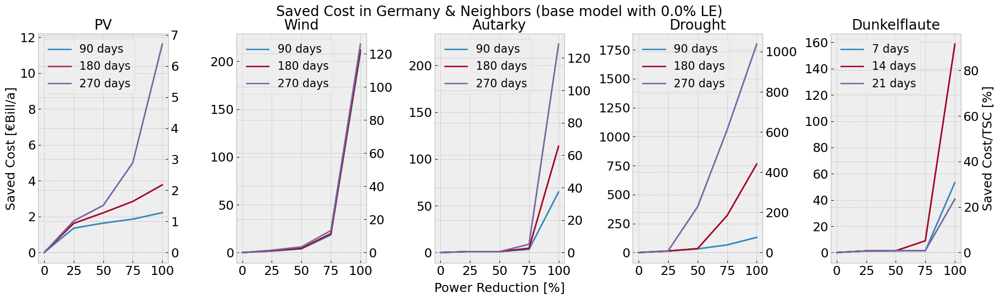

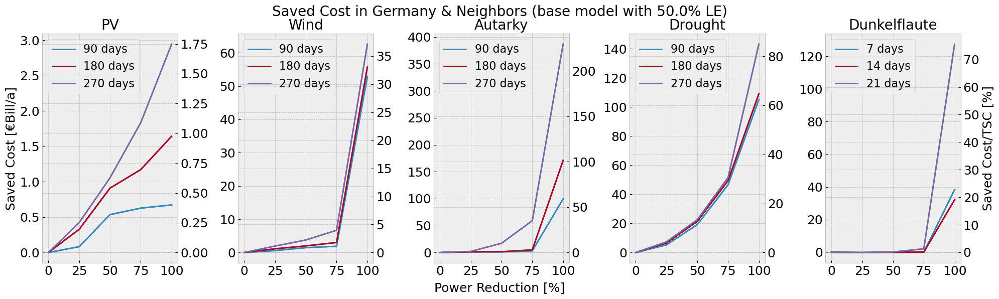

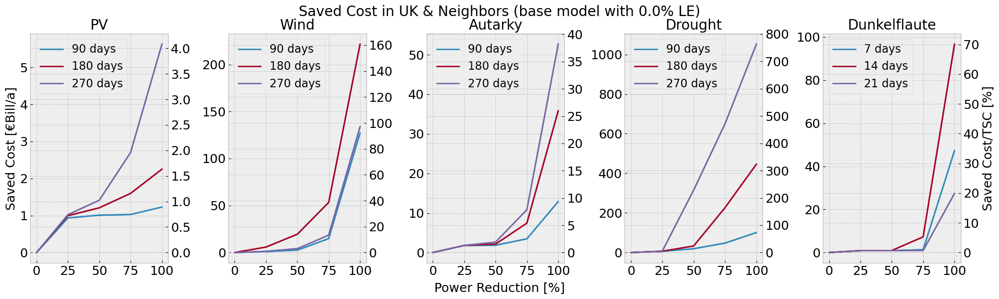

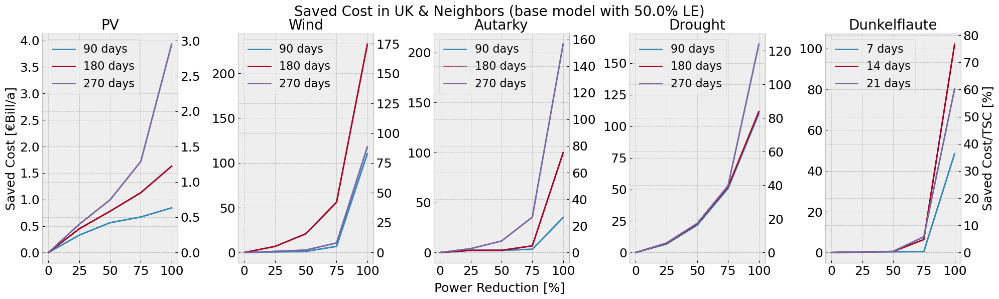

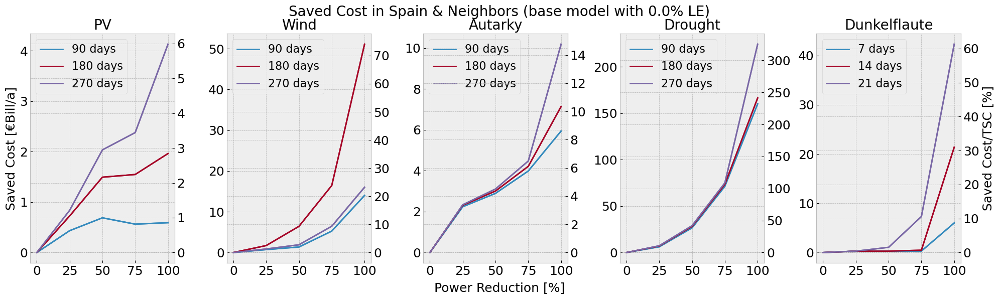

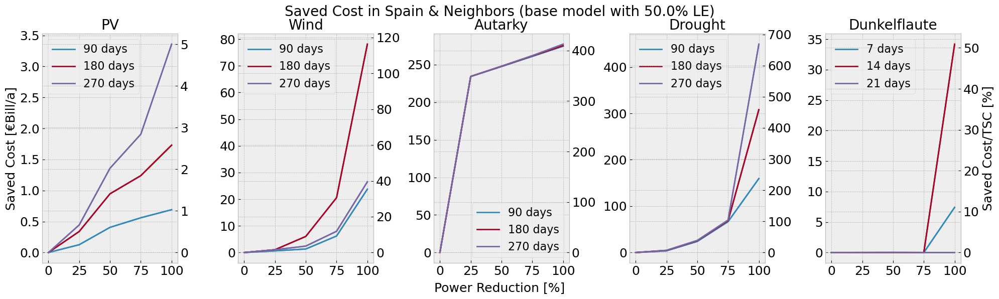

In [33]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy= 0

        maxyperc= 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 6))
        #print(country)

        all_handles = []
        all_labels = []
        
        #create df and insert column base
        base_cost = globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_base_solved']

        

        for contingency_el,ax in contingencies_el.items():

            sumcost = globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].sum(axis=1)

            sumcapex = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].sum(axis=1)

            #create net saved cost table
            globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = contingencies[contingency_el]['duration'], index = contingencies[contingency_el]['reductionto'])

            #create net saved cost/TSC base table
            globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = contingencies[contingency_el]['duration'], index = contingencies[contingency_el]['reductionto'])
            
            #create add capex table
            globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = contingencies[contingency_el]['duration'], index = contingencies[contingency_el]['reductionto'])

            globals()[f'net_saved_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = ['SC'])

            globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = ['add_capex'])

            for reductionto in contingencies[contingency_el]['reductionto']:

                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    index = f'{int(-(reductionto-1)*100)}%,{duration}d'
                    index_inv = f'inv {int(-(reductionto-1)*100)}%,{duration}d'
                    index_noinv = f'noinv {int(-(reductionto-1)*100)}%,{duration}d'

                    globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[reductionto, duration] = (float(sumcost.loc[index_noinv])-float(sumcost.loc[index_inv]))
                    globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[reductionto, duration] = ((float(sumcost.loc[index_noinv])-float(sumcost.loc[index_inv])))/float(sumcost.loc['base'])*100
                    globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[reductionto, duration] = (float(sumcapex.loc[index_inv])-float(sumcapex.loc[index_noinv]))

                    globals()[f'net_saved_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[index] = (float(sumcost.loc[index_noinv])-float(sumcost.loc[index_inv]))

                    globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[index] = (float(sumcapex.loc[index_inv])-float(sumcapex.loc[index_noinv]))


            
            new_index = [int(-(red-1)*100) for red in contingencies[contingency_el]['reductionto']]
            globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index = new_index
            globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index = new_index
            globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index = new_index

            if globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max().max() > maxy:
                maxy = globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max().max()

            if globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max().max() > maxyperc:
                maxyperc = globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max().max()
            
            # Create a new DataFrame with the first row of zeros
            new_row = pd.DataFrame([[0, 0, 0]], columns=globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].columns, index=[0])

            globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.concat([new_row,globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}']])
            globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.concat([new_row,globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}']])
            globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.concat([new_row,globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}']])

        for contingency_el,ax in contingencies_el.items():

            #add ylabel
            ax_count = ax
            ax = axes[ax]
            if ax_count == 0:
                ax.set_ylabel('Saved Cost [€Bill/a]',size = 18)
            
            
            ax.set_title(f'{contingency_el}', fontsize = 16)
            
            ax2 = ax.twinx()

            if ax_count == 4:
                ax2.set_ylabel('Saved Cost/TSC [%]',size = 18)

            globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].plot(ax =ax, legend =False)

            globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].plot(ax =ax2, legend =False, alpha = 1)


            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
    
            #ax.set_ylim([0,maxy*1.1])
            #ax2.set_ylim([0,maxyperc*1.1])

            #print(maxy,maxyperc)
            
            ax.tick_params(axis='x', labelsize=18)
            ax.tick_params(axis='y', labelsize=18)
            ax2.tick_params(axis='y', labelsize=18)
            ax.set_xticks([0, 25, 50, 75, 100])

            # Collect handles and labels
            handles,_= ax.get_legend_handles_labels()
            labels = [f"{col} days" for col in globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].columns]
            ax.legend(handles, labels, fontsize = 16)#

        #plt.tight_layout(rect=[0, 0, 0.96, 0.96])  # Leave space for the suptitle
        #plt.tight_layout(rect=[0.05, 0.05, 1, 0.95])
        plt.tight_layout(rect=[0, 0.05, 1, 0.96])

        if country == 'DE':
            plt.suptitle(f'Saved Cost in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Saved Cost in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Saved Cost in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        
        fig.text(0.5, 0.04, 'Power Reduction [%]', ha='center', va='center', fontsize = 18)

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"sc_{country}_{line}_roll.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

### Saved cost vs additional capex

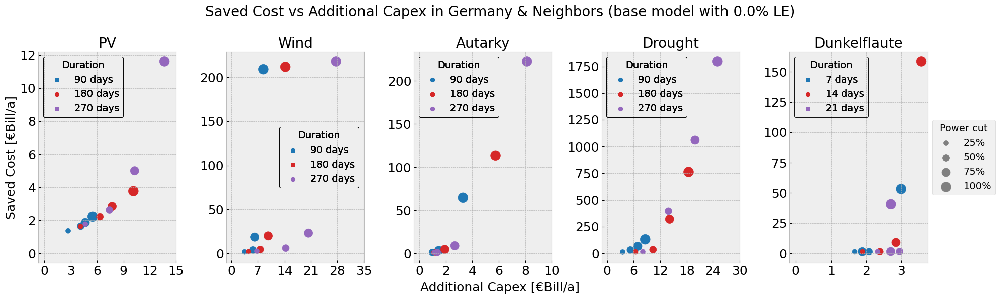

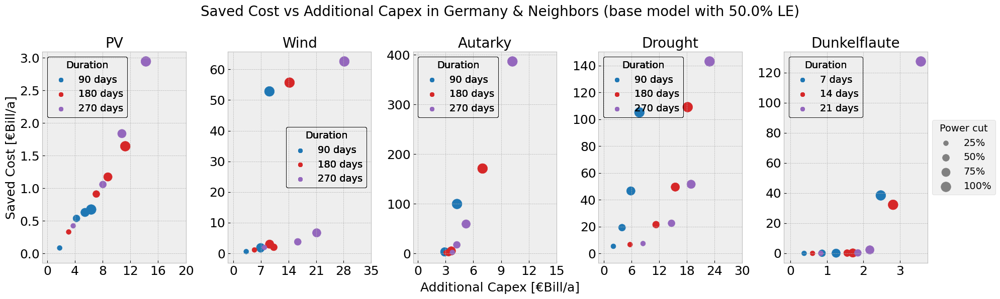

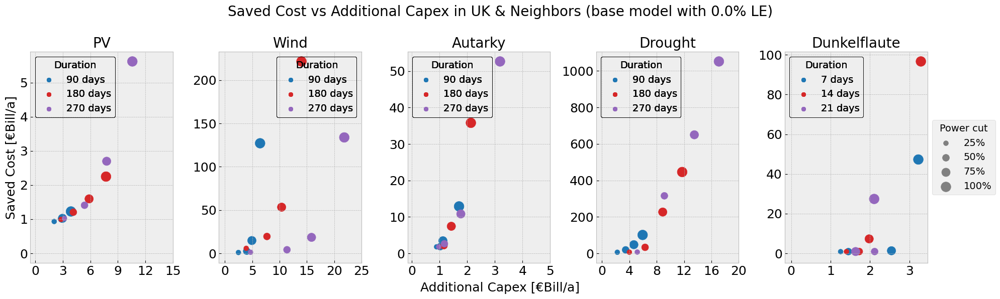

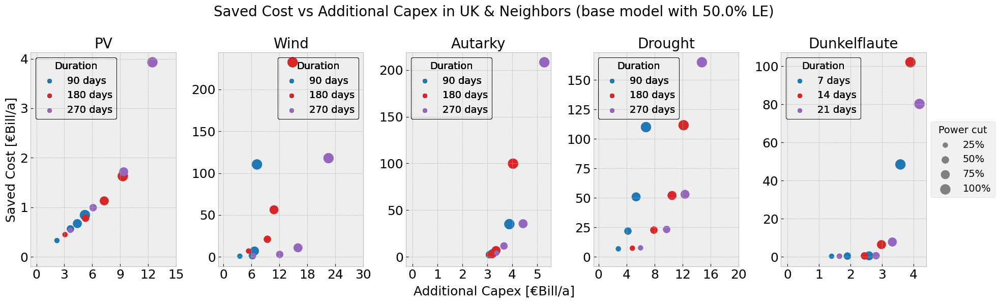

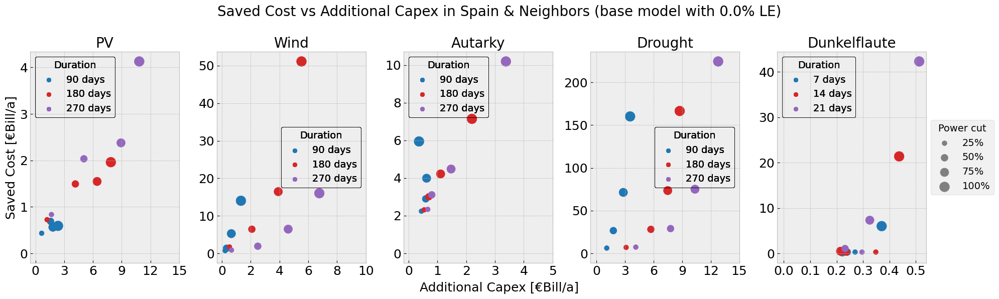

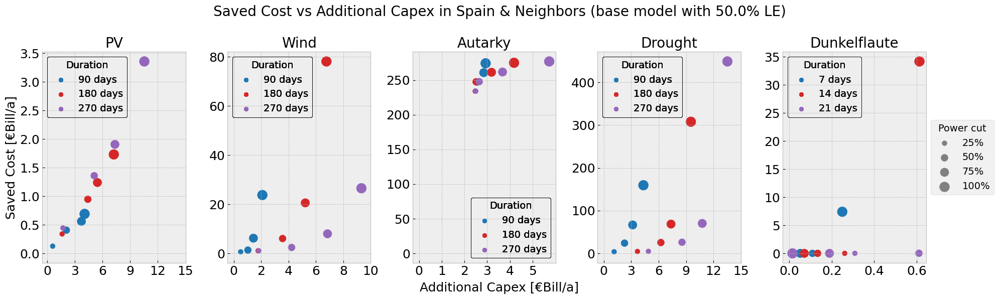

In [34]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

#markers = ['o', 's', '^']

for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy= 0
        maxx = 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 6))

        all_handles = []
        all_labels = []

        for contingency_el,ax in contingencies_el.items():

            #add ylabel
            ax_count = ax
            ax = axes[ax]
            if ax_count == 0:
                ax.set_ylabel('Saved Cost [€Bill/a]', size =18)
            
            
            
            ax.set_title(f'{contingency_el}', fontsize = 16)


            globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.concat([globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'],globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}']],axis =1)

            contingencyname = contingencies[contingency_el]['duration']
            globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].columns = [f'saved cost {contingencyname[0]}d', f'saved cost {contingencyname[1]}d', f'saved cost {contingencyname[2]}d',f'add capex {contingencyname[0]}d', f'add capex {contingencyname[1]}d', f'add capex {contingencyname[2]}d']

            # Colors for different durations
            colors = ['#1f77b4', '#d62728', '#9467bd']   

            for duration,color in zip(contingencies[contingency_el]['duration'],colors):


                #ax.plot(globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'add capex {duration}d'], globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'saved cost {duration}d'], label=f'{duration} days')#,s= globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index*3
                ax.scatter(globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'add capex {duration}d'], globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'saved cost {duration}d'],s= globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index*2, c = color, label=f'{duration} days')#, 

            if globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].filter(like='saved',axis=1).max().max() > maxy:
                maxy = globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].filter(like='saved',axis=1).max().max()
            
            if globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].filter(like='add',axis=1).max().max() > maxx:
                maxx = globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].filter(like='add',axis=1).max().max()


            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            #print(maxy,maxx)
            
            ax.tick_params(axis='x', labelsize=12)
            #ax.set_xticks([0, 25, 50, 75, 100])

            # Collect handles and labels
            handles,_= ax.get_legend_handles_labels()
            labels = [f"{col} days" for col in globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].columns]
            ax.legend(handles, labels, fontsize = 16)#, loc='center left', bbox_to_anchor=(-0.95, 1)

        for contingency_el,ax in contingencies_el.items():
            #add ylabel
            ax_count = ax
            ax = axes[ax]

            ax.tick_params(axis='x', labelsize=18)
            ax.tick_params(axis='y', labelsize=18)

            for duration in contingencies[contingency_el]['duration']:

                
                
                if round((globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'add capex {duration}d'].max()-0)/4,0) < 1:
                    x_distance = round((globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'add capex {duration}d'].max()-0)/4,1)
                else:
                    x_distance = round((globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'add capex {duration}d'].max()-0)/4,0)
                ax.set_xticks([0, 1*x_distance, 2*x_distance, 3*x_distance, 4*x_distance, 5*x_distance])

                color_legend_handles = [plt.scatter([], [], c=color) for color in colors]
                color_legend_labels = [f'{i} days' for i in contingencies[contingency_el]['duration']]
                color_legend = ax.legend(color_legend_handles, color_legend_labels, title='Duration', prop={'size': 14})#, loc='upper right'
                color_legend.set_title('Duration', prop={'size': 14})
                color_legend.get_frame().set_edgecolor('black')
                color_legend.get_frame().set_facecolor('none')  
                
                ax.add_artist(color_legend)

            #ax.set_ylim([-20,maxy*1.1])
            #ax.set_xlim([0,maxx*1.1])

        #plt.tight_layout(rect=[0, 0, 0.96, 0.96])  # Leave space for the suptitle
        # Create a legend for the bubble sizes
        size_legend_handles = [plt.scatter([], [], s=size, c='gray') for size in globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index[1:]*2]
        size_legend_labels = ['25%', '50%', '75%','100%']
        size_legend = ax.legend(size_legend_handles, size_legend_labels, bbox_to_anchor=(1,0.5),prop={'size': 14}, loc='center left', title='Power cut')
        size_legend.set_title('Power cut', prop={'size': 14})
        #ax.add_artist(size_legend)
        
        
        plt.tight_layout(rect=[0, 0.05, 1, 0.9])

        if country == 'DE':
            plt.suptitle(f'Saved Cost vs Additional Capex in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Saved Cost vs Additional Capex in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Saved Cost vs Additional Capex in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        
        fig.text(0.5, 0.04, 'Additional Capex [€Bill/a]', ha='center', va='center', fontsize = 18)

        #plt.set_title('')
        # Save plot to the current working directory
        filename = f"capex_sc_{country}_{line}.png"
        output_path = os.path.join(os.getcwd(), filename)
        plt.savefig(output_path)

        plt.show()

        

# Create a legend for the colors


### SC/capex_add

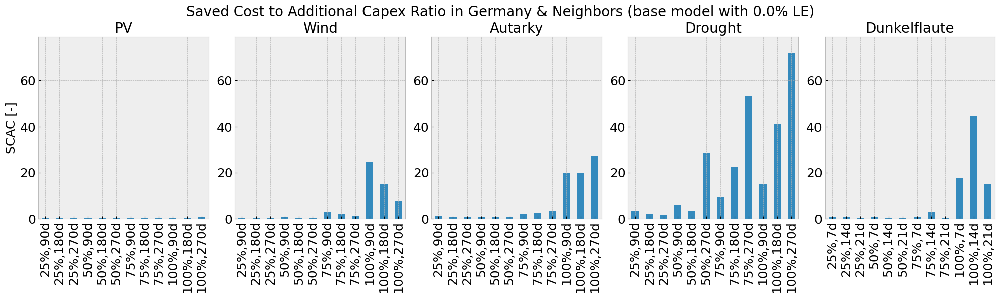

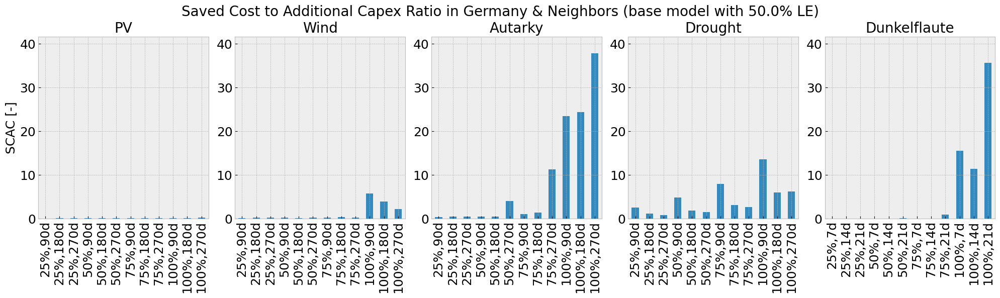

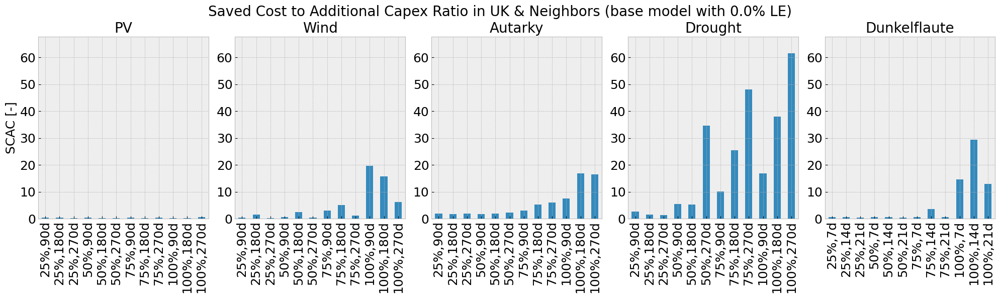

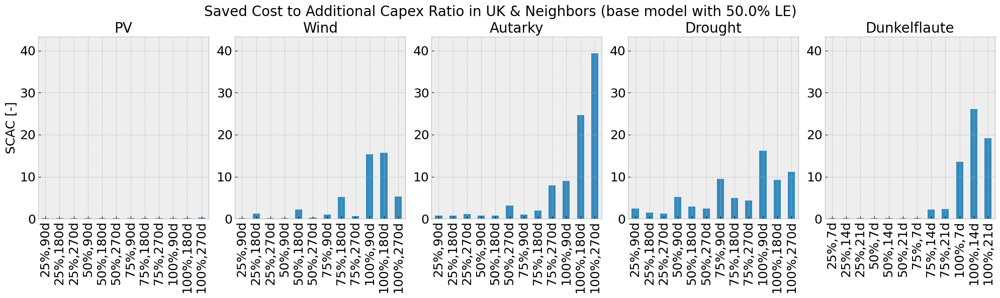

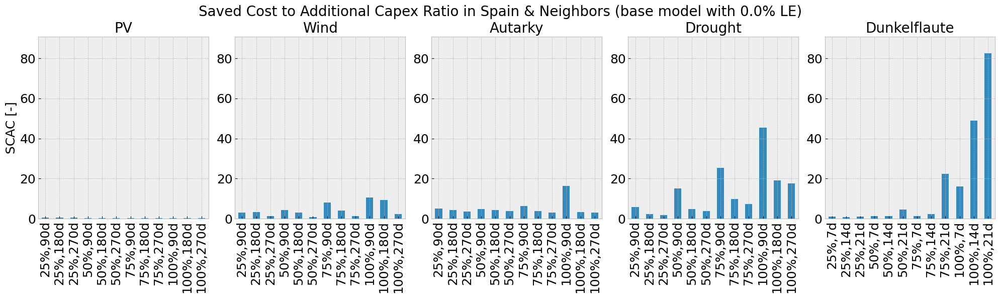

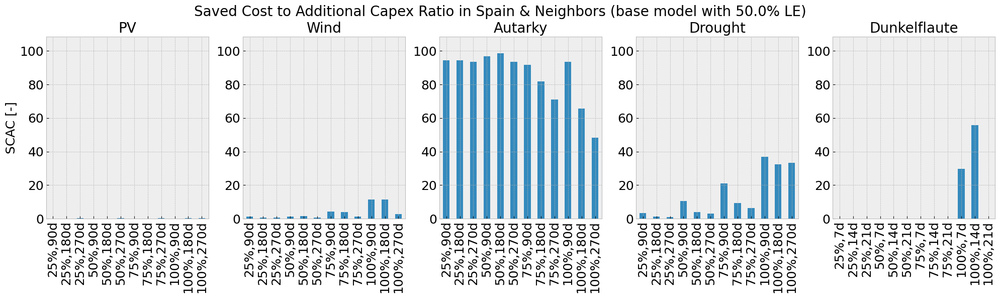

In [35]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1


for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy= 0
        maxx = 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 6))

        all_handles = []
        all_labels = []

        for contingency_el,ax in contingencies_el.items():

            #add ylabel
            ax_count = ax
            ax = axes[ax]
            if ax_count == 0:
                ax.set_ylabel('SCAC [-]', size =18) #saved cost to additional capex ratio
            
            
            
            ax.set_title(f'{contingency_el}', fontsize = 16)


            globals()[f'scac_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = globals()[f'net_saved_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['SC']/globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['add_capex']

            globals()[f'scac_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].plot(kind = 'bar', ax=ax, legend = False)
            
            if globals()[f'scac_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max() > maxy:
                maxy = globals()[f'scac_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max()

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            y_dist = ((globals()[f'scac_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']).max()/5)
            #print(maxy,maxx)
            
            #ax.tick_params(axis='x', labelsize=12)
            #ax.set_yticks([0, 1*y_dist, 2*y_dist, 3*y_dist, 4*y_dist, 5*y_dist])

            # Collect handles and labels
            handles,_= ax.get_legend_handles_labels()
            labels = [f"{col} days" for col in globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].columns]
            #ax.legend(handles, labels, fontsize = 16)#, loc='center left', bbox_to_anchor=(-0.95, 1)
             # Add text above bars

        for contingency_el,ax in contingencies_el.items():
            #add ylabel
            ax_count = ax
            ax = axes[ax]

            ax.tick_params(axis='x', labelsize=18)
            ax.tick_params(axis='y', labelsize=18)
            ax.set_ylim([0,maxy*1.1])
         
        
        
        plt.tight_layout(rect=[0, 0, 1, 0.95])

        if country == 'DE':
            plt.suptitle(f'Saved Cost to Additional Capex Ratio in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Saved Cost to Additional Capex Ratio in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Saved Cost to Additional Capex Ratio in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        
        #fig.text(0.5, 0.04, 'Additional Capex [€Bill/a]', ha='center', va='center', fontsize = 18)

        #plt.set_title('')
        # Save plot to the current working directory
        filename = f"scac_{country}_{line}_roll.png"
        output_path = os.path.join(os.getcwd(), filename)
        plt.savefig(output_path)

        plt.show()

        

# Create a legend for the colors

### Additional capex components

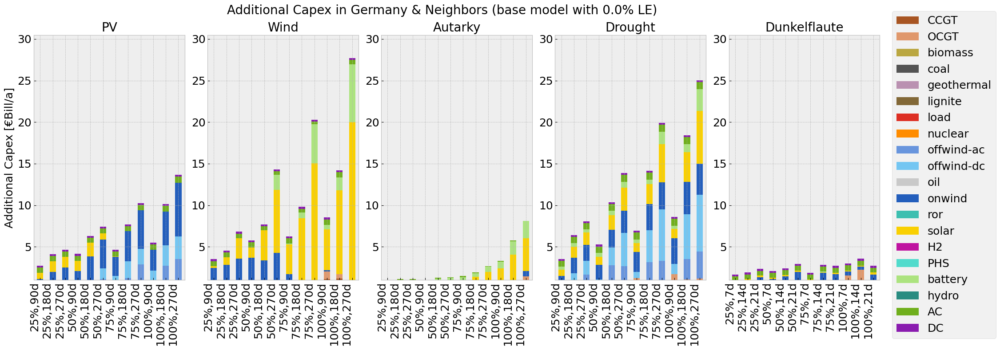

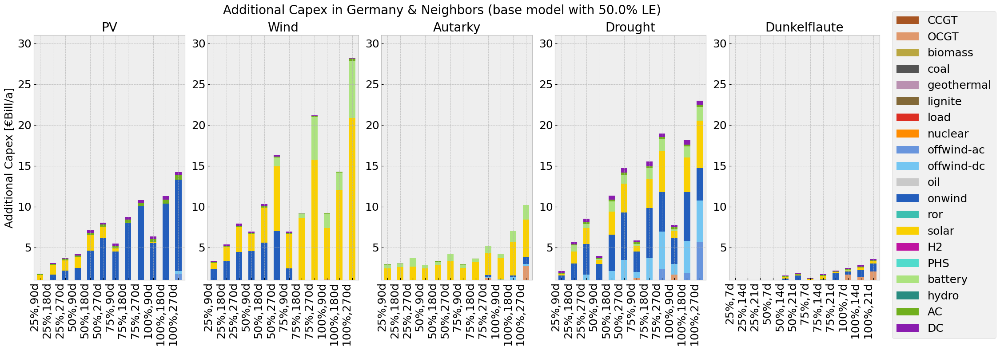

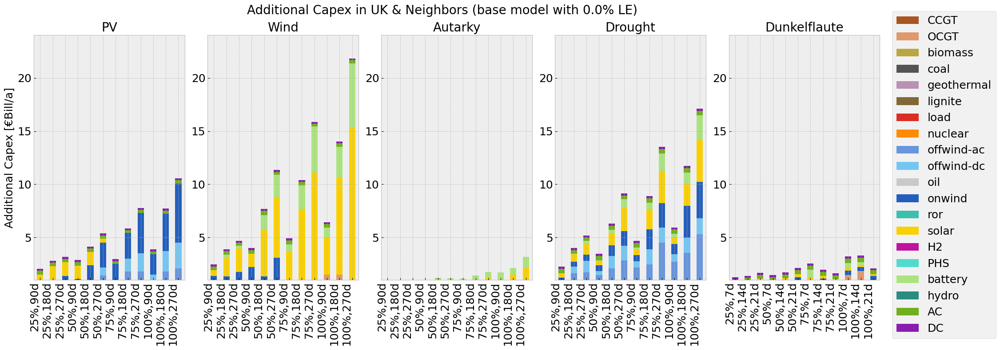

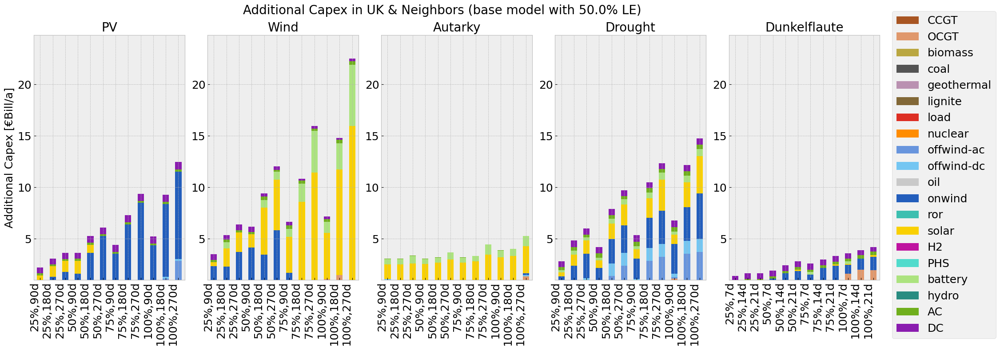

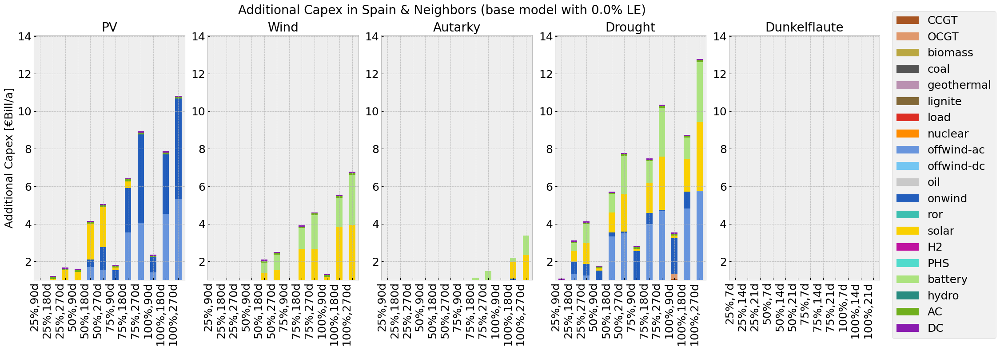

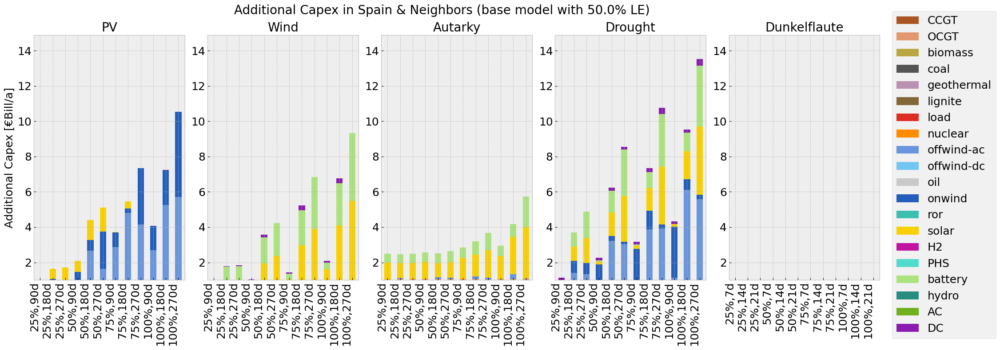

In [36]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy = 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))
        #print(country)

        all_handles = []
        all_labels = []
        
        #create df and insert column base
        base_capex = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_base_solved']
        
        globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}'] = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].sum(axis=1)

        for contingency_el,ax in contingencies_el.items():

            globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].columns, 
                                                                                                                  index = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].index)
            

            for reductionto in contingencies[contingency_el]['reductionto']:

                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    index = f'{int(-(reductionto-1)*100)}%,{duration}d'
                    index_inv = f'inv {int(-(reductionto-1)*100)}%,{duration}d'
                    index_noinv = f'noinv {int(-(reductionto-1)*100)}%,{duration}d'

                    globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[index] = (globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].loc[index_inv]-globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].loc[index_noinv])

            globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add capex'] = globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].sum(axis = 1)

            if globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add capex'].max() > maxy:
                maxy = globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add capex'].max()

        for contingency_el,ax in contingencies_el.items():
            #add ylabel
            ax_count = ax
            ax = axes[ax]
            if ax_count == 0:
                ax.set_ylabel('Additional Capex [€Bill/a]', size =18)
            
            ax.set_title(f'{contingency_el}', fontsize = 16)
            ax.set_ylim([1,maxy*1.1])
            
            globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].iloc[1:,:-1].plot(kind='bar', stacked=True, ax =ax, legend =False, color = color_map)
            #net_saved_cost = globals()[f'net_saved_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].iloc[1:,-1].plot(kind='line', ax =ax,color = 'k', marker = 'o')

            # Rotate xticks for better readability
            ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha='right')
            
            #set font size
            ax.tick_params(axis='x', labelsize=18)
            ax.tick_params(axis='y', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)

        plt.tight_layout(rect=[0, 0, 1, 0.95])  # Leave space for the suptitle

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size':18})

        
    
        if country == 'DE':
            plt.suptitle(f'Additional Capex in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Additional Capex in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Additional Capex in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)

        #plt.set_title('')
        # Save plot to the current working directory
        filename = f"add_capex_{country}_{line}.png"
        output_path = os.path.join(os.getcwd(), filename)
        plt.savefig(output_path, bbox_inches='tight')

        plt.show()

## rolling horizon foresight

### System cost all countries 

In this section the system cost of the neighboring countries are also included in the plots

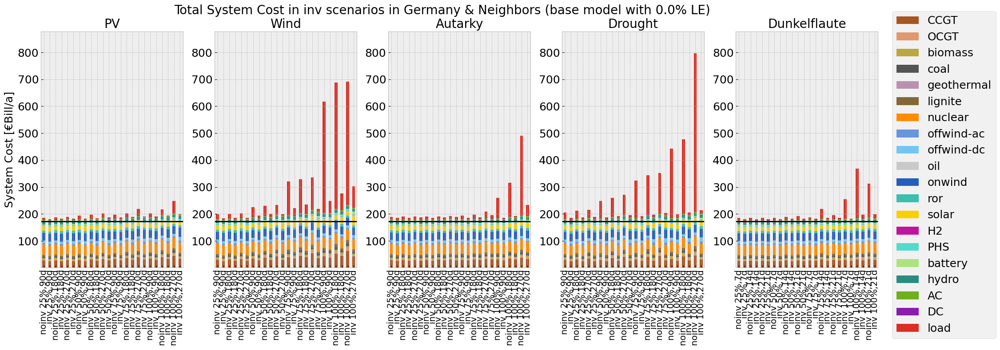

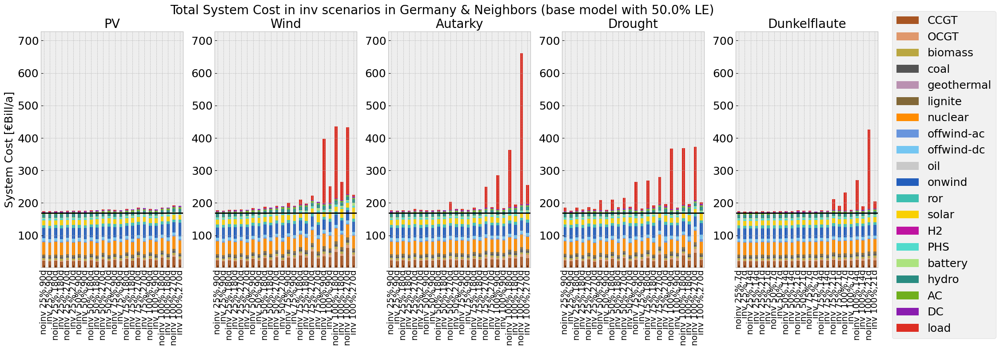

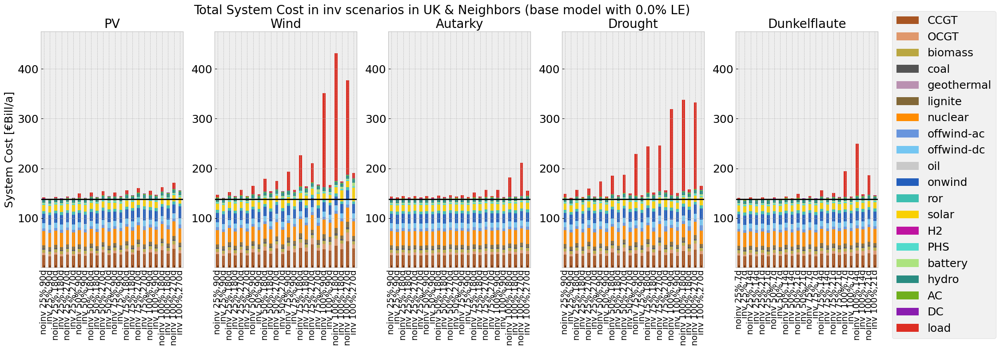

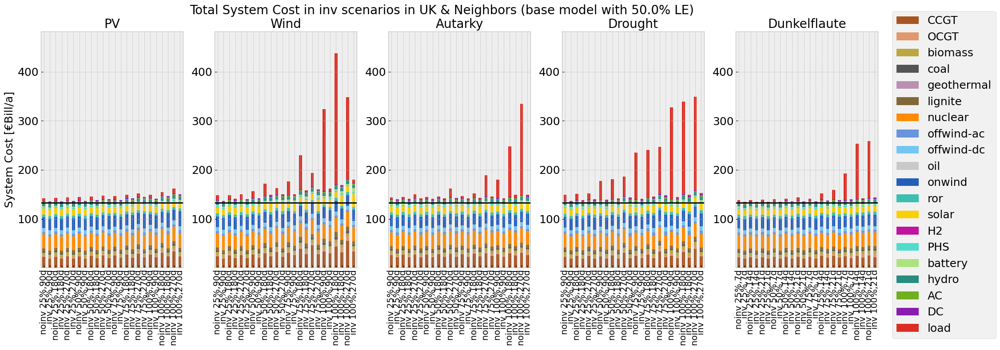

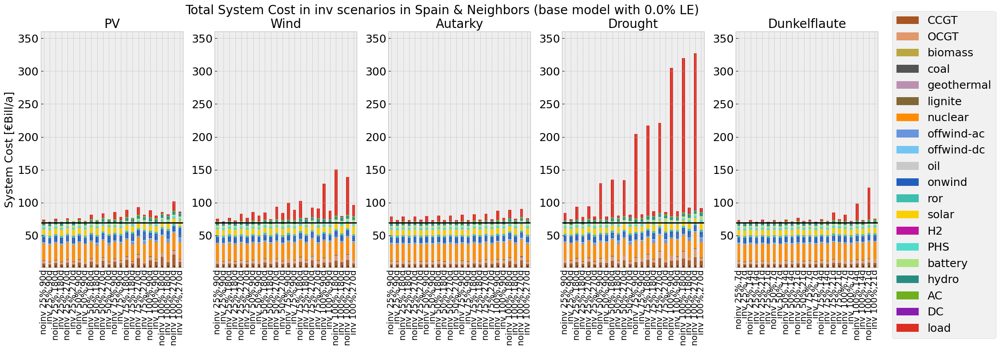

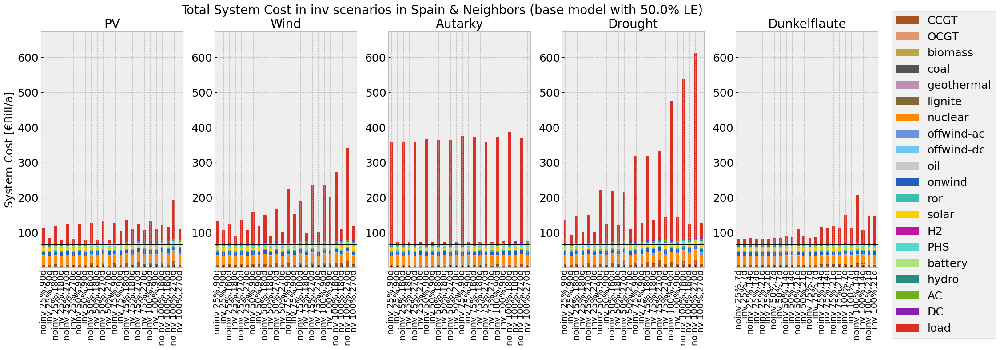

In [37]:
 # Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1


for country in countries.keys():

    for line, contingencies_el in element_to_ax.items():

        maxy=0
        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))
        #print(country)

        all_handles = []
        all_labels = []
        
        #create df and insert column base
        base_cap = globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_base_solved'].sum(axis = 1).rename('base')#_roll
        new_order = ['CCGT', 'OCGT', 'biomass', 'coal', 'geothermal', 'lignite', 'nuclear', 
             'offwind-ac', 'offwind-dc', 'oil', 'onwind', 'ror', 'solar', 'H2', 
             'PHS', 'battery', 'hydro', 'AC', 'DC', 'load']
        base_cap = base_cap.reindex(new_order)
        base_cost = base_cap.sum()

        base_capex = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_base_solved'].sum(axis = 1).rename('base')
        
        base_capex_sum = base_capex.sum()
        

        for contingency_el,ax in contingencies_el.items():

            globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = pd.DataFrame(base_cap)

            globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = pd.DataFrame(base_capex)
            
            #add load shedding if not available
            globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].loc['load','base'] = 0

            for reductionto in contingencies[contingency_el]['reductionto']:
                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    for mod in ['noinv','inv']:#'inv',

                        bus = countries[country]['bus']
                        mod_name = f'syscost_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}roll'#roll
                        mod_name_capex = f'capex_{contingency_el}_{country}_{bus}_{sanitize_variable_name(str(line))}_{san_reductionto}_{duration}_{mod}roll'#roll
                        mod_cap = globals()[mod_name].sum(axis =1).rename(f'{mod} {int(-(reductionto-1)*100)}%,{duration}d').reindex(new_order)
                        mod_capex = globals()[mod_name_capex].sum(axis =1).rename(f'{mod} {int(-(reductionto-1)*100)}%,{duration}d')
                        #print(mod_name)
                        mod_df = pd.DataFrame(mod_cap)
                        mod_capex_df = pd.DataFrame(mod_capex)

                        globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = pd.concat([globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'], mod_df], axis = 1)

                        globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = pd.concat([globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'], mod_capex_df], axis = 1)

            
            globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].transpose()

            globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'] = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].transpose()

            sum = globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].sum(axis =1)

            if sum.max() > maxy:
                maxy=sum.max()
                   
        
        for contingency_el,ax in contingencies_el.items():
            ax_count = ax
            ax = axes[ax]

            ax.set_title(f'{contingency_el}', fontsize = 16)
            #ax.set_yscale('log')
            
            #add ylabel
            if ax_count == 0:
                ax.set_ylabel('System Cost [€Bill/a]',size = 18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
        
            #plot
            globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'][1:].plot(kind='bar', stacked=True, ax =ax, color = color_map, legend =False)
            ax.axhline(y=base_cost, color='black', linestyle='-')

            # Set the x-ticks and x-tick labels
            ax.tick_params(axis='x', rotation=90, labelsize = 14)
            ax.tick_params(axis='y', rotation=0, labelsize = 18)
            ax.set_ylim([1,maxy*1.1])
            #ax.set_xticks(globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_inv_df'].index)
        
        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Add labels 
        #ax.set_ylabel('System Cost [€Bill/a]')

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        #fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5))

        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for the suptitle
    
        if country == 'DE':
            plt.suptitle(f'Total System Cost in inv scenarios in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Total System Cost in inv scenarios in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Total System Cost in inv scenarios in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5),prop={'size': 18})

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"tsc_{country}_{line}_noinvroll.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()
    

### Net saved cost for all countries 

In this subsection, for every scenario and country the net saved cost is calculated and will be presented in a scatter plot

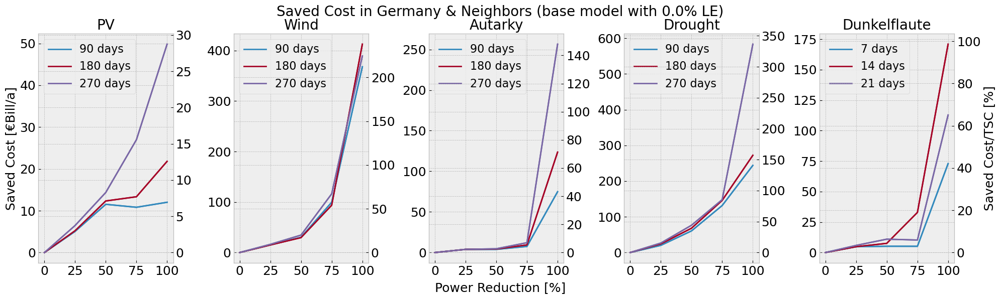

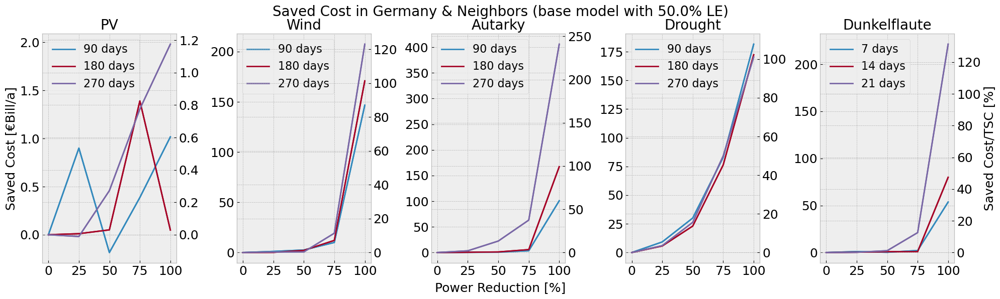

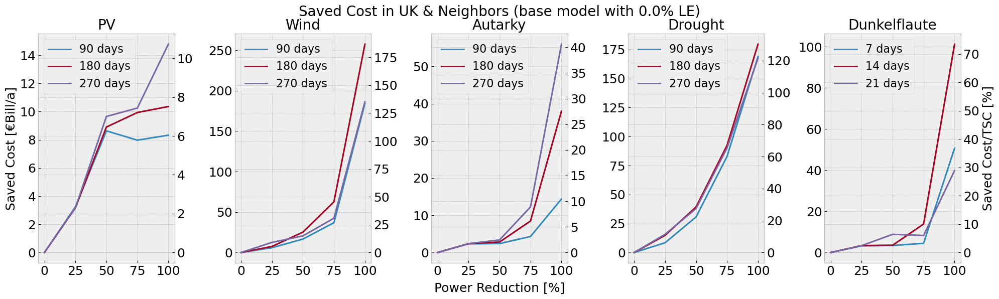

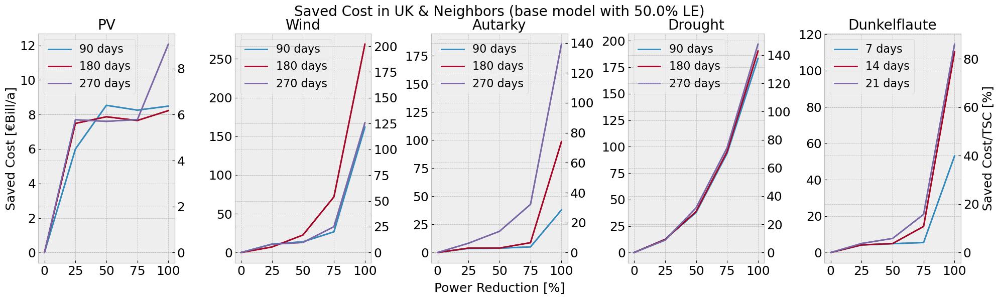

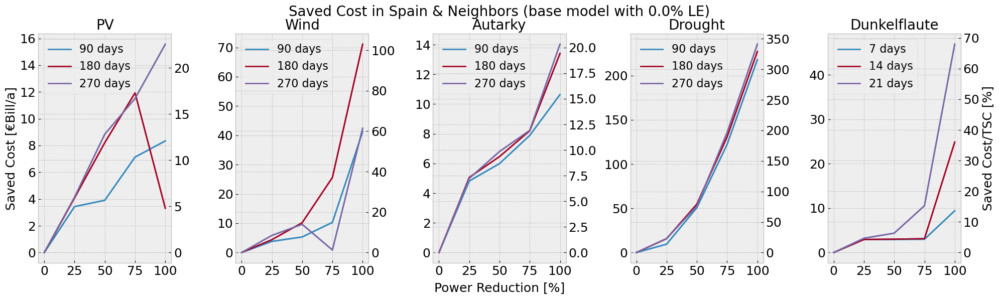

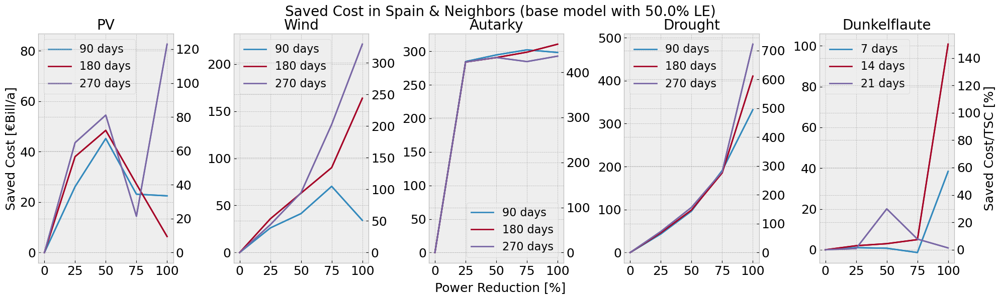

In [38]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy= 0

        maxyperc= 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 6))
        #print(country)

        all_handles = []
        all_labels = []
        
        #create df and insert column base
        base_cost = globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_base_solved']

        

        for contingency_el,ax in contingencies_el.items():

            sumcost = globals()[f'syscost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].sum(axis=1)

            sumcapex = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].sum(axis=1)

            #create net saved cost table
            globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = contingencies[contingency_el]['duration'], index = contingencies[contingency_el]['reductionto'])

            #create net saved cost/TSC base table
            globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = contingencies[contingency_el]['duration'], index = contingencies[contingency_el]['reductionto'])
            
            #create add capex table
            globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = contingencies[contingency_el]['duration'], index = contingencies[contingency_el]['reductionto'])

            globals()[f'net_saved_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = ['SC'])

            globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = ['add_capex'])

            for reductionto in contingencies[contingency_el]['reductionto']:

                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    index = f'{int(-(reductionto-1)*100)}%,{duration}d'
                    index_inv = f'inv {int(-(reductionto-1)*100)}%,{duration}d'
                    index_noinv = f'noinv {int(-(reductionto-1)*100)}%,{duration}d'

                    globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[reductionto, duration] = (float(sumcost.loc[index_noinv])-float(sumcost.loc[index_inv]))
                    globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[reductionto, duration] = ((float(sumcost.loc[index_noinv])-float(sumcost.loc[index_inv])))/float(sumcost.loc['base'])*100
                    globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[reductionto, duration] = (float(sumcapex.loc[index_inv])-float(sumcapex.loc[index_noinv]))

                    globals()[f'net_saved_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[index] = (float(sumcost.loc[index_noinv])-float(sumcost.loc[index_inv]))

                    globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[index] = (float(sumcapex.loc[index_inv])-float(sumcapex.loc[index_noinv]))


            
            new_index = [int(-(red-1)*100) for red in contingencies[contingency_el]['reductionto']]
            globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index = new_index
            globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index = new_index
            globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index = new_index

            if globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max().max() > maxy:
                maxy = globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max().max()

            if globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max().max() > maxyperc:
                maxyperc = globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max().max()
            
            # Create a new DataFrame with the first row of zeros
            new_row = pd.DataFrame([[0, 0, 0]], columns=globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].columns, index=[0])

            globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.concat([new_row,globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}']])
            globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.concat([new_row,globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}']])
            globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.concat([new_row,globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}']])

        for contingency_el,ax in contingencies_el.items():

            #add ylabel
            ax_count = ax
            ax = axes[ax]
            if ax_count == 0:
                ax.set_ylabel('Saved Cost [€Bill/a]',size = 18)
            
            
            ax.set_title(f'{contingency_el}', fontsize = 16)
            
            ax2 = ax.twinx()

            if ax_count == 4:
                ax2.set_ylabel('Saved Cost/TSC [%]',size = 18)

            globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].plot(ax =ax, legend =False)

            globals()[f'net_saved_perc{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].plot(ax =ax2, legend =False, alpha = 1)


            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
    
            #ax.set_ylim([0,maxy*1.1])
            #ax2.set_ylim([0,maxyperc*1.1])

            #print(maxy,maxyperc)
            
            ax.tick_params(axis='x', labelsize=18)
            ax.tick_params(axis='y', labelsize=18)
            ax2.tick_params(axis='y', labelsize=18)
            ax.set_xticks([0, 25, 50, 75, 100])

            # Collect handles and labels
            handles,_= ax.get_legend_handles_labels()
            labels = [f"{col} days" for col in globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].columns]
            ax.legend(handles, labels, fontsize = 16)#

        #plt.tight_layout(rect=[0, 0, 0.96, 0.96])  # Leave space for the suptitle
        #plt.tight_layout(rect=[0.05, 0.05, 1, 0.95])
        plt.tight_layout(rect=[0, 0.05, 1, 0.96])

        if country == 'DE':
            plt.suptitle(f'Saved Cost in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Saved Cost in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Saved Cost in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        
        fig.text(0.5, 0.04, 'Power Reduction [%]', ha='center', va='center', fontsize = 18)

        #plt.set_title('')
        # Save plot to the current working directory
        #filename = f"sc_{country}_{line}_roll.png"
        #output_path = os.path.join(os.getcwd(), filename)
        #plt.savefig(output_path)

        plt.show()

In [39]:
net_saved_sumDE_1_0_pv

,90,180,270
0,0,0,0
25,5.055176,5.214874,6.464048
50,11.530573,12.330729,14.359915
75,10.820797,13.338486,26.976213
100,12.020232,21.805998,49.817108


### Saved cost vs additional capex

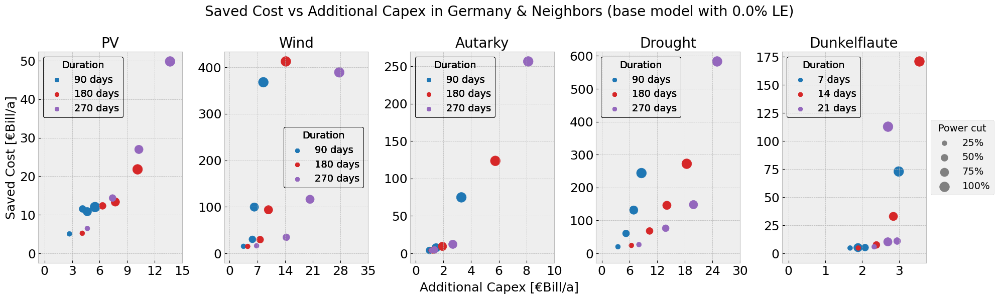

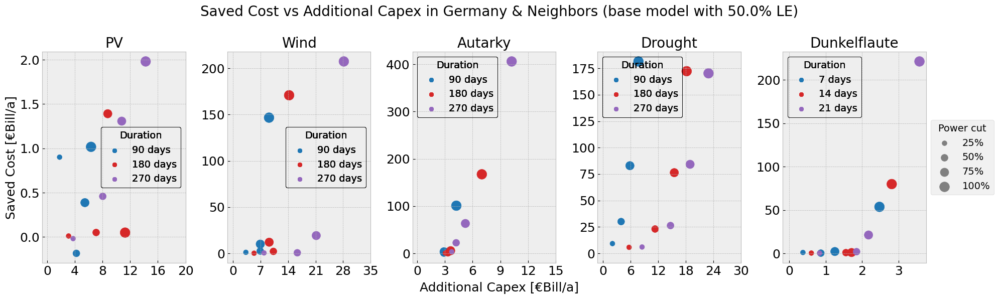

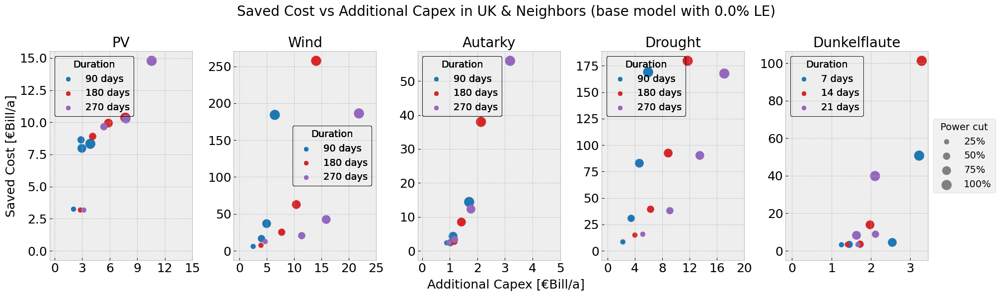

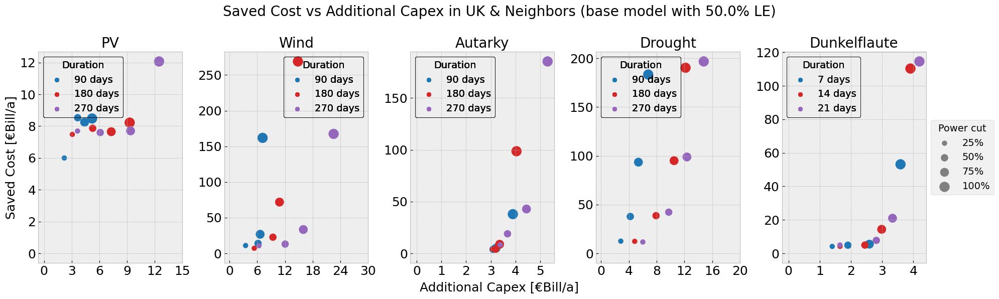

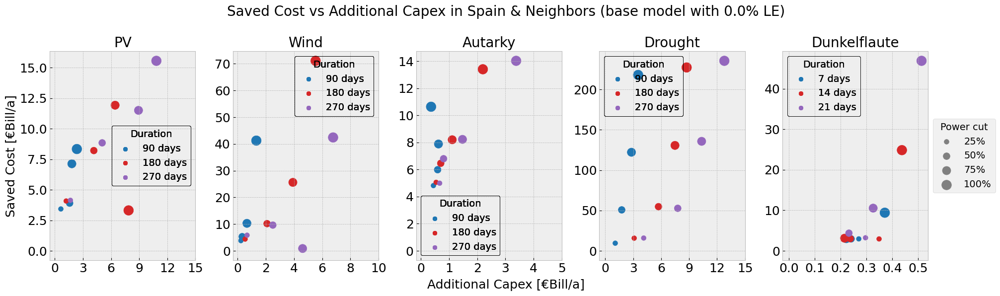

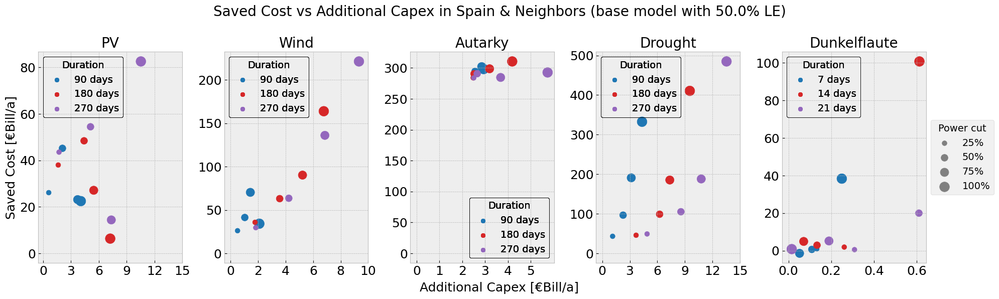

In [40]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

#markers = ['o', 's', '^']

for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy= 0
        maxx = 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 6))

        all_handles = []
        all_labels = []

        for contingency_el,ax in contingencies_el.items():

            #add ylabel
            ax_count = ax
            ax = axes[ax]
            if ax_count == 0:
                ax.set_ylabel('Saved Cost [€Bill/a]', size =18)
            
            
            
            ax.set_title(f'{contingency_el}', fontsize = 16)


            globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.concat([globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'],globals()[f'add_capex_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}']],axis =1)

            contingencyname = contingencies[contingency_el]['duration']
            globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].columns = [f'saved cost {contingencyname[0]}d', f'saved cost {contingencyname[1]}d', f'saved cost {contingencyname[2]}d',f'add capex {contingencyname[0]}d', f'add capex {contingencyname[1]}d', f'add capex {contingencyname[2]}d']

            # Colors for different durations
            colors = ['#1f77b4', '#d62728', '#9467bd']   

            for duration,color in zip(contingencies[contingency_el]['duration'],colors):


                #ax.plot(globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'add capex {duration}d'], globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'saved cost {duration}d'], label=f'{duration} days')#,s= globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index*3
                ax.scatter(globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'add capex {duration}d'], globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'saved cost {duration}d'],s= globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index*2, c = color, label=f'{duration} days')#, 

            if globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].filter(like='saved',axis=1).max().max() > maxy:
                maxy = globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].filter(like='saved',axis=1).max().max()
            
            if globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].filter(like='add',axis=1).max().max() > maxx:
                maxx = globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].filter(like='add',axis=1).max().max()


            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            #print(maxy,maxx)
            
            ax.tick_params(axis='x', labelsize=12)
            #ax.set_xticks([0, 25, 50, 75, 100])

            # Collect handles and labels
            handles,_= ax.get_legend_handles_labels()
            labels = [f"{col} days" for col in globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].columns]
            ax.legend(handles, labels, fontsize = 16)#, loc='center left', bbox_to_anchor=(-0.95, 1)

        for contingency_el,ax in contingencies_el.items():
            #add ylabel
            ax_count = ax
            ax = axes[ax]

            ax.tick_params(axis='x', labelsize=18)
            ax.tick_params(axis='y', labelsize=18)

            for duration in contingencies[contingency_el]['duration']:

                
                
                if round((globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'add capex {duration}d'].max()-0)/4,0) < 1:
                    x_distance = round((globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'add capex {duration}d'].max()-0)/4,1)
                else:
                    x_distance = round((globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'][f'add capex {duration}d'].max()-0)/4,0)
                ax.set_xticks([0, 1*x_distance, 2*x_distance, 3*x_distance, 4*x_distance, 5*x_distance])

                color_legend_handles = [plt.scatter([], [], c=color) for color in colors]
                color_legend_labels = [f'{i} days' for i in contingencies[contingency_el]['duration']]
                color_legend = ax.legend(color_legend_handles, color_legend_labels, title='Duration', prop={'size': 14})#, loc='upper right'
                color_legend.set_title('Duration', prop={'size': 14})
                color_legend.get_frame().set_edgecolor('black')
                color_legend.get_frame().set_facecolor('none')  
                
                ax.add_artist(color_legend)

            #ax.set_ylim([-20,maxy*1.1])
            #ax.set_xlim([0,maxx*1.1])

        #plt.tight_layout(rect=[0, 0, 0.96, 0.96])  # Leave space for the suptitle
        # Create a legend for the bubble sizes
        size_legend_handles = [plt.scatter([], [], s=size, c='gray') for size in globals()[f'capex_savedcost_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].index[1:]*2]
        size_legend_labels = ['25%', '50%', '75%','100%']
        size_legend = ax.legend(size_legend_handles, size_legend_labels, bbox_to_anchor=(1,0.5),prop={'size': 14}, loc='center left', title='Power cut')
        size_legend.set_title('Power cut', prop={'size': 14})
        #ax.add_artist(size_legend)
        
        
        plt.tight_layout(rect=[0, 0.05, 1, 0.9])

        if country == 'DE':
            plt.suptitle(f'Saved Cost vs Additional Capex in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Saved Cost vs Additional Capex in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Saved Cost vs Additional Capex in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        
        fig.text(0.5, 0.04, 'Additional Capex [€Bill/a]', ha='center', va='center', fontsize = 18)

        #plt.set_title('')
        # Save plot to the current working directory
        filename = f"capex_sc_{country}_{line}.png"
        output_path = os.path.join(os.getcwd(), filename)
        plt.savefig(output_path)

        plt.show()

        

# Create a legend for the colors


### SC/capex_add

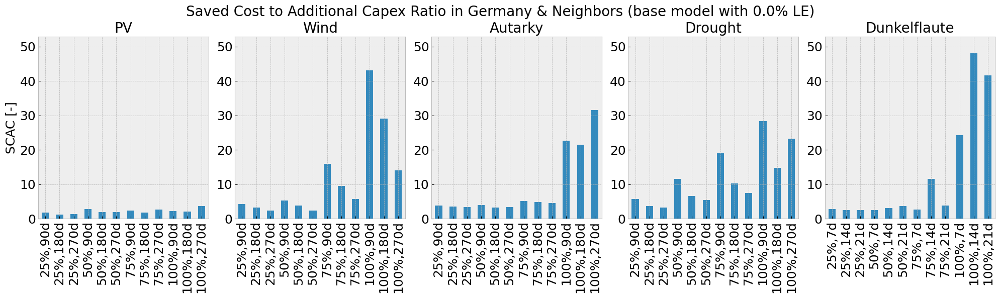

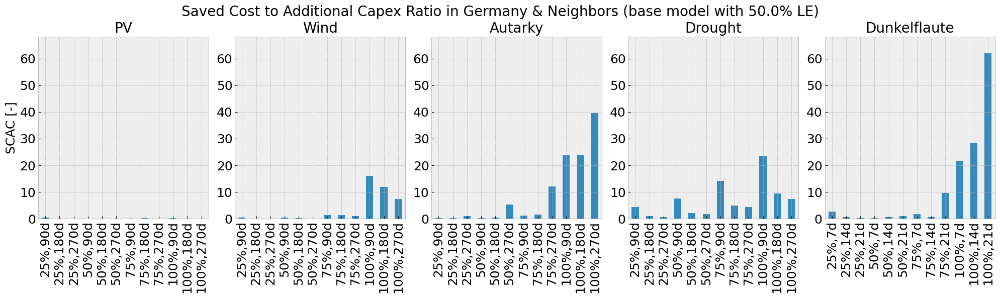

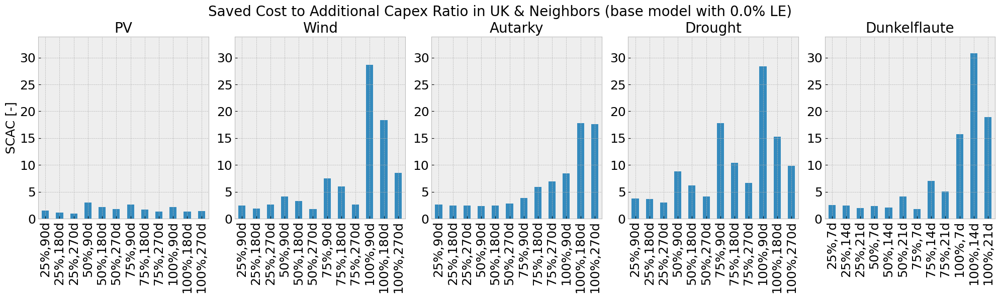

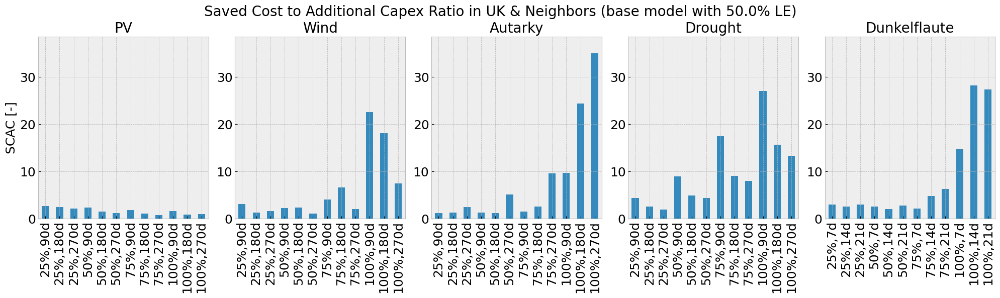

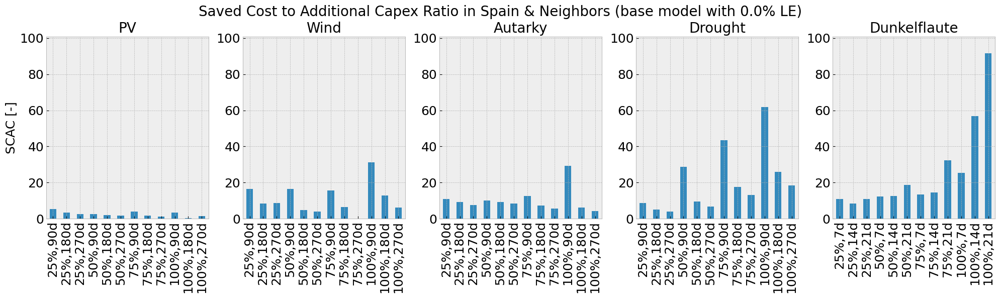

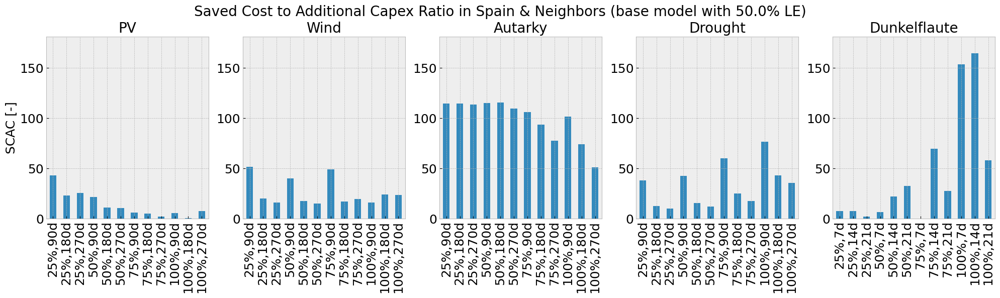

In [41]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1


for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy= 0
        maxx = 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 6))

        all_handles = []
        all_labels = []

        for contingency_el,ax in contingencies_el.items():

            #add ylabel
            ax_count = ax
            ax = axes[ax]
            if ax_count == 0:
                ax.set_ylabel('SCAC [-]', size =18) #saved cost to additional capex ratio
            
            
            
            ax.set_title(f'{contingency_el}', fontsize = 16)


            globals()[f'scac_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = globals()[f'net_saved_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['SC']/globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['add_capex']

            globals()[f'scac_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].plot(kind = 'bar', ax=ax, legend = False)
            
            if globals()[f'scac_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max() > maxy:
                maxy = globals()[f'scac_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].max()

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)
            
            y_dist = ((globals()[f'scac_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']).max()/5)
            #print(maxy,maxx)
            
            #ax.tick_params(axis='x', labelsize=12)
            #ax.set_yticks([0, 1*y_dist, 2*y_dist, 3*y_dist, 4*y_dist, 5*y_dist])

            # Collect handles and labels
            handles,_= ax.get_legend_handles_labels()
            labels = [f"{col} days" for col in globals()[f'net_saved_sum{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].columns]
            #ax.legend(handles, labels, fontsize = 16)#, loc='center left', bbox_to_anchor=(-0.95, 1)
             # Add text above bars

        for contingency_el,ax in contingencies_el.items():
            #add ylabel
            ax_count = ax
            ax = axes[ax]

            ax.tick_params(axis='x', labelsize=18)
            ax.tick_params(axis='y', labelsize=18)
            ax.set_ylim([0,maxy*1.1])
         
        
        
        plt.tight_layout(rect=[0, 0, 1, 0.95])

        if country == 'DE':
            plt.suptitle(f'Saved Cost to Additional Capex Ratio in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Saved Cost to Additional Capex Ratio in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Saved Cost to Additional Capex Ratio in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        
        #fig.text(0.5, 0.04, 'Additional Capex [€Bill/a]', ha='center', va='center', fontsize = 18)

        #plt.set_title('')
        # Save plot to the current working directory
        filename = f"scac_{country}_{line}_roll.png"
        output_path = os.path.join(os.getcwd(), filename)
        plt.savefig(output_path)

        plt.show()

        

# Create a legend for the colors

### Additional capex components

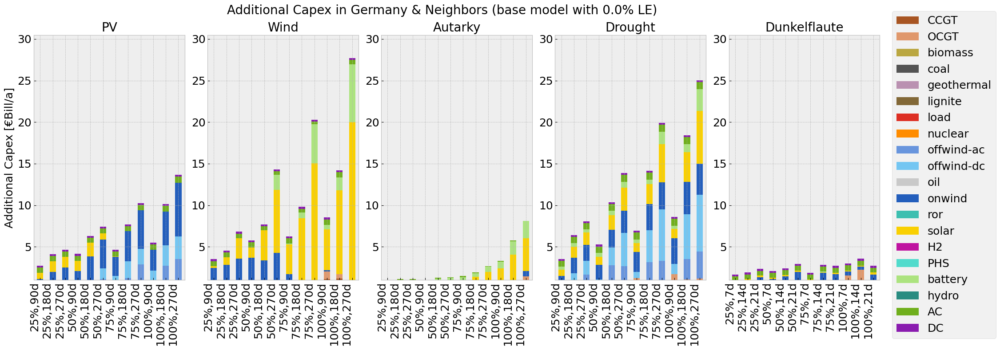

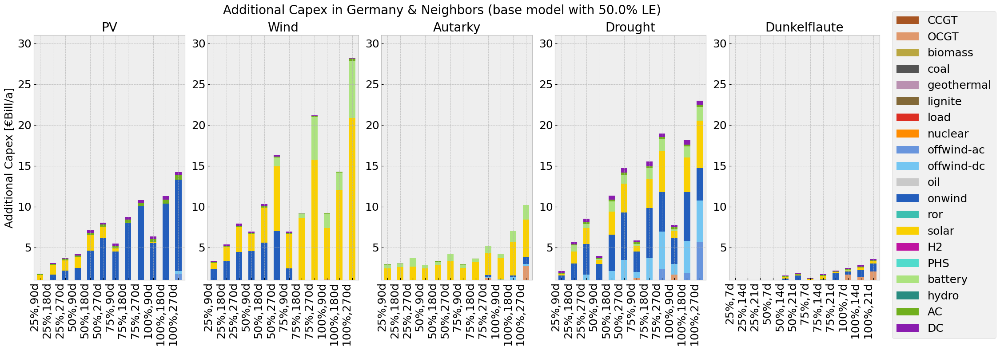

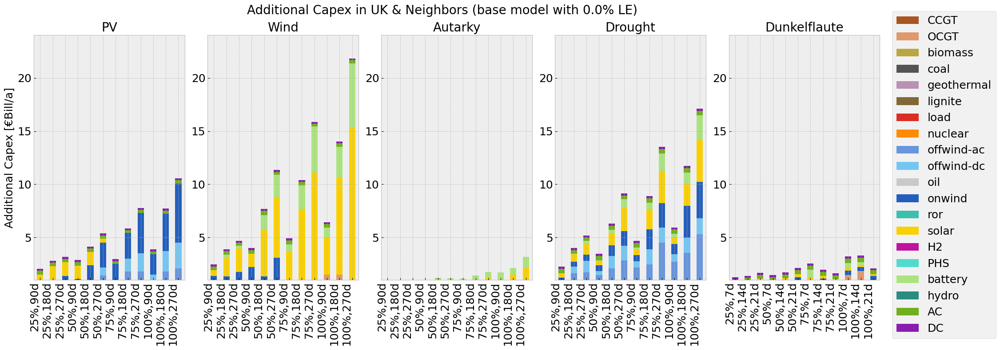

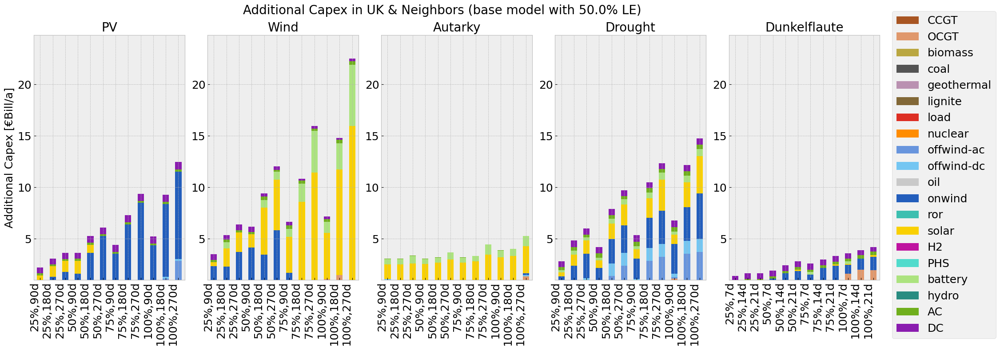

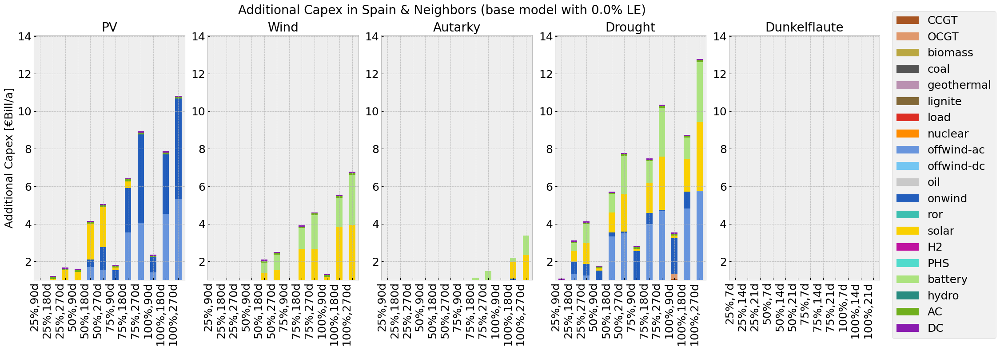

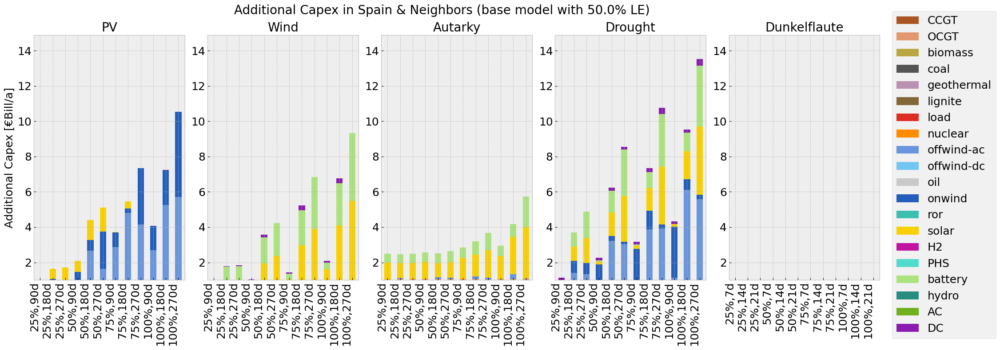

In [42]:
# Define a dictionary to map each element to a specific subplot
element_to_ax = {}
for line in lines:
    element_to_ax[line] = {}
    index = 0  # Reset index for each line
    for contingency in contingencies.keys():
        element_to_ax[line][contingency] = index
        index += 1

for country in countries.keys():
    

    for line, contingencies_el in element_to_ax.items():

        maxy = 0

        # Plot configuration
        fig, axes = plt.subplots(nrows = 1, ncols=len(contingencies.keys()), figsize=(20, 8))
        #print(country)

        all_handles = []
        all_labels = []
        
        #create df and insert column base
        base_capex = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_base_solved']
        
        globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}'] = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].sum(axis=1)

        for contingency_el,ax in contingencies_el.items():

            globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'] = pd.DataFrame(columns = globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].columns, 
                                                                                                                  index = globals()[f'cap_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_df'].index)
            

            for reductionto in contingencies[contingency_el]['reductionto']:

                san_reductionto = sanitize_variable_name(str(reductionto)) 

                for duration in contingencies[contingency_el]['duration']:

                    index = f'{int(-(reductionto-1)*100)}%,{duration}d'
                    index_inv = f'inv {int(-(reductionto-1)*100)}%,{duration}d'
                    index_noinv = f'noinv {int(-(reductionto-1)*100)}%,{duration}d'

                    globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].loc[index] = (globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].loc[index_inv]-globals()[f'capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}_tot_df'].loc[index_noinv])

            globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add capex'] = globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].sum(axis = 1)

            if globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add capex'].max() > maxy:
                maxy = globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}']['total add capex'].max()

        for contingency_el,ax in contingencies_el.items():
            #add ylabel
            ax_count = ax
            ax = axes[ax]
            if ax_count == 0:
                ax.set_ylabel('Additional Capex [€Bill/a]', size =18)
            
            ax.set_title(f'{contingency_el}', fontsize = 16)
            ax.set_ylim([1,maxy*1.1])
            
            globals()[f'add_capex_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].iloc[1:,:-1].plot(kind='bar', stacked=True, ax =ax, legend =False, color = color_map)
            #net_saved_cost = globals()[f'net_saved_{country}_{sanitize_variable_name(str(line))}_{contingency_el}'].iloc[1:,-1].plot(kind='line', ax =ax,color = 'k', marker = 'o')

            # Rotate xticks for better readability
            ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha='right')
            
            #set font size
            ax.tick_params(axis='x', labelsize=18)
            ax.tick_params(axis='y', labelsize=18)

            if contingency_el == 'pv':
                ax.set_title('PV', fontsize=20)
            elif contingency_el == 'wind':
                ax.set_title('Wind', fontsize=20)
            elif contingency_el == 'drought':
                ax.set_title('Drought', fontsize=20)
            elif contingency_el == 'noexim':
                ax.set_title('Autarky', fontsize=20)
            elif contingency_el == 'windpv':
                ax.set_title('Dunkelflaute', fontsize=20)

        plt.tight_layout(rect=[0, 0, 1, 0.95])  # Leave space for the suptitle

        # Collect handles and labels
        handles, labels = ax.get_legend_handles_labels()
        all_handles.extend(handles)
        all_labels.extend(labels)

        # Create a single legend for the whole figure
        by_label = dict(zip(all_labels, all_handles))
        fig.legend(by_label.values(), by_label.keys(), loc='center left', bbox_to_anchor=(1, 0.5), prop={'size':18})

        
    
        if country == 'DE':
            plt.suptitle(f'Additional Capex in Germany & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'GB':
            plt.suptitle(f'Additional Capex in UK & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)
        elif country == 'ES':
            plt.suptitle(f'Additional Capex in Spain & Neighbors (base model with {str((line-1)*100)}% LE)', fontsize = 20)

        #plt.set_title('')
        # Save plot to the current working directory
        filename = f"add_capex_{country}_{line}.png"
        output_path = os.path.join(os.getcwd(), filename)
        plt.savefig(output_path, bbox_inches='tight')

        plt.show()